In [2]:
import sys
import io
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf

from glob import glob
from tensorflow import keras
from keras.applications import ResNet101
from keras.layers import Conv2D, Conv1D, BatchNormalization, Activation, UpSampling2D, AveragePooling2D, Concatenate, Input, Softmax, ReLU, Embedding, TextVectorization
from keras.models import Model
from tensorflow import linalg
import tensorboard
from keras.optimizers import SGD
import segmentation_models as sm
from tqdm.notebook import tqdm
from sklearn.metrics import f1_score, jaccard_score
import math
import shutil

C:\Users\SamuelMcmurray\.conda\envs\tf\lib\site-packages\requests\__init__.py:109: RequestsDependencyWarning: urllib3 (1.26.15) or chardet (None)/charset_normalizer (3.1.0) doesn't match a supported version!
  warnings.warn(


Segmentation Models: using `keras` framework.


In [3]:
physical_devices = tf.config.experimental.list_physical_devices('GPU')
print("Num GPUs Available: ", len(physical_devices))
tf.config.experimental.set_memory_growth(physical_devices[0], True)

Num GPUs Available:  1


In [46]:
globals()['IMAGE_DIR'] = r"C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\pascal\VOC2012_train_val\VOC2012_train_val\JPEGImages\*"
globals()['MASK_DIR'] = r"C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\pascal\VOC2012_train_val\VOC2012_train_val\SegmentationClass\*"

In [47]:
# mask_train_destination = r'C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\masks\masks'
# mask_other_destination = r'C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\masks\other'
# image_train_destination = r'C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\images\images'
# image_other_destination = r'C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\images\other'
# images = sorted(glob(IMAGE_DIR))
# masks = sorted(glob(MASK_DIR))
# list = pd.read_csv('pascal/VOC2012_train_val/VOC2012_train_val/ImageSets/Segmentation/trainval.txt').to_numpy().flatten().tolist()
# for image in images:
#     image_end = image.split("\\")[-1].split(".")[0]
#     if image_end in list:
#         shutil.move(image, image_train_destination)
#     else:
#         shutil.move(image, image_other_destination)

In [48]:
# for mask in masks:
#     mask_end = mask.split("\\")[-1].split(".")[0]
#     if mask_end in list:
#         shutil.move(mask, mask_train_destination)
#     else:
#         shutil.move(mask, mask_other_destination)

In [80]:
result_image_dir = r'C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\result\resnet'
image_directory = r"C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\images\images\*"
images = sorted(glob(image_directory))
for image in images:
    print(image)
    image_end = image.split("\\")[-1].split(".")[-1]
    print(image_end)
    if image_end == 'png':
        shutil.move(image, result_image_dir)
        #os.remove(image)

C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\images\images\2007_000033.jpg
jpg
C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\images\images\2007_000039.jpg
jpg
C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\images\images\2007_000042.jpg
jpg
C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\images\images\2007_000061.jpg
jpg
C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\images\images\2007_000063.jpg
jpg
C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\images\images\2007_000068.jpg
jpg
C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\images\images\2007_000121.jpg
jpg
C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\images\images\2007_000123.jpg
jpg


In [5]:
globals()['IMAGE_DIR'] = r"C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\images"
globals()['MASK_DIR'] = r"C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\masks"
globals()['IMAGE_SIZE'] = 128
globals()['BATCH_SIZE'] = 6
globals()['NUM_CLASSES'] = 21

train_images = sorted(glob(os.path.join(IMAGE_DIR, "images/*")))[:2328] #80
train_masks = sorted(glob(os.path.join(MASK_DIR, "masks/*")))[:2328] #80
val_images = sorted(glob(os.path.join(IMAGE_DIR, "images/*")))[2328:]   #20
val_masks = sorted(glob(os.path.join(MASK_DIR, "masks/*")))[2328:]  #20

In [51]:
all_dict = {
    'stuff': 'stuff',
    'indoor': 'stuff',
    'outdoor': 'stuff',
    'rawmaterial': 'indoor',
    'wall': 'indoor',
    'ceiling': 'indoor',
    'floor': 'indoor',
    'window': 'indoor',
    'furniture': 'indoor',
    'textile': 'indoor',
    'food': 'indoor',
    'building': 'outdoor',
    'structural': 'outdoor',
    'plant': 'outdoor',
    'sky': 'outdoor',
    'solid': 'outdoor',
    'ground': 'outdoor',
    'water': 'outdoor',
    'cardboard': 'rawmaterial',
    'paper': 'rawmaterial',
    'plastic': 'rawmaterial',
    'metal': 'rawmaterial',
    'wall-tile': 'wall',
    'wall-panel': 'wall',
    'wall-wood': 'wall',
    'wall-brick': 'wall',
    'wall-stone': 'wall',
    'wall-concrete': 'wall',
    'wall-other': 'wall',
    'ceiling-tile': 'ceiling',
    'ceiling-other': 'ceiling',
    'carpet': 'floor',
    'floor-tile': 'floor',
    'floor-wood': 'floor',
    'floor-marble': 'floor',
    'floor-stone': 'floor',
    'floor-other': 'floor',
    'window-blind': 'window',
    'window-other': 'window',
    'door': 'furniture',
    'desk': 'furniture',
    'table': 'furniture',
    'shelf': 'furniture',
    'cabinet': 'furniture',
    'cupboard': 'furniture',
    'mirror': 'furniture',
    'counter': 'furniture',
    'light': 'furniture',
    'stairs': 'furniture',
    'furniture-other': 'furniture',
    'rug': 'textile',
    'mat': 'textile',
    'towel': 'textile',
    'napkin': 'textile',
    'clothes': 'textile',
    'cloth': 'textile',
    'curtain': 'textile',
    'blanket': 'textile',
    'pillow': 'textile',
    'banner': 'textile',
    'textile-other': 'textile',
    'fruit': 'food',
    'salad': 'food',
    'vegetable': 'food',
    'food-other': 'food',
    'house': 'building',
    'skyscraper': 'building',
    'bridge': 'building',
    'tent': 'building',
    'roof': 'building',
    'building-other': 'building',
    'fence': 'structural',
    'cage': 'structural',
    'net': 'structural',
    'railing': 'structural',
    'structural-other': 'structural',
    'grass': 'plant',
    'tree': 'plant',
    'bush': 'plant',
    'leaves': 'plant',
    'flower': 'plant',
    'branch': 'plant',
    'moss': 'plant',
    'straw': 'plant',
    'plant-other': 'plant',
    'clouds': 'sky',
    'sky-other': 'sky',
    'wood': 'solid',
    'rock': 'solid',
    'stone': 'solid',
    'mountain': 'solid',
    'hill': 'solid',
    'solid-other': 'solid',
    'sand': 'ground',
    'snow': 'ground',
    'dirt': 'ground',
    'mud': 'ground',
    'gravel': 'ground',
    'road': 'ground',
    'pavement': 'ground',
    'railroad': 'ground',
    'platform': 'ground',
    'playingfield': 'ground',
    'ground-other': 'ground',
    'fog': 'water',
    'river': 'water',
    'sea': 'water',
    'waterdrops': 'water',
    'water-other': 'water',
    'things': 'things',
    'indoor': 'things',
    'outdoor': 'things',
    'person': 'outdoor',
    'vehicle': 'outdoor',
    'outdoor': 'outdoor',
    'animal': 'outdoor',
    'accessory': 'outdoor',
    'sports': 'outdoor',
    'kitchen': 'indoor',
    'food': 'indoor',
    'furniture': 'indoor',
    'electronic': 'indoor',
    'appliance': 'indoor',
    'indoor': 'indoor',
    'person': 'person',
    'bicycle': 'vehicle',
    'car': 'vehicle',
    'motorcycle': 'vehicle',
    'airplane': 'vehicle',
    'bus': 'vehicle',
    'train': 'vehicle',
    'truck': 'vehicle',
    'boat': 'vehicle',
    'traffic light': 'outdoor',
    'fire hydrant': 'outdoor',
    'street sign': 'outdoor',
    'stop sign': 'outdoor',
    'parking meter': 'outdoor',
    'bench': 'outdoor',
    'bird': 'animal',
    'cat': 'animal',
    'dog': 'animal',
    'horse': 'animal',
    'sheep': 'animal',
    'cow': 'animal',
    'elephant': 'animal',
    'bear': 'animal',
    'zebra': 'animal',
    'giraffe': 'animal',
    'hat': 'accessory',
    'backpack': 'accessory',
    'umbrella': 'accessory',
    'shoe': 'accessory',
    'eye glasses': 'accessory',
    'handbag': 'accessory',
    'tie': 'accessory',
    'suitcase': 'accessory',
    'frisbee': 'sports',
    'skis': 'sports',
    'snowboard': 'sports',
    'sports ball': 'sports',
    'kite': 'sports',
    'baseball bat': 'sports',
    'baseball glove': 'sports',
    'skateboard': 'sports',
    'surfboard': 'sports',
    'tennis racket': 'sports',
    'bottle': 'kitchen',
    'plate': 'kitchen',
    'wine glass': 'kitchen',
    'cup': 'kitchen',
    'fork': 'kitchen',
    'knife': 'kitchen',
    'spoon': 'kitchen',
    'bowl': 'kitchen',
    'banana': 'food',
    'apple': 'food',
    'sandwich': 'food',
    'orange': 'food',
    'broccoli': 'food',
    'carrot': 'food',
    'hot dog': 'food',
    'pizza': 'food',
    'donut': 'food',
    'cake': 'food',
    'chair': 'furniture',
    'couch': 'furniture',
    'potted plant': 'furniture',
    'bed': 'furniture',
    'mirror': 'furniture',
    'dining table': 'furniture',
    'window': 'furniture',
    'desk': 'furniture',
    'toilet': 'furniture',
    'door': 'furniture',
    'tv': 'electronic',
    'laptop': 'electronic',
    'mouse': 'electronic',
    'remote': 'electronic',
    'keyboard': 'electronic',
    'cell phone': 'electronic',
    'microwave': 'appliance',
    'oven': 'appliance',
    'toaster': 'appliance',
    'sink': 'appliance',
    'refrigerator': 'appliance',
    'blender': 'appliance',
    'book': 'indoor',
    'clock': 'indoor',
    'vase': 'indoor',
    'scissors': 'indoor',
    'teddy bear': 'indoor',
    'hair drier': 'indoor',
    'toothbrush': 'indoor',
    'hair brush': 'indoor',
}

In [19]:
label_color_map = [
    ['background', 0, 0, 0],  # background!
    ['boat', 128, 0, 0], # boat!
    ['bicycle', 0, 128, 0], # bicycle!
    ['bus', 128, 128, 0], # bus!
    ['aeroplane', 0, 0, 128], # aeroplaane!
    ['bottle', 128, 0, 128], # bottle!
    ['bird',0, 128, 128], # bus!
    ['car', 128, 128, 128], # car!
    ['cat', 0, 0, 64], # cat!
    ['cow', 0, 128, 64], # cow!
    ['horse', 128, 0, 192], # horse!
    ['motorbike',128, 128, 64], # motorbike!
    ['person', 128, 128, 192], # person !
    ['pottedplant', 0, 64, 0], # potted plant
    ['tv\monitor', 128, 64, 0], #tv!
    ['sofa', 0, 192, 0], # sofa!
    ['sheep', 0, 64, 128],# sheep !
    ['train', 0, 192, 128,], #train!
    ['chair',  0,   0, 192], #chair!
    ['dog', 128,   0,  64 ], #dog!
    ['diningtable', 0, 128, 192]
]

In [20]:
classes = []
color_map = []
for label_color in label_color_map:
    classes.append(label_color[0])
    color_map.append([label_color[1], label_color[2], label_color[3]])
print(classes)
print(color_map)
print(len(classes))

['background', 'boat', 'bicycle', 'bus', 'aeroplane', 'bottle', 'bird', 'car', 'cat', 'cow', 'horse', 'motorbike', 'person', 'pottedplant', 'tv\\monitor', 'sofa', 'sheep', 'train', 'chair', 'dog', 'diningtable']
[[0, 0, 0], [128, 0, 0], [0, 128, 0], [128, 128, 0], [0, 0, 128], [128, 0, 128], [0, 128, 128], [128, 128, 128], [0, 0, 64], [0, 128, 64], [128, 0, 192], [128, 128, 64], [128, 128, 192], [0, 64, 0], [128, 64, 0], [0, 192, 0], [0, 64, 128], [0, 192, 128], [0, 0, 192], [128, 0, 64], [0, 128, 192]]
21


In [6]:
def read_image(x):
    x = cv2.imread(x, cv2.IMREAD_COLOR)
    x = cv2.resize(x, (IMAGE_SIZE, IMAGE_SIZE))
    x = x/255.0
    x = x.astype(np.float32)

    return x

In [7]:
def read_mask(x):
    x = cv2.imread(x, cv2.IMREAD_COLOR)
    x = cv2.resize(x, (IMAGE_SIZE, IMAGE_SIZE))

    # path = r'C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\testmask'
    # save_image_path = os.path.join(path, "original.jpg")
    # cv2.imwrite(save_image_path, x)
    # np.set_printoptions(threshold=sys.maxsize)
    # print(x)
    output = []
    for i, color in enumerate(color_map):
        c_map = np.all(np.equal(x,color), axis=-1)
        # if True in c_map:
        #     print(classes[i])
        output.append(c_map)
        # save_image_path = os.path.join(path, f"{i}.png")
        # cv2.imwrite(save_image_path, c_map * 255)

    output = np.stack(output, axis=-1)
    output = output.astype(np.uint8)

    return output

In [8]:
def preprocess(x,y):
    def f(x,y):
        x = x.decode()
        y = y.decode()

        x = read_image(x)
        y = read_mask(y)

        return x, y

    image, mask = tf.numpy_function(f, [x,y], [tf.float32, tf.uint8])
    image.set_shape([IMAGE_SIZE, IMAGE_SIZE, 3])
    mask.set_shape([IMAGE_SIZE, IMAGE_SIZE, NUM_CLASSES])
    return image, mask

In [9]:
def data_generator(image_list, mask_list, training=True):
    dataset = tf.data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.shuffle(buffer_size=5000)
    dataset = dataset.map(preprocess, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    dataset = dataset.prefetch(2)
    return dataset

In [10]:
train_dataset = data_generator(train_images, train_masks)
val_dataset = data_generator(val_images, val_masks, False)

In [11]:
print("Train Dataset:", train_dataset)
print("Val Dataset:", val_dataset)

Train Dataset: <PrefetchDataset element_spec=(TensorSpec(shape=(6, 128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(6, 128, 128, 21), dtype=tf.uint8, name=None))>
Val Dataset: <PrefetchDataset element_spec=(TensorSpec(shape=(6, 128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(6, 128, 128, 21), dtype=tf.uint8, name=None))>


In [60]:
result = read_mask(train_masks[39])

In [61]:
def get_keys_as_list(dictionary):
    return list(map(lambda x: x[0], dictionary.items()))

In [62]:
def build_adjacency_matrix(connection_dict, directed=True):
    # Connection is from  row TO collumn.
    new_all = np.unique(get_keys_as_list(connection_dict)) # Assumption! See text above
    M = len(new_all)

    word2idx = {word:i for (i,word) in enumerate(new_all)}
    idx2word = {i:word for (i,word) in enumerate(new_all)}
    adj_m = np.zeros((M,M))
    for leaf in connection_dict.keys():
        parent = connection_dict[leaf]

        adj_m[word2idx[parent],word2idx[leaf]] = 1 # Adds connection from parent to child
        if not directed:
            adj_m[word2idx[leaf],word2idx[parent]] = 1 # Adds connection back from child to parent

    return  adj_m, word2idx, idx2word, new_all

In [63]:
def ASPP(inputs):
    shape = inputs.shape
    y_pool = AveragePooling2D(pool_size=(shape[1], shape[2]))(inputs)
    y_pool = Conv2D(filters=256, kernel_size=1, padding='same', use_bias=False)(y_pool)
    y_pool = BatchNormalization()(y_pool)
    y_pool = Activation('relu')(y_pool)
    y_pool = UpSampling2D((shape[1], shape[2]), interpolation='bilinear')(y_pool)

    y_6 = Conv2D(filters=256, kernel_size=1, dilation_rate=6, padding='same', use_bias=False)(inputs)
    y_6 = BatchNormalization()(y_6)
    y_6 = Activation('relu')(y_6)

    y_12 = Conv2D(filters=256, kernel_size=1, dilation_rate=12, padding='same', use_bias=False)(inputs)
    y_12 = BatchNormalization()(y_12)
    y_12 = Activation('relu')(y_12)

    y_18 = Conv2D(filters=256, kernel_size=1, dilation_rate=18, padding='same', use_bias=False)(inputs)
    y_18 = BatchNormalization()(y_18)
    y_18 = Activation('relu')(y_18)

    y_24 = Conv2D(filters=256, kernel_size=1, dilation_rate=24, padding='same', use_bias=False)(inputs)
    y_24 = BatchNormalization()(y_24)
    y_24 = Activation('relu')(y_24)

    y = Concatenate()([y_pool, y_6, y_12, y_18, y_24])

    y = Conv2D(filters=256, kernel_size=1, dilation_rate=1, padding='same', use_bias=False)(y)
    y = BatchNormalization()(y)
    y = Activation('relu')(y)

    return y


In [64]:
def SGRModel(input_shape):
    inputs = Input(input_shape)
    base_model = ResNet101(weights='resnet101_weights_tf_dim_ordering_tf_kernels_notop.h5', include_top=False, input_tensor=inputs)
    image_features = base_model.get_layer('conv5_block3_out').output

    x_a = ASPP(image_features)
    x_b = UpSampling2D((4,4), interpolation='bilinear')(x_a)
    x_b = Conv2D(filters=256, kernel_size=1, padding='same', use_bias=False)(x_b)
    x_b = BatchNormalization()(x_b)
    x_b = Activation('relu')(x_b)

    x_b = UpSampling2D((4,4), interpolation='bilinear')(x_b)
    x_b = Conv2D(filters=256, kernel_size=1, padding='same', use_bias=False)(x_b)
    x_b = BatchNormalization()(x_b)
    x_b = Activation('relu')(x_b)

    x_b = VotingToSemantic()(x_a)
    x_b = GraphReasoning()(x_b)
    x_b= SemanticToLocal()(x_a, x_b)

    x_b = UpSampling2D((8,8), interpolation='bilinear')(x_b)
    x_b = Conv2D(filters=256, kernel_size=1, padding='same', use_bias=False)(x_b)
    x_b = BatchNormalization()(x_b)
    x_b = Activation('relu')(x_b)

    x_b = UpSampling2D((4,4), interpolation='bilinear')(x_b)
    x_b = Conv2D(filters=256, kernel_size=1, padding='same', use_bias=False)(x_b)
    x_b = BatchNormalization()(x_b)
    x_b = Activation('relu')(x_b)

    outputs = Conv2D(NUM_CLASSES, (1,1), activation="softmax")(x_b)

    return Model(inputs=inputs, outputs=outputs)

In [65]:
class VotingToSemantic(tf.Module):
    def __init__(self, name="voting"):
        super().__init__(name)
        self.M = 204
        self.Dc = 256
        with self.name_scope:
            self.conv1 = Conv2D(filters=self.M, kernel_size=1, padding='same', use_bias=False, name="voting_convolution")
            self.conv2 = Conv2D(filters=self.Dc, kernel_size=1, padding='same', use_bias=False, name="feature_convolution")
            self.softmax = Softmax(axis=-1, name="voting_softmax_target")
            self.relu = ReLU(name='visual_feat')
    @tf.Module.with_name_scope
    def __call__(self, x, *args, **kwargs):
        with tf.name_scope('handle_voting'):
            inputs_shape = x.shape

            # will have shape [?,H,W,M]
            votes = self.conv1(x)
            votes = self.softmax(votes)
            # shape [?,H,W,M]

            votes = tf.reshape(votes, [tf.shape(x)[0], inputs_shape[1] * inputs_shape[2], self.M], name='voting_reshape')
            # shape [?,H*W,M]
            votes = tf.transpose(votes, [0, 2, 1])  # shape [?,M, H*W]

        with tf.name_scope('assign_votes'):
            in_feat = self.conv2(x)
            # shape [H*W,Dc]
            in_feat = tf.reshape(in_feat, [tf.shape(x)[0], inputs_shape[1] * inputs_shape[2], self.Dc], name='assign_votes_reshape') # shape [?,H*W,Dc]
            in_feat = tf.matmul(votes, in_feat, name='applied_votes')  # shape [?,M,Dc]
            visual_features = self.relu(in_feat)  # shape [?,M,Dc]

        return visual_features


In [66]:
class GraphReasoning(tf.Module):
    def __init__(self, name="voting"):
        super().__init__(name)
        self.M = 204
        self.Dc = 256
        self.K = 100
        with self.name_scope:
            self.conv1 = Conv1D(filters=self.Dc, kernel_size=1, activation='linear', name="graph_convolution")
            self.concat = Concatenate(axis=-1, name='concat_embed')
            self.fasttext = Embedding(self.M + 1, self.K, name="embedding")
            self.softmax = Softmax(axis=-1, name="voting_softmax_target")
            self.relu = ReLU(name='evolved_feat')

    def norm_adjacency(self, adjacency_matrix):
        a = adjacency_matrix  # MxM
        assert a.shape[0] == a.shape[1], 'adjacency matrix should be symmetirc'
        a += np.identity(a.shape[0])  # add identity connections
        tf_adj = tf.constant(a, dtype=tf.float32)
        norm_adj = self.row_normalize(tf_adj)
        return norm_adj


    def row_normalize(self, mat):
        Q = tf.reduce_sum(mat, axis=-1)
        Q = tf.cast(Q, tf.float32)
        sQ = tf.math.rsqrt(Q)
        sQ = linalg.diag(sQ)
        return linalg.matmul(sQ, linalg.matmul(mat, sQ, name='right_side_norm'), name='left_side_norm')


    @tf.Module.with_name_scope
    def __call__(self, x, *args, **kwargs):
        with tf.name_scope('reasoning'):
            inputs_shape = x.shape
            adjacency_matrix, word_to_index, index_to_word, all_words = build_adjacency_matrix(all_dict)

            vocab_size = self.M + 2 # 2 extra variables
            vectorize_layer = TextVectorization(
                max_tokens=vocab_size,
                output_mode='int',
                vocabulary=all_words,
                output_sequence_length=1,
            )
            vectorize_layer.trainable = False
            vectorized_words = vectorize_layer(all_words)
            vectorized_words = tf.transpose(vectorized_words)

            fasttext_embeddings = self.fasttext(vectorized_words)
            fasttext_embeddings = tf.tile(fasttext_embeddings, [tf.shape(x)[0], 1, 1])

            concat_feat = self.concat([fasttext_embeddings, x])  # shape [b,M,Dc+K]


            with tf.name_scope('encode_concat'):
                # shape [b*M,Dc+K]
                concat_feat = tf.reshape(concat_feat, [tf.shape(x)[0], self.M, self.Dc + self.K], name="encode_concat_reshape")
                Wg = self.conv1(concat_feat)

            # norm_adj has shape MxM
            with tf.name_scope('graph_convolution'):
                norm_adj = self.norm_adjacency(adjacency_matrix)
                norm_adj = tf.expand_dims(norm_adj, axis=0)

                expanded_norm_adj = tf.tile(norm_adj,[tf.shape(x)[0],1,1])

                evolved_feat = tf.linalg.matmul(expanded_norm_adj, Wg,name='matmul_adj_feat') # [b,M,Dc]

            evolved_feat = self.relu(evolved_feat)  # shape [b,M,Dc]

        return evolved_feat

In [67]:
class SemanticToLocal(tf.Module):
    def __init__(self, name="voting"):
        super().__init__(name)
        self.M = 204
        self.Dc = 256
        self.Dl = 256
        with self.name_scope:
            self.conv1 = Conv1D(filters=self.Dl, kernel_size=1, padding='same', use_bias=False, name="Wsp")
            self.conv2 = Conv2D(filters=1, kernel_size=(1,1), padding='same', use_bias=False, name="Ws")
            self.concat = Concatenate(axis=-1,name='concat_inp')
            self.softmax = Softmax(axis=-1, name="voting_softmax_target")
            self.relu = ReLU(name='applied_mapping')

    def compute_compat_batches(self, input_feats ,evolved_feats):
        if input_feats.shape[0] is None:
            x = input_feats

            input_feats = tf.reshape(input_feats, [tf.shape(x)[0],tf.shape(x)[1] * tf.shape(x)[2], self.Dl], name="mapping_calc_reshape") # [H*W,Dl]
            input_feats = tf.tile(tf.expand_dims(input_feats,2),[1,1,self.M,1]) # [H*W,M,Dl]

            evolved_feats = tf.expand_dims(evolved_feats, 1)
            evolved_feats = tf.tile(evolved_feats,[1, tf.shape(x)[1]*tf.shape(x)[2],1,1]) # [H*W,M,Dc]

            concatenated = self.concat([evolved_feats, input_feats])
            concatenated = self.conv2(concatenated)
            return concatenated

        input_feats_stack = []
        for batch in input_feats:
            sh = tf.shape(batch)
            batch = tf.reshape(batch,[sh[0]*sh[1],sh[2]]) # shape [H*W,Dl]
            batch = tf.expand_dims(batch,0)
            batch = tf.tile(batch,[1,self.M,1]) # has shape [H*W,M,Dl]

            input_feats_stack.append(batch)
        input_feats = tf.stack(input_feats_stack, axis=0)

        evolved_feats_stack = []
        for batch in evolved_feats:
            sh = tf.shape(batch)
            batch = tf.expand_dims(batch,0)
            batch = tf.tile(batch,[sh[0]*sh[1],1,1]) # sh [H*W,M,Dc]
            evolved_feats_stack.append(batch)
        evolved_feats = tf.stack(evolved_feats_stack, axis=0)

        concatenated = self.concat([evolved_feats, input_feats])# (H*WxMx(Dc+Dl))
        concatenated = self.conv2(concatenated) # has shape (H*W,M,1)

        return concatenated

    @tf.Module.with_name_scope
    def __call__(self, x_a, x_b, *args, **kwargs):
        inputs_shape_a = x_a.shape
        inputs_shape_b = x_a.shape
        with tf.name_scope('calc_mapping'):
            concatenated = self.compute_compat_batches(x_a, x_b)

            mapping = Softmax(axis=1, name='mapping_softmax')(concatenated)# (b,H*W, M, M)

            with tf.name_scope('row_normalize_mapping'):
                #mapping has shape [b,H*W,M,M]
                mapping = tf.norm(mapping,ord=1,axis=-1) # has shape [b,H*W,M]
                mapping = tf.nn.l2_normalize(mapping,axis=2) # does l2 normalization along the rows.

        with tf.name_scope('apply_mapping'):
            Wsp = self.conv1(x_b)

            applied_mapping = tf.matmul(mapping, Wsp, name='applied_mapping')  # bx(H*W)xDl

            applied_mapping = self.relu(applied_mapping)  # bx(H*W)xDl
            applied_mapping = tf.reshape(applied_mapping, [tf.shape(x_a)[0], inputs_shape_a[1], inputs_shape_a[2], self.Dl],
                                         name='mapped_feat_target')  # b,HxWxDl

        return (x_a + applied_mapping)

In [68]:
model = SGRModel((IMAGE_SIZE,IMAGE_SIZE,3))
num_epochs = 100
optimizer = SGD(learning_rate=2.5e-3)
loss_fn = keras.losses.CategoricalCrossentropy()
acc_metric = keras.metrics.CategoricalCrossentropy()
meanIoU = keras.metrics.MeanIoU(num_classes=NUM_CLASSES, name="MeanIoU")

In [69]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 134, 134, 3)  0           ['input_2[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 64, 64, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 conv1_bn (BatchNormalization)  (None, 64, 64, 64)   256         ['conv1_conv[0][0]']       

In [70]:
keras.utils.plot_model(model, show_shapes=True)

In [71]:
tensorboard_callback = keras.callbacks.TensorBoard(log_dir="tb_callback_dir,", histogram_freq=1)
optimizer = SGD(learning_rate=2.5e-3)
callbacks = [
    keras.callbacks.ModelCheckpoint(filepath='SGR/model{epoch:08d}.h5',
                                    monitor='val_accuracy',
                                    save_best_only=True,
                                    mode='max',
                                    save_freq='epoch'),
]
model.compile(
    optimizer=optimizer,
    loss='categorical_crossentropy',
    metrics=["accuracy", keras.metrics.MeanIoU(num_classes=NUM_CLASSES, name="MeanIoU")],
)
history = model.fit(
    train_dataset,
    epochs=100,
    callbacks=callbacks,
    validation_data=val_dataset,
    verbose=2,

)
model.save("../models/sgr_resnet101.hdf5")

Epoch 1/100
388/388 - 56s - loss: 1.2494 - accuracy: 0.7272 - MeanIoU: 0.4777 - val_loss: 31.5563 - val_accuracy: 0.3621 - val_MeanIoU: 0.4778 - 56s/epoch - 145ms/step
Epoch 2/100
388/388 - 47s - loss: 0.9315 - accuracy: 0.7730 - MeanIoU: 0.4777 - val_loss: 1.9631 - val_accuracy: 0.6928 - val_MeanIoU: 0.4779 - 47s/epoch - 121ms/step
Epoch 3/100
388/388 - 46s - loss: 0.8143 - accuracy: 0.7892 - MeanIoU: 0.4777 - val_loss: 0.9190 - val_accuracy: 0.7596 - val_MeanIoU: 0.4781 - 46s/epoch - 120ms/step
Epoch 4/100
388/388 - 48s - loss: 0.7450 - accuracy: 0.8016 - MeanIoU: 0.4777 - val_loss: 0.8234 - val_accuracy: 0.7687 - val_MeanIoU: 0.4781 - 48s/epoch - 124ms/step
Epoch 5/100
388/388 - 46s - loss: 0.6884 - accuracy: 0.8098 - MeanIoU: 0.4777 - val_loss: 0.7779 - val_accuracy: 0.7750 - val_MeanIoU: 0.4781 - 46s/epoch - 120ms/step
Epoch 6/100
388/388 - 46s - loss: 0.6359 - accuracy: 0.8178 - MeanIoU: 0.4777 - val_loss: 0.7471 - val_accuracy: 0.7770 - val_MeanIoU: 0.4781 - 46s/epoch - 120ms/st

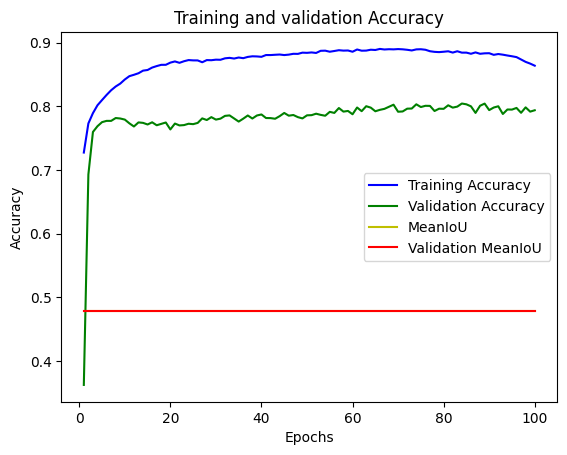

In [72]:
accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']
mean_iou = history.history["MeanIoU"]
val_mean_iou = history.history["val_MeanIoU"]
epochs = range(1, len(accuracy) + 1)
plt.plot(epochs, accuracy, 'b', label='Training Accuracy')
plt.plot(epochs, val_accuracy, 'g', label='Validation Accuracy')
plt.plot(epochs, mean_iou, 'y', label='MeanIoU')
plt.plot(epochs, mean_iou, 'r', label='Validation MeanIoU')
plt.title('Training and validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

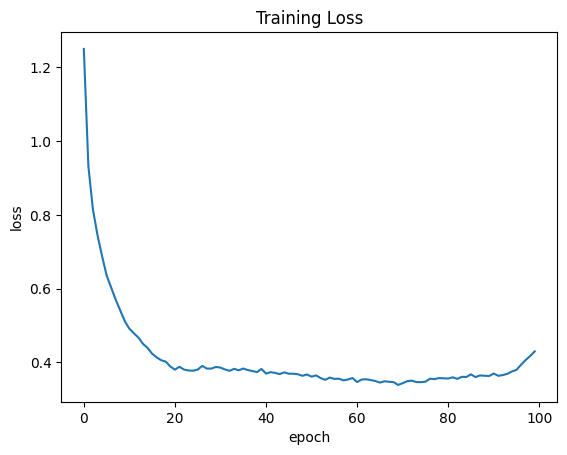

In [73]:
plt.plot(history.history["loss"])
plt.title("Training Loss")
plt.ylabel("loss")
plt.xlabel("epoch")
plt.show()

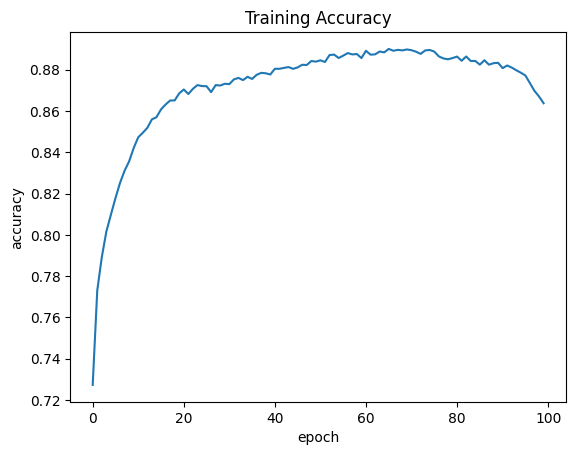

In [74]:
plt.plot(history.history["accuracy"])
plt.title("Training Accuracy")
plt.ylabel("accuracy")
plt.xlabel("epoch")
plt.show()

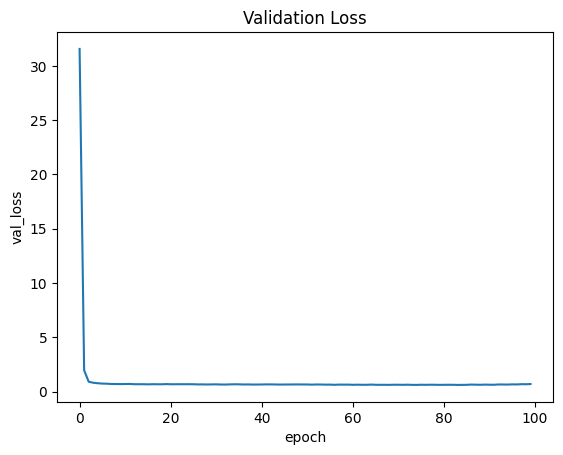

In [75]:
plt.plot(history.history["val_loss"])
plt.title("Validation Loss")
plt.ylabel("val_loss")
plt.xlabel("epoch")
plt.show()

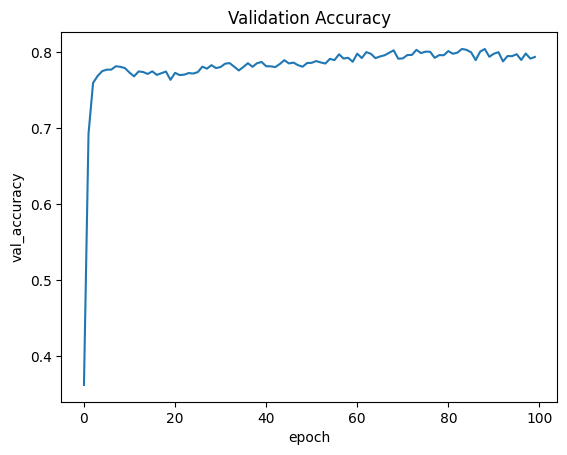

In [76]:
plt.plot(history.history["val_accuracy"])
plt.title("Validation Accuracy")
plt.ylabel("val_accuracy")
plt.xlabel("epoch")
plt.show()

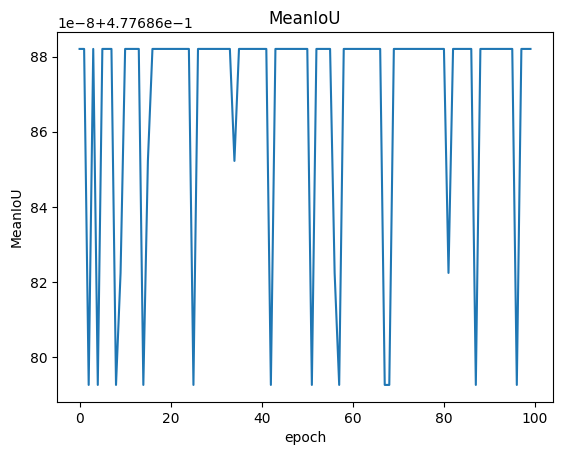

In [77]:
plt.plot(history.history["MeanIoU"])
plt.title("MeanIoU")
plt.ylabel("MeanIoU")
plt.xlabel("epoch")
plt.show()

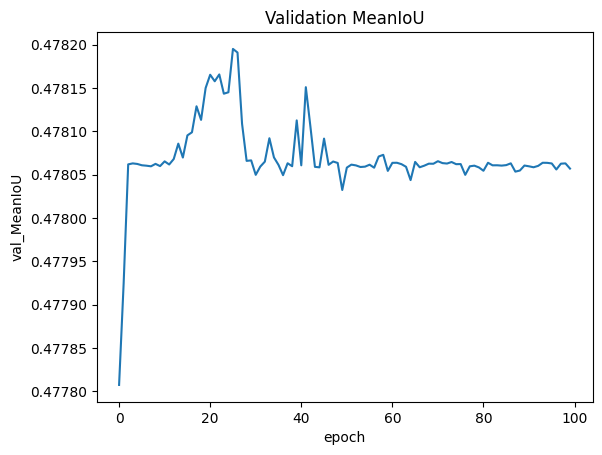

In [78]:
plt.plot(history.history["val_MeanIoU"])
plt.title("Validation MeanIoU")
plt.ylabel("val_MeanIoU")
plt.xlabel("epoch")
plt.show()

In [79]:
resnet = sm.Unet(
    'resnet101',
    encoder_weights='imagenet',
    classes=NUM_CLASSES,
    activation='softmax',
    input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)
)

In [80]:
tensorboard_callback = keras.callbacks.TensorBoard(log_dir="tb_callback_dir,", histogram_freq=1)
metrics=[
    'accuracy',
    keras.metrics.MeanIoU(num_classes=NUM_CLASSES, name="MeanIoU")
]
callbacks = [
    keras.callbacks.ModelCheckpoint(filepath='ResNet/model{epoch:08d}.h5',
                                    monitor='val_accuracy',
                                    save_best_only=True,
                                    mode='max',
                                    save_freq='epoch'),
    tensorboard_callback,
]
resnet.compile(
    optimizer=SGD(learning_rate=2.5e-3),
    loss="categorical_crossentropy",
    metrics=metrics,
)

resnet_history = resnet.fit(
    train_dataset,
    batch_size=BATCH_SIZE,
    epochs=100,
    validation_data=val_dataset,
    callbacks=callbacks
)
model.save("../models/resnet101.hdf5")

Epoch 1/100
388/388 [==============================] - 60s 138ms/step - loss: 1.4773 - accuracy: 0.6888 - MeanIoU: 0.4777 - val_loss: 1.9955 - val_accuracy: 0.7331 - val_MeanIoU: 0.4781
Epoch 2/100
388/388 [==============================] - 52s 133ms/step - loss: 1.1140 - accuracy: 0.7598 - MeanIoU: 0.4777 - val_loss: 1.2892 - val_accuracy: 0.7345 - val_MeanIoU: 0.4781
Epoch 3/100
388/388 [==============================] - 50s 130ms/step - loss: 1.0512 - accuracy: 0.7598 - MeanIoU: 0.4777 - val_loss: 1.1161 - val_accuracy: 0.7336 - val_MeanIoU: 0.4780
Epoch 4/100
388/388 [==============================] - 51s 131ms/step - loss: 0.9979 - accuracy: 0.7598 - MeanIoU: 0.4777 - val_loss: 1.0597 - val_accuracy: 0.7365 - val_MeanIoU: 0.4781
Epoch 5/100
388/388 [==============================] - 51s 132ms/step - loss: 0.9598 - accuracy: 0.7607 - MeanIoU: 0.4777 - val_loss: 1.0176 - val_accuracy: 0.7469 - val_MeanIoU: 0.4781
Epoch 6/100
388/388 [==============================] - 51s 132ms/step 

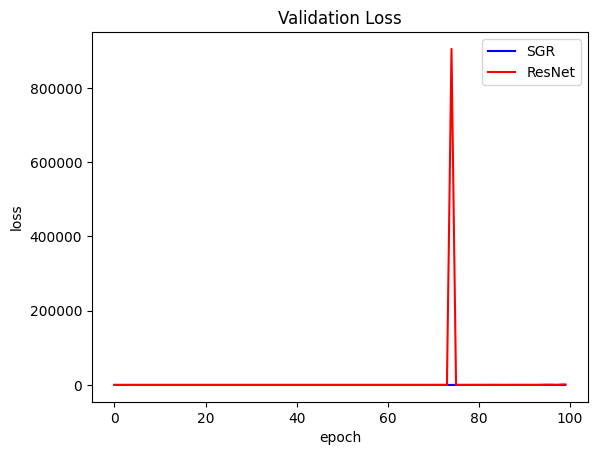

In [84]:
plt.plot(history.history["val_loss"], 'b', label="SGR")
plt.plot(resnet_history.history["val_loss"], "r", label="ResNet")
plt.title("Validation Loss")
plt.ylabel("loss")
plt.xlabel("epoch")
plt.legend()
plt.show()

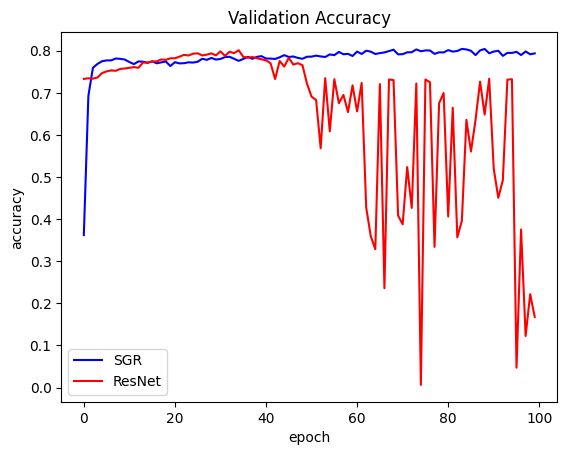

In [82]:
plt.plot(history.history["val_accuracy"], 'b', label="SGR")
plt.plot(resnet_history.history["val_accuracy"], 'r', label="ResNet")
plt.title("Validation Accuracy")
plt.ylabel("accuracy")
plt.xlabel("epoch")
plt.legend()
plt.show()

In [4]:
sgr_model = keras.models.load_model(r'C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\SGR\model00000084.h5')

In [12]:
layer_names = [layer.name for layer in sgr_model.layers[1:]]
layer_outputs = [layer.output for layer in sgr_model.layers[1:]]
print(layer_names)

['conv1_pad', 'conv1_conv', 'conv1_bn', 'conv1_relu', 'pool1_pad', 'pool1_pool', 'conv2_block1_1_conv', 'conv2_block1_1_bn', 'conv2_block1_1_relu', 'conv2_block1_2_conv', 'conv2_block1_2_bn', 'conv2_block1_2_relu', 'conv2_block1_0_conv', 'conv2_block1_3_conv', 'conv2_block1_0_bn', 'conv2_block1_3_bn', 'conv2_block1_add', 'conv2_block1_out', 'conv2_block2_1_conv', 'conv2_block2_1_bn', 'conv2_block2_1_relu', 'conv2_block2_2_conv', 'conv2_block2_2_bn', 'conv2_block2_2_relu', 'conv2_block2_3_conv', 'conv2_block2_3_bn', 'conv2_block2_add', 'conv2_block2_out', 'conv2_block3_1_conv', 'conv2_block3_1_bn', 'conv2_block3_1_relu', 'conv2_block3_2_conv', 'conv2_block3_2_bn', 'conv2_block3_2_relu', 'conv2_block3_3_conv', 'conv2_block3_3_bn', 'conv2_block3_add', 'conv2_block3_out', 'conv3_block1_1_conv', 'conv3_block1_1_bn', 'conv3_block1_1_relu', 'conv3_block1_2_conv', 'conv3_block1_2_bn', 'conv3_block1_2_relu', 'conv3_block1_0_conv', 'conv3_block1_3_conv', 'conv3_block1_0_bn', 'conv3_block1_3_bn',

In [84]:
final_names = []
final_outputs = []
for i in range(len(layer_names)):
    name = layer_names[i]
    if 'conv2d' in name:
        final_names.append(name)
        final_outputs.append(layer_outputs[i])
    if 'voting_convolution' in name:
        final_names.append(name)
        final_outputs.append(layer_outputs[i])
    if 'feature_convolution' in name:
        final_names.append(name)
        final_outputs.append(layer_outputs[i])
    if 'visual_feat' in name:
        final_names.append(name)
        final_outputs.append(layer_outputs[i])
    if "graph_convolution" in name:
        final_names.append(name)
        final_outputs.append(layer_outputs[i])
    if 'evolved_feat' in name:
        final_names.append(name)
        final_outputs.append(layer_outputs[i])
    if 'Ws' in name:
        final_names.append(name)
        final_outputs.append(layer_outputs[i])
    if 'applied_mapping' in name:
        final_names.append(name)
        final_outputs.append(layer_outputs[i])
    if 'visual_feat' in name:
        final_names.append(name)
        final_outputs.append(layer_outputs[i])
    if 'mapping_softmax' in name:
        final_names.append(name)
        final_outputs.append(layer_outputs[i])
    if "voting_softmax_target" in name:
        final_names.append(name)
        final_outputs.append(layer_outputs[i])
print(final_names)
print(final_outputs)

['conv2d_11', 'conv2d_12', 'conv2d_13', 'conv2d_14', 'conv2d_15', 'conv2d_16', 'voting_convolution', 'voting_softmax_target', 'feature_convolution', 'visual_feat', 'visual_feat', 'graph_convolution', 'evolved_feat', 'Ws', 'mapping_softmax', 'Wsp', 'applied_mapping', 'conv2d_19', 'conv2d_20', 'conv2d_21']
[<KerasTensor: shape=(None, 1, 1, 256) dtype=float32 (created by layer 'conv2d_11')>, <KerasTensor: shape=(None, 4, 4, 256) dtype=float32 (created by layer 'conv2d_12')>, <KerasTensor: shape=(None, 4, 4, 256) dtype=float32 (created by layer 'conv2d_13')>, <KerasTensor: shape=(None, 4, 4, 256) dtype=float32 (created by layer 'conv2d_14')>, <KerasTensor: shape=(None, 4, 4, 256) dtype=float32 (created by layer 'conv2d_15')>, <KerasTensor: shape=(None, 4, 4, 256) dtype=float32 (created by layer 'conv2d_16')>, <KerasTensor: shape=(None, 4, 4, 204) dtype=float32 (created by layer 'voting_convolution')>, <KerasTensor: shape=(None, 4, 4, 204) dtype=float32 (created by layer 'voting_softmax_tar

In [85]:
visualize_model = keras.models.Model(inputs=sgr_model.inputs, outputs=final_outputs)

In [86]:
hist_writer = tf.summary.create_file_writer("logs\\hist\\")
scalar_writer = tf.summary.create_file_writer("logs\\scalar\\")

In [87]:
def histogram(name, scalar, step):
    def clip_fn(t,min_val, max_val):
        return tf.clip_by_value(t, min_val, max_val)
    with hist_writer.as_default():
        clip_dict = {
            'input_features':(0,10),
            'output_features':(-2,2),
            'applied_mapping':(-50,50),
            'compatibility':(-10,60),
            'evolved_feat':(-10,10),
            'encoded_concat_feat':(-150,150),
            'visual_feat':(0,250)
        }
        if 'mapping_softmax' in name or "voting_softmax_target" in name:
            with scalar_writer.as_default():
                tf.summary.scalar('mapping/sparsity', tf.nn.zero_fraction(scalar), step=step)

        if 'feat' in name:
            tf.summary.histogram(name+'_clip50',clip_fn(scalar,-50,50), step=step)
            tf.summary.histogram(name+'_clip10',clip_fn(scalar,-10,10), step=step)
        if 'softmax' in name:
            tf.summary.histogram(name+'_clip.001', clip_fn(scalar,0,0.001), step=step)
            tf.summary.histogram(name+'_clip.01', clip_fn(scalar,0,0.01), step=step)
            tf.summary.histogram(name+'_clip.4', clip_fn(scalar,0,0.4), step=step)
        if 'graph_convolution' in name:
            tf.summary.histogram(name, scalar, step=step)
        else:
            tf.summary.histogram(name+'_clip1', clip_fn(scalar,-2,2), step=step)
            tf.summary.histogram(name+'_clip1', clip_fn(scalar,-1,1), step=step)
            tf.summary.histogram(name+'_clip5', clip_fn(scalar,-5,5), step=step)



1/1 [==============================] - 47s 47s/step
20
(1, 1, 1, 256)
conv2d_11


C:\Users\SamuelMcmurray\AppData\Local\Temp\ipykernel_21808\2407360369.py:23: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  fig = plt.subplot(n_rows, n_columns, i)


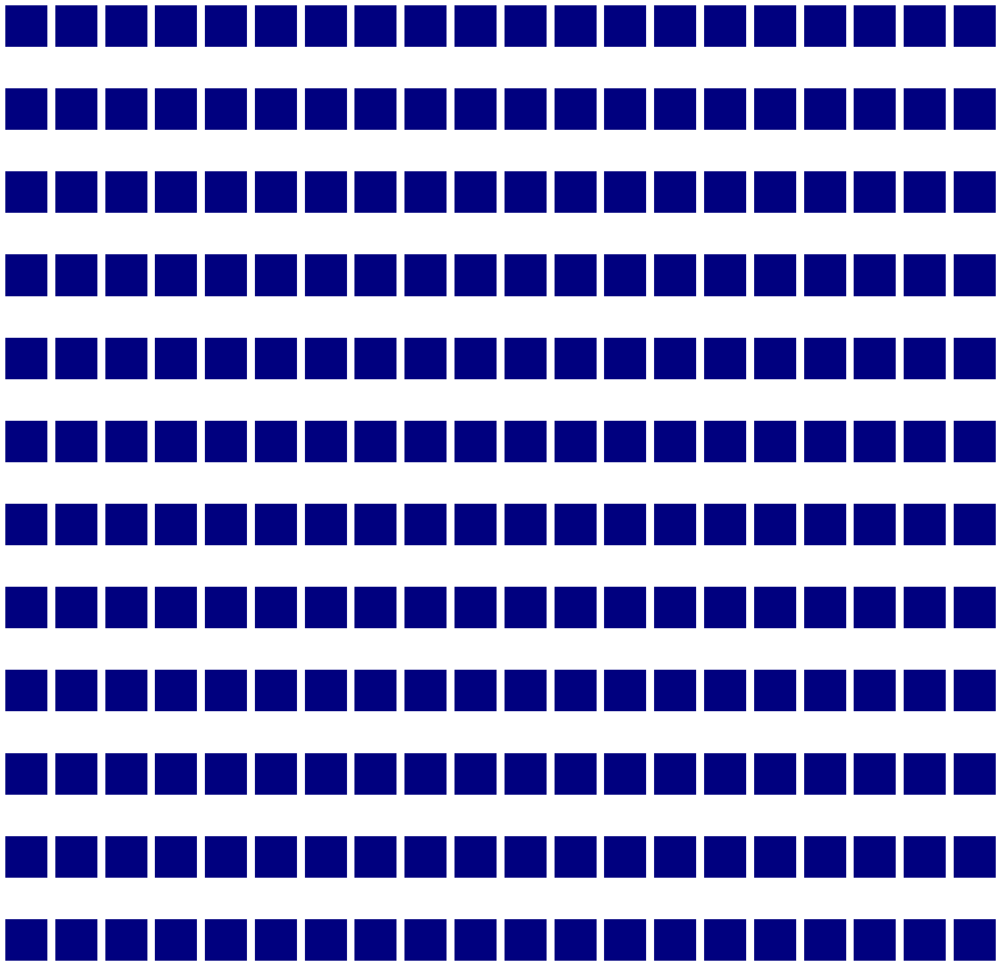

(1, 4, 4, 256)
conv2d_12


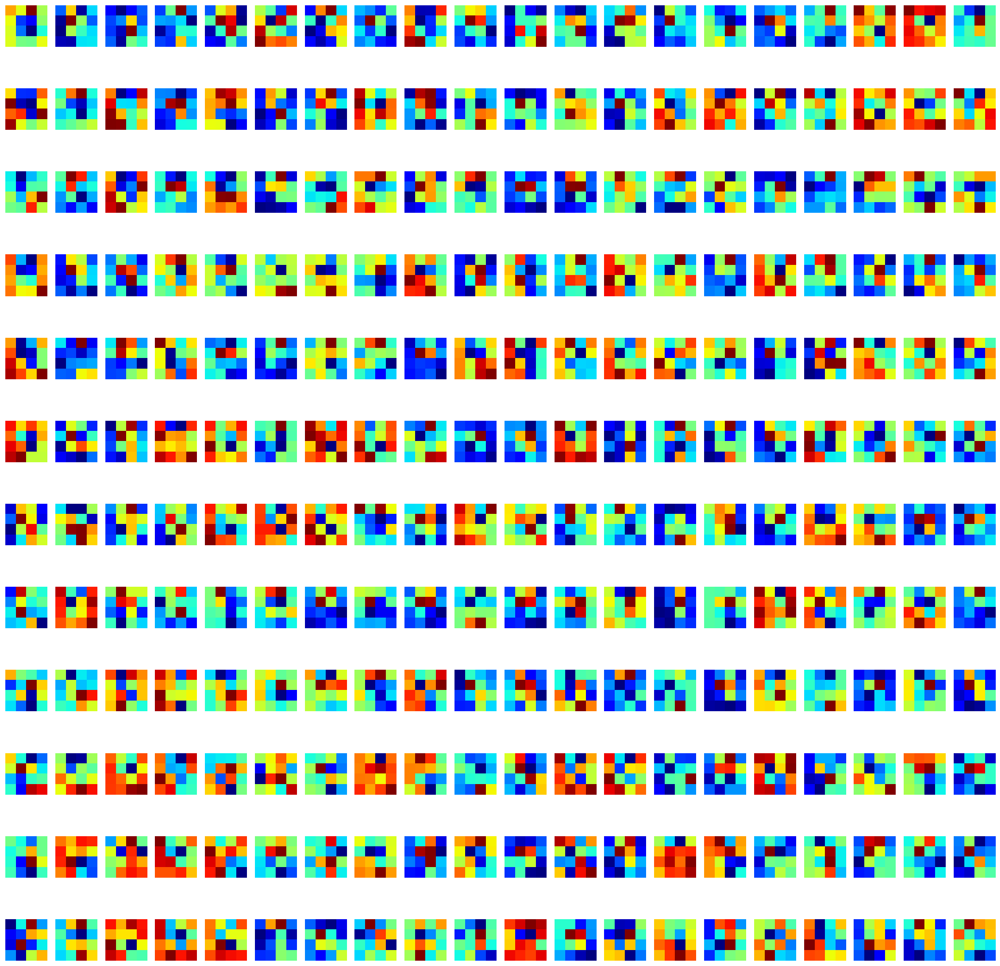

(1, 4, 4, 256)
conv2d_13


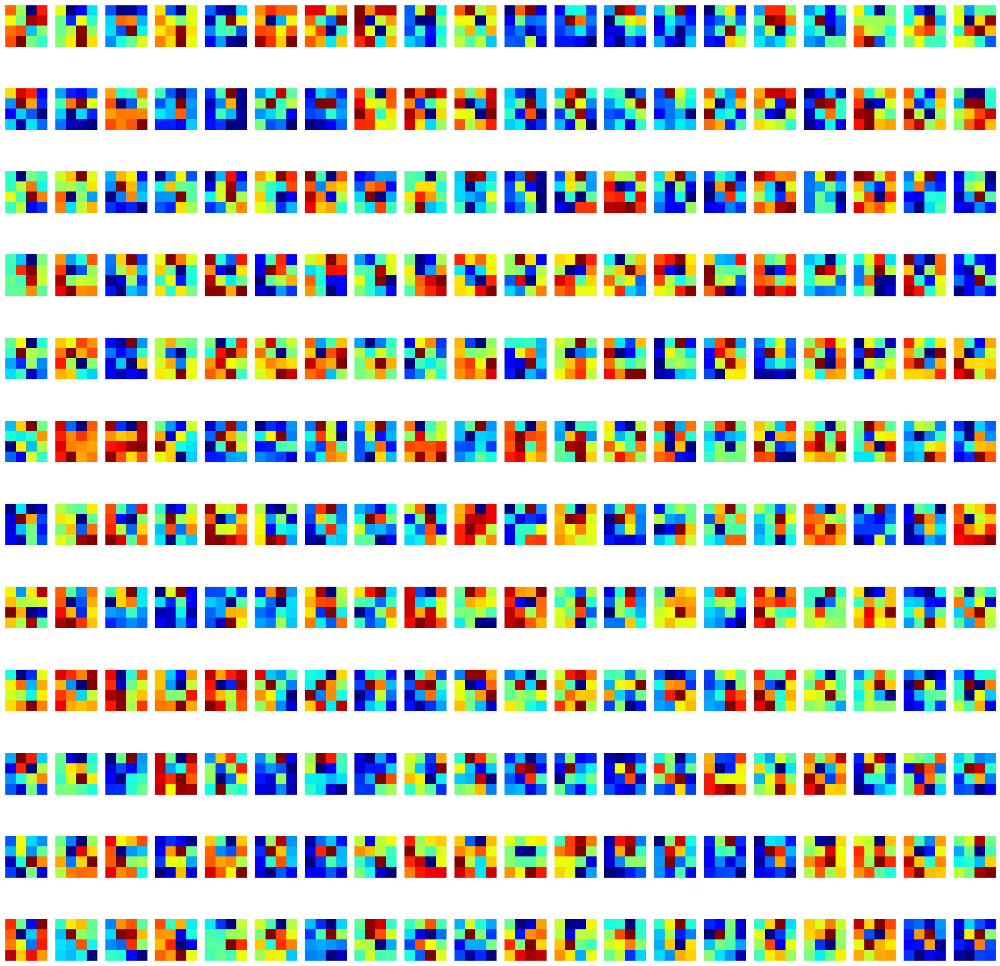

(1, 4, 4, 256)
conv2d_14


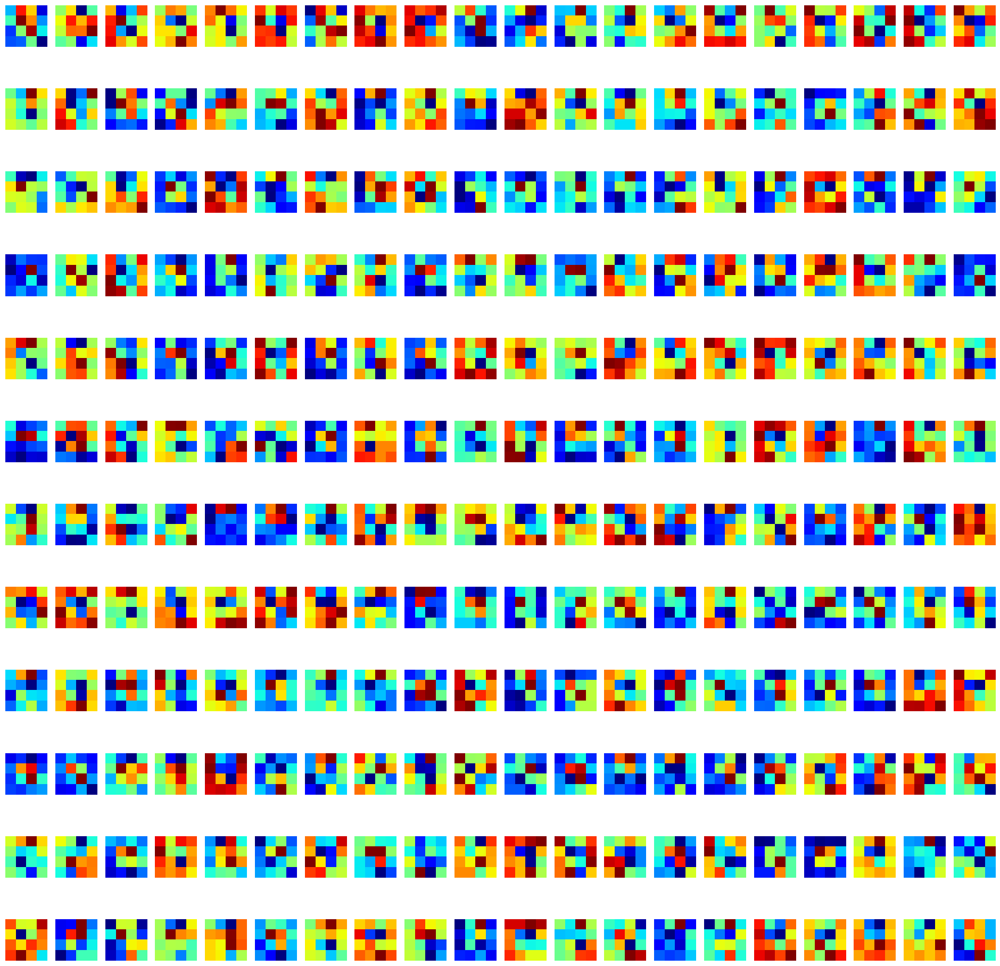

(1, 4, 4, 256)
conv2d_15


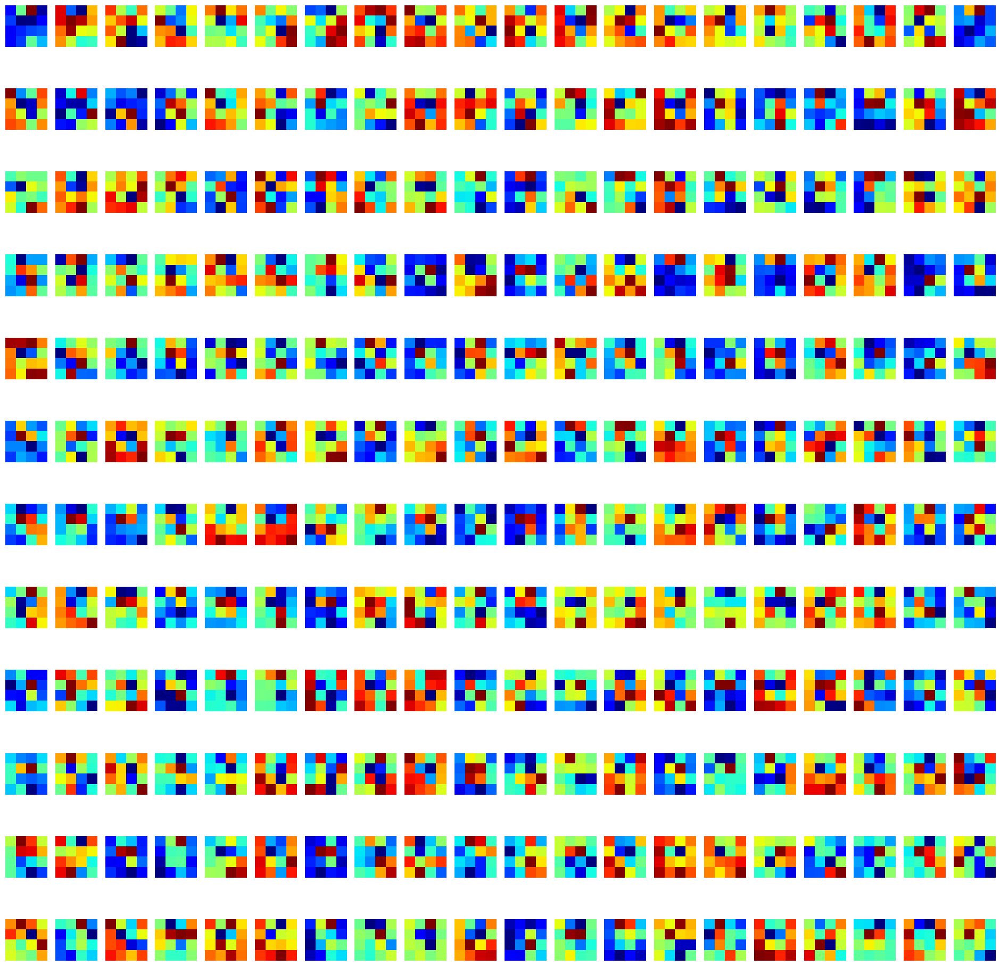

(1, 4, 4, 256)
conv2d_16


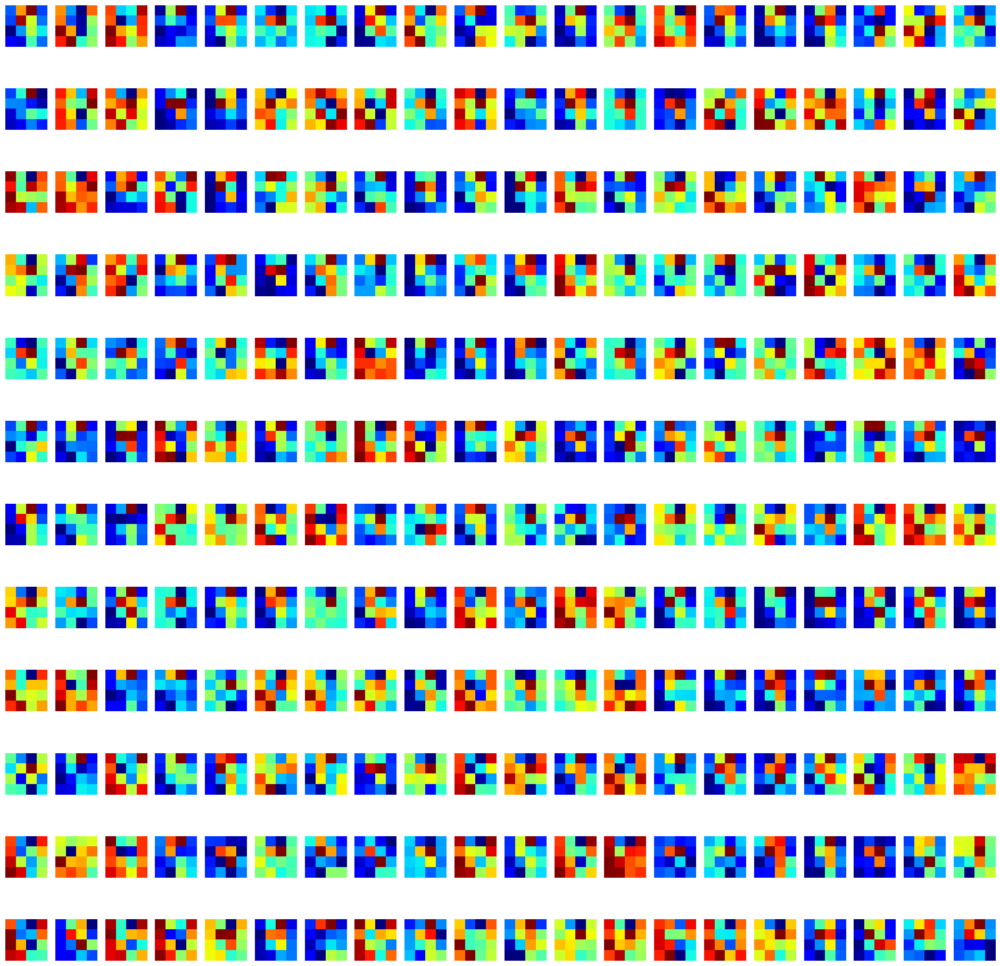

(1, 4, 4, 204)
voting_convolution


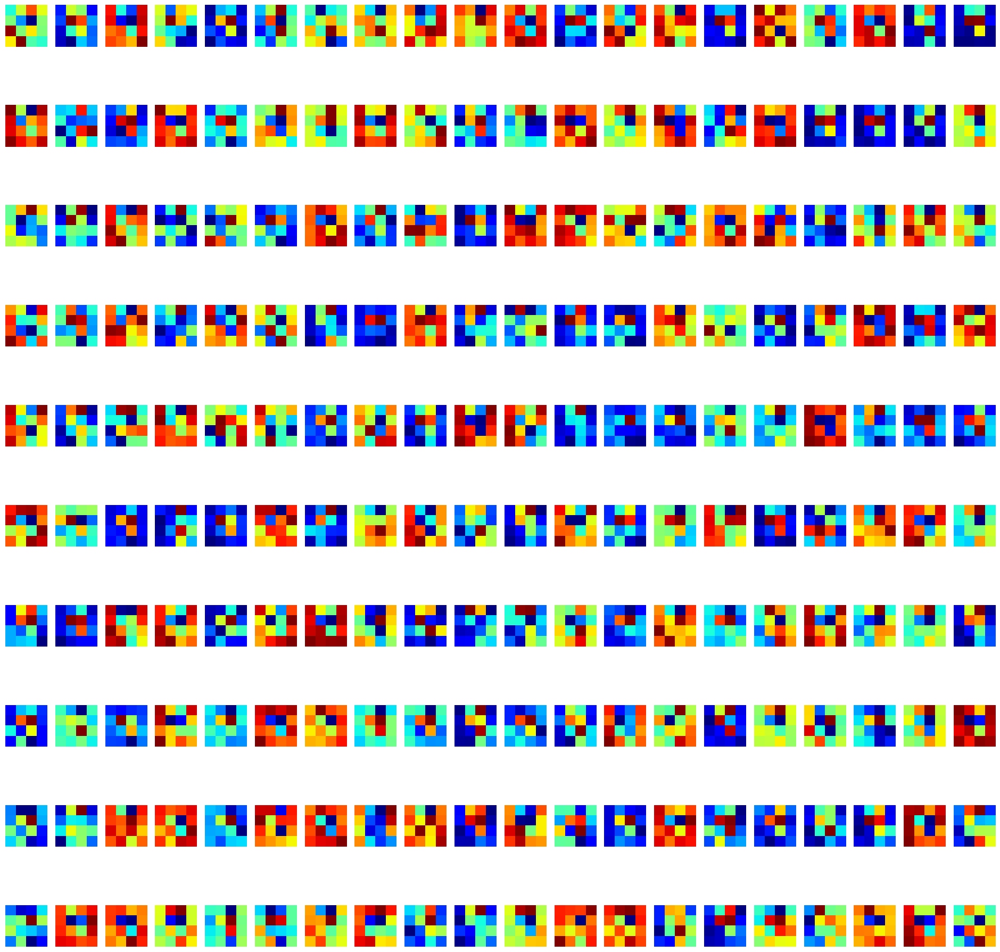

(1, 4, 4, 204)
voting_softmax_target
(1, 4, 4, 256)
feature_convolution


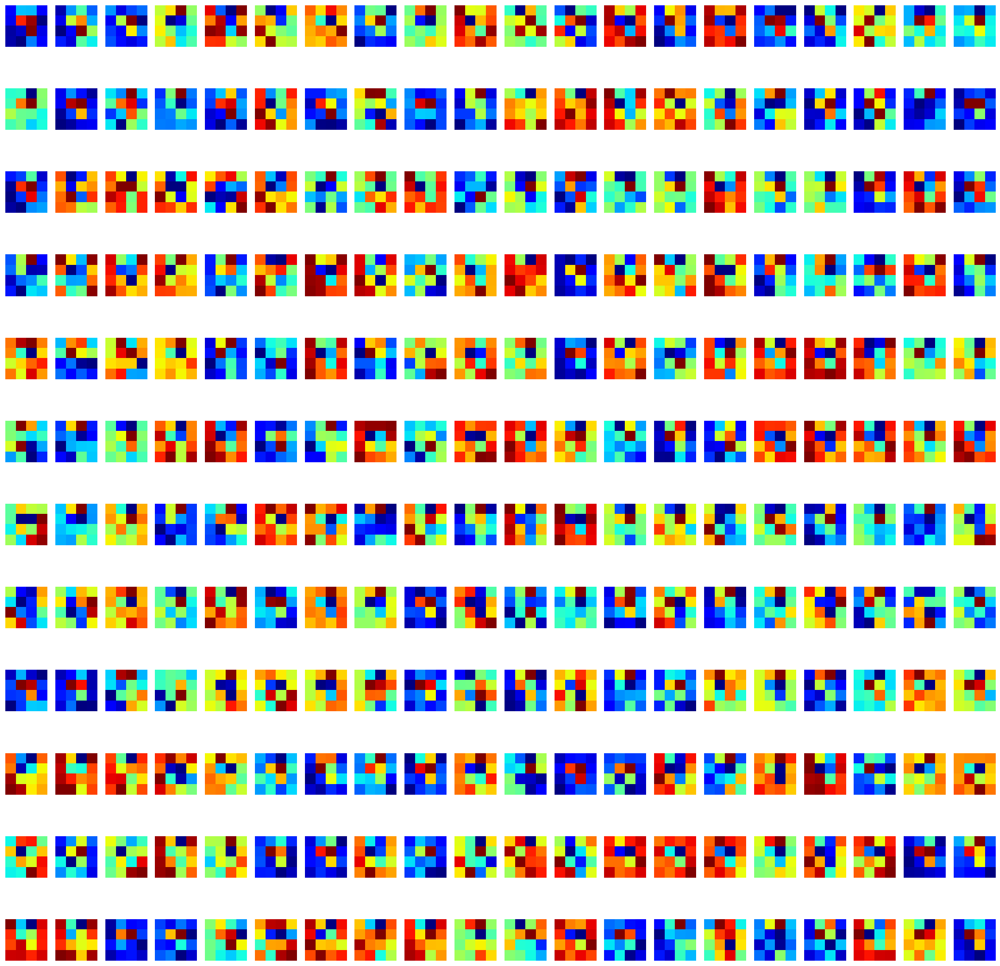

(1, 204, 256)
visual_feat
(1, 204, 256)
visual_feat
(1, 204, 256)
graph_convolution
(1, 204, 256)
evolved_feat
(1, 16, 204, 1)
Ws
(1, 16, 204, 1)
mapping_softmax
(1, 204, 256)
Wsp
(1, 16, 256)
applied_mapping
(1, 32, 32, 256)
conv2d_19


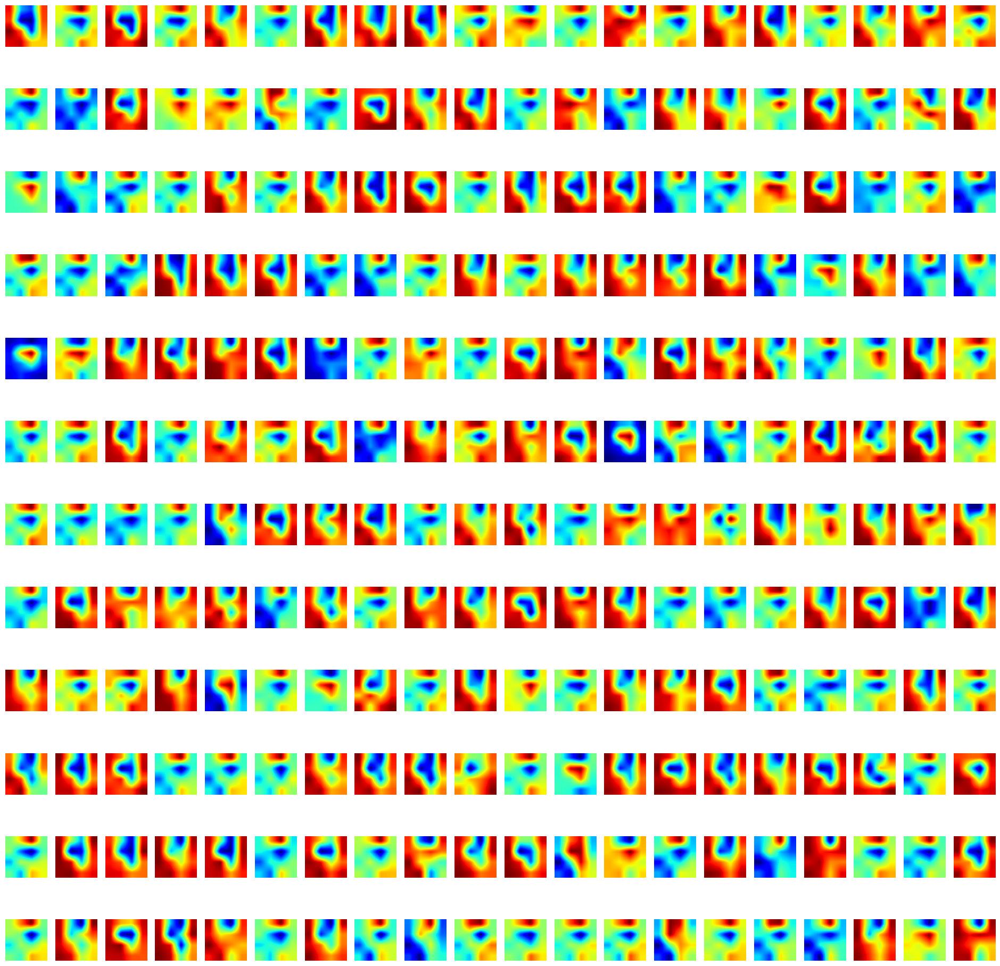

(1, 128, 128, 256)
conv2d_20


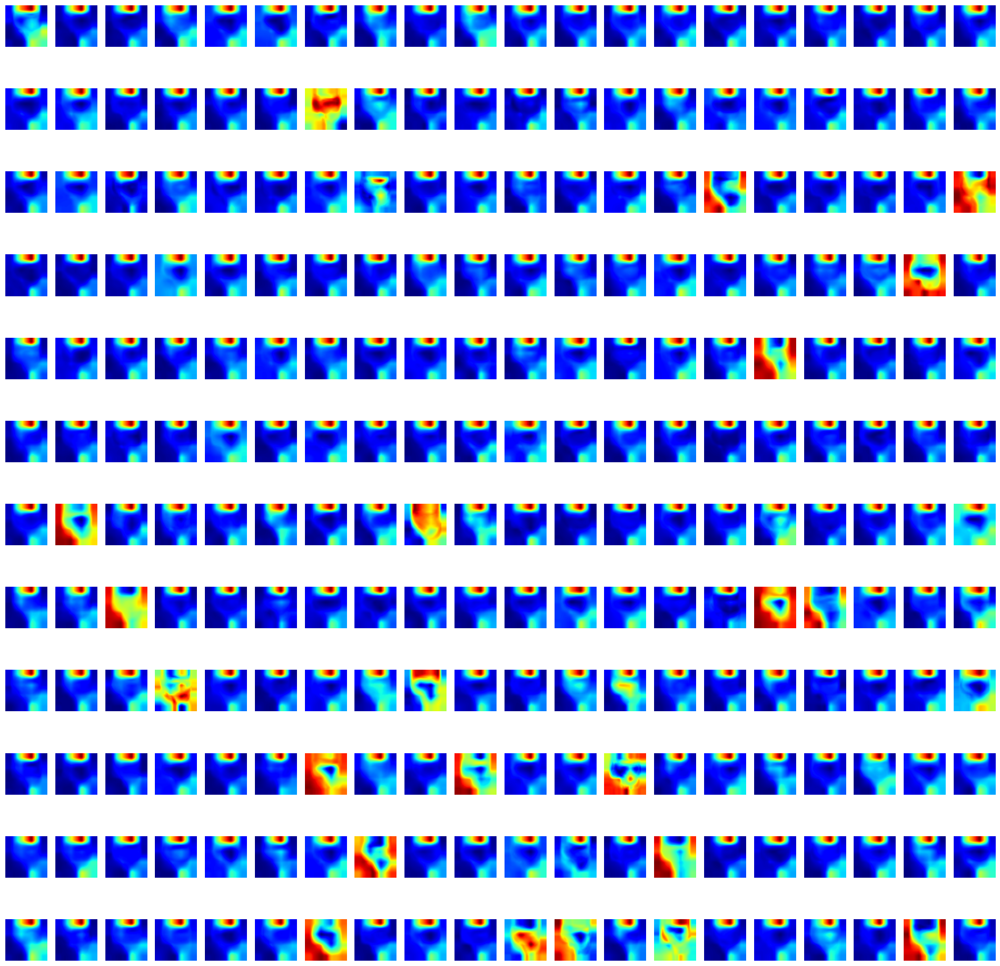

(1, 128, 128, 21)
conv2d_21


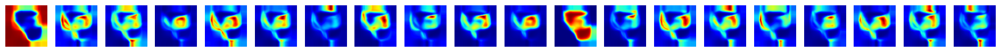

1/1 [==============================] - 0s 320ms/step
20
(1, 1, 1, 256)
conv2d_11


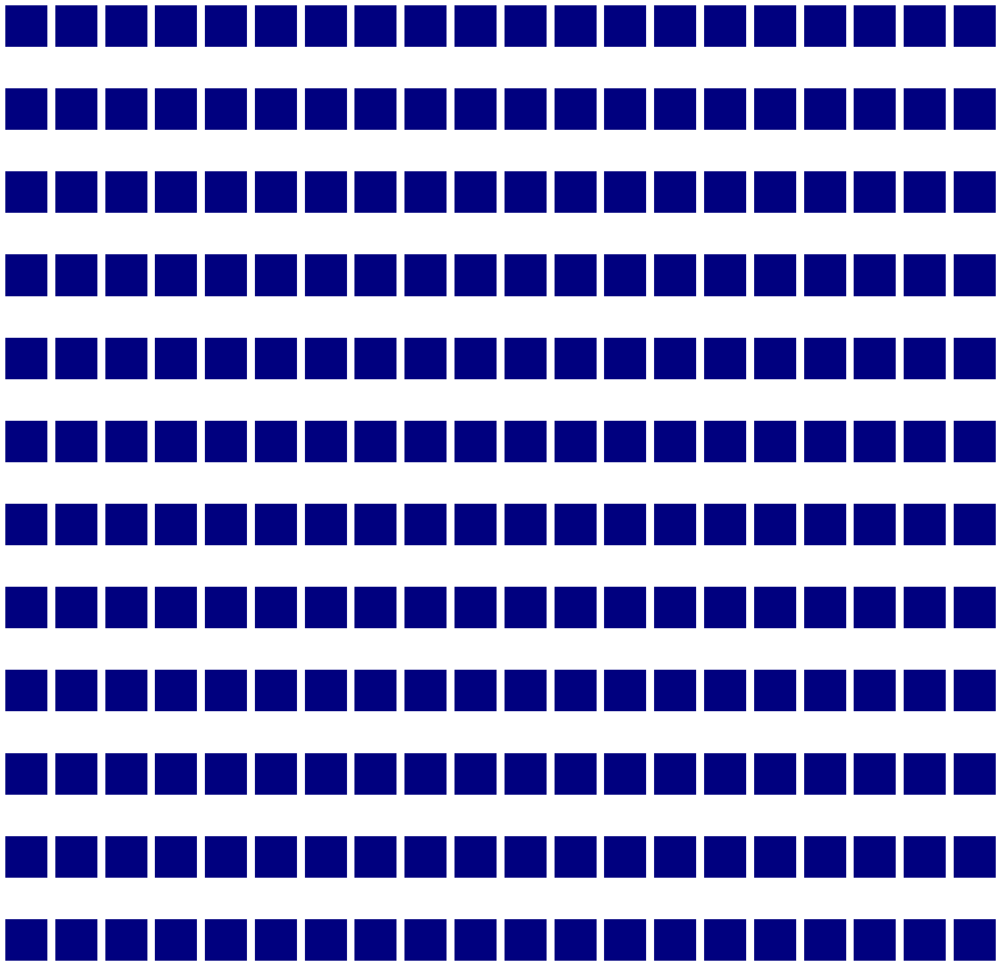

(1, 4, 4, 256)
conv2d_12


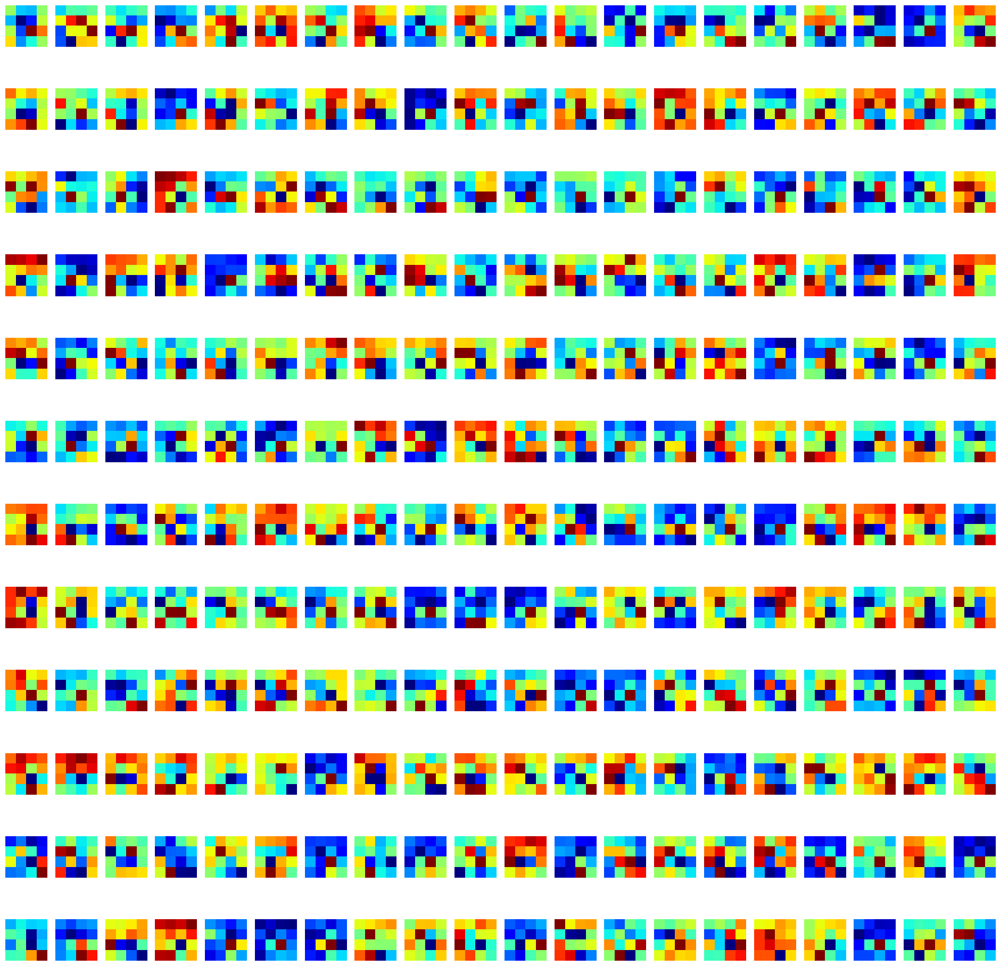

(1, 4, 4, 256)
conv2d_13


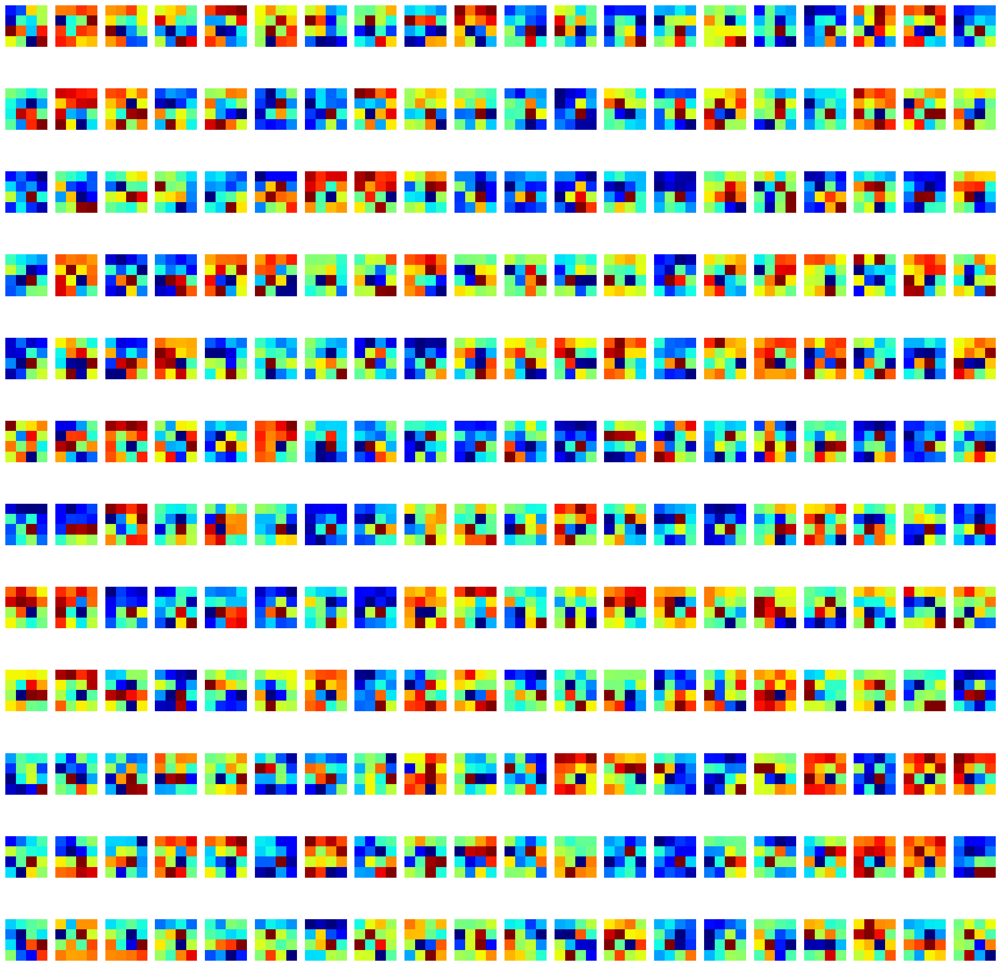

(1, 4, 4, 256)
conv2d_14


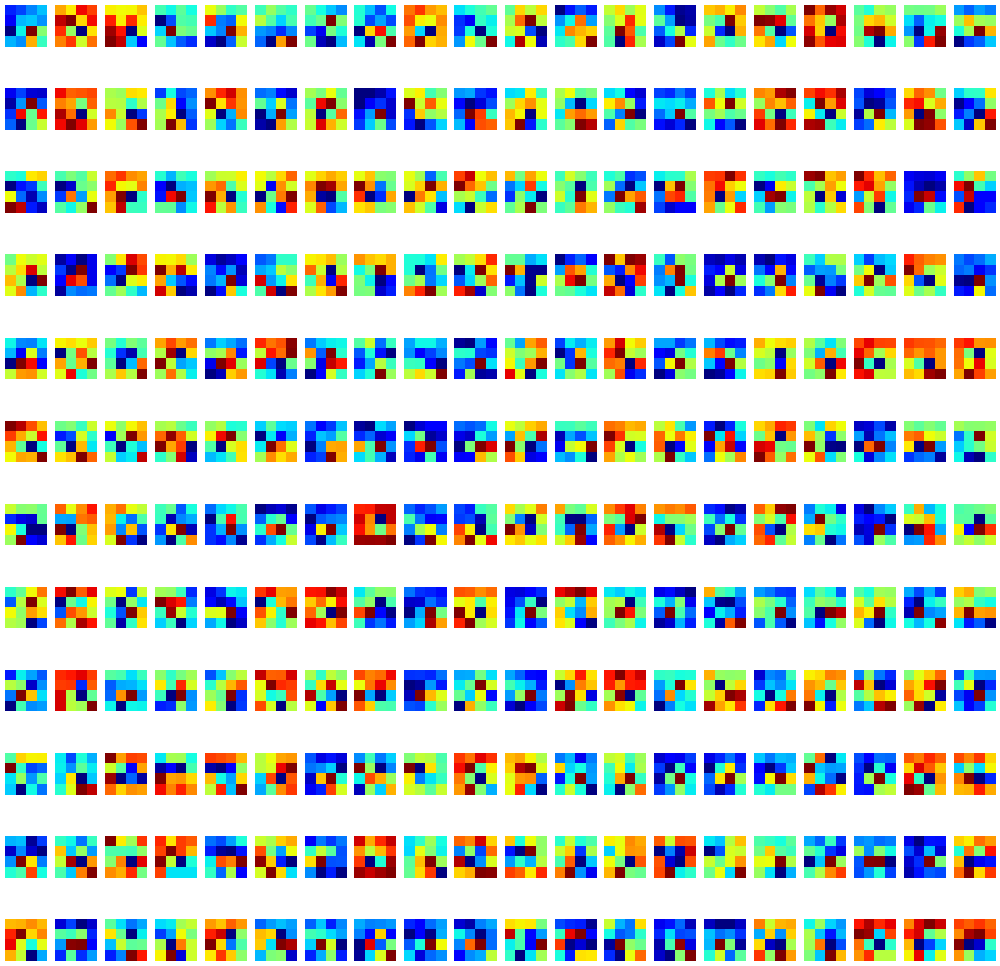

(1, 4, 4, 256)
conv2d_15


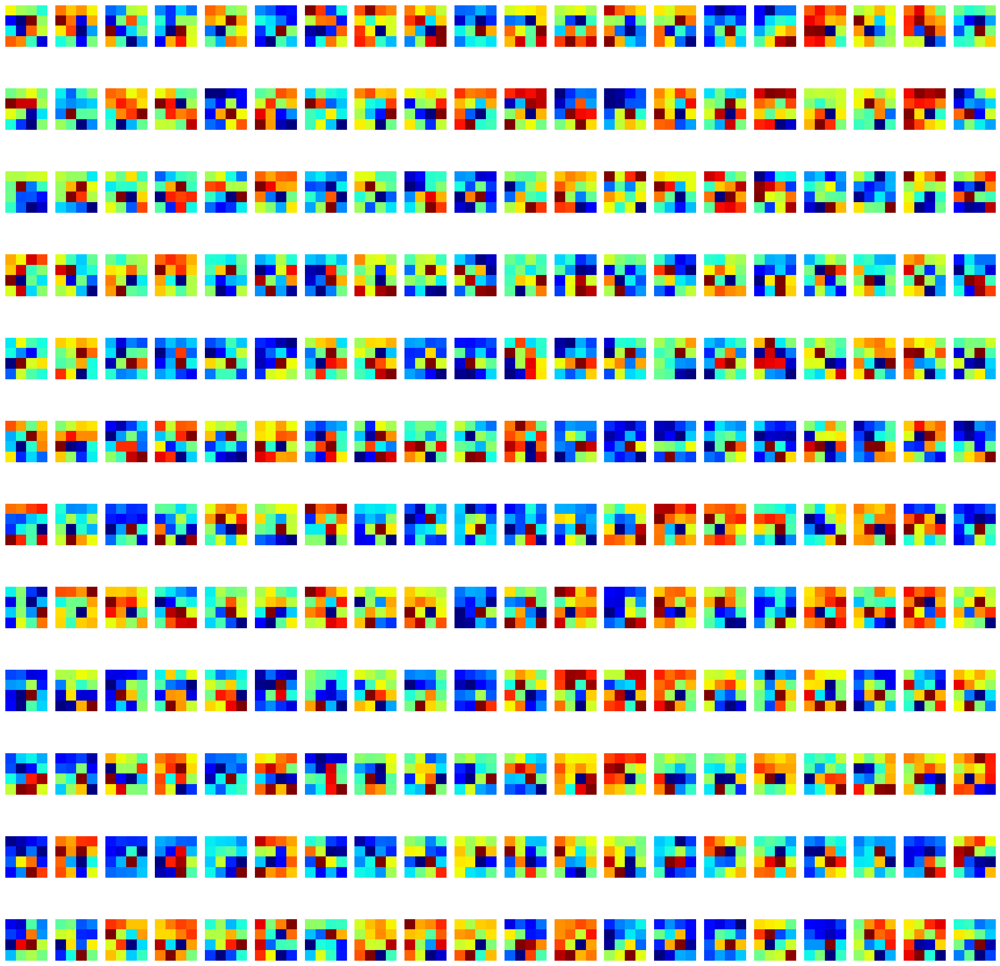

(1, 4, 4, 256)
conv2d_16


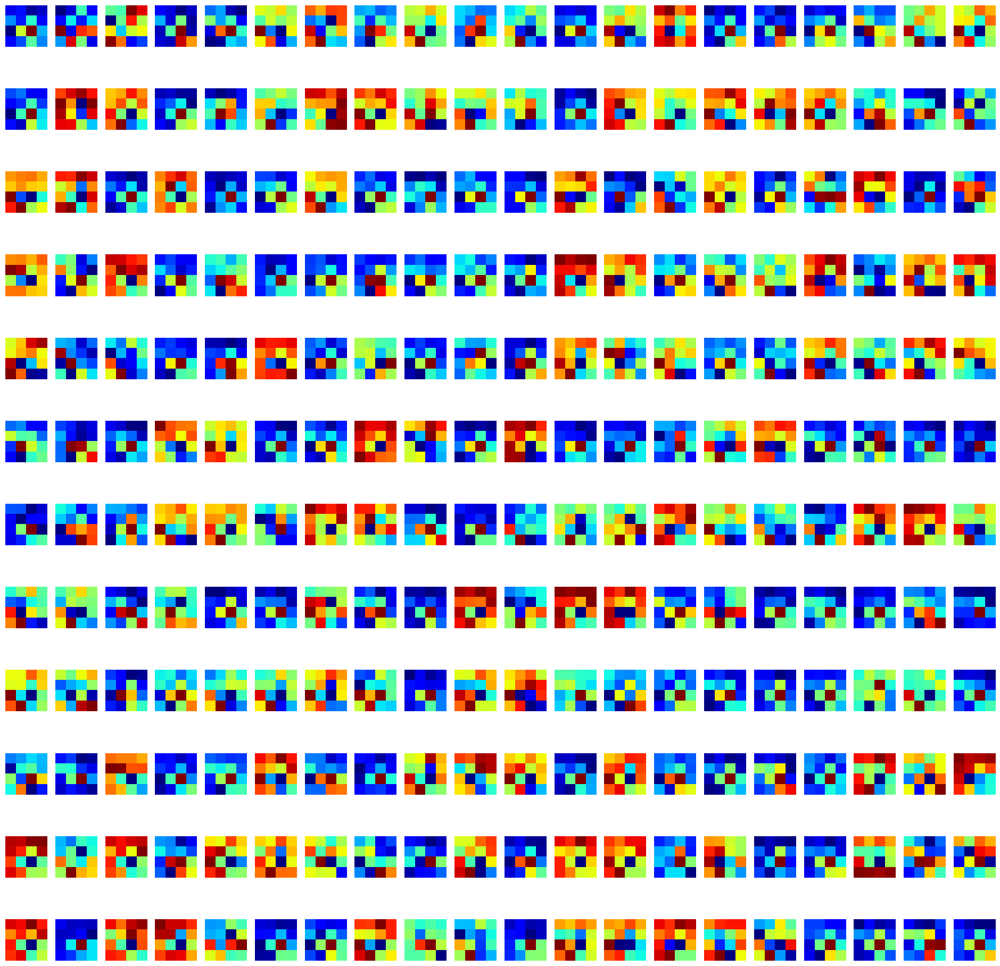

(1, 4, 4, 204)
voting_convolution


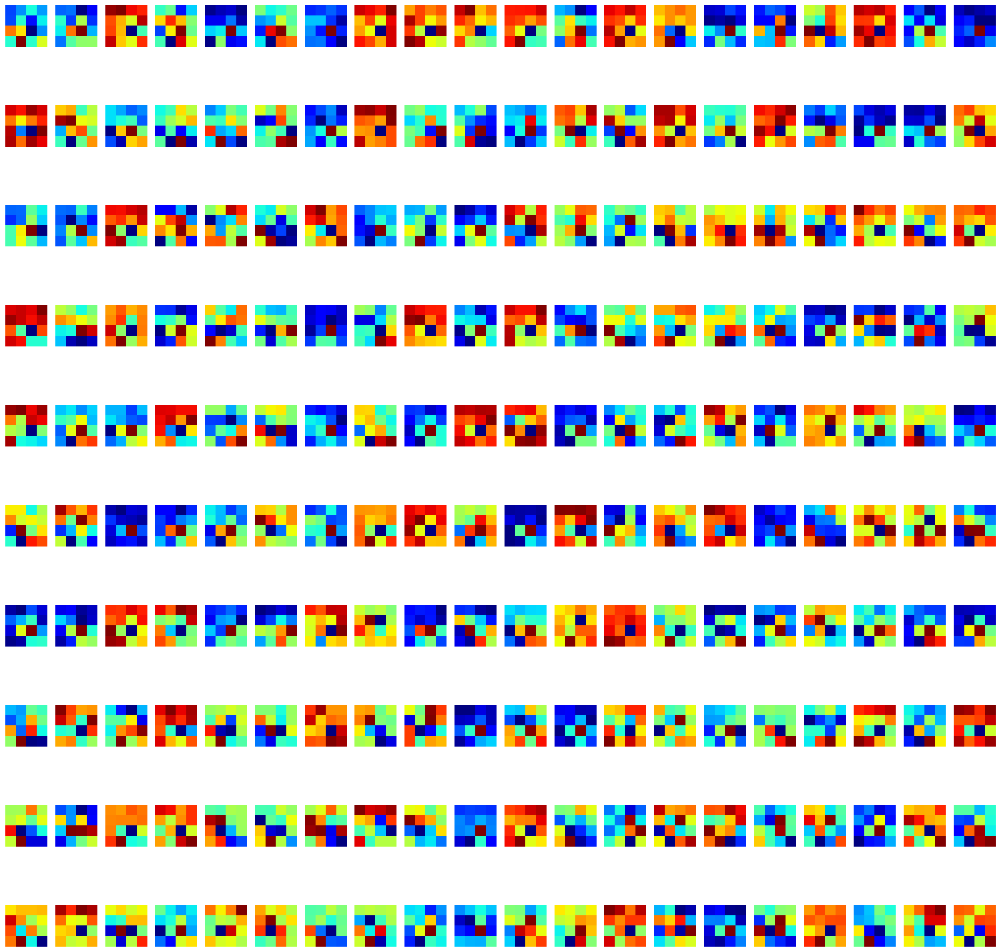

(1, 4, 4, 204)
voting_softmax_target
(1, 4, 4, 256)
feature_convolution


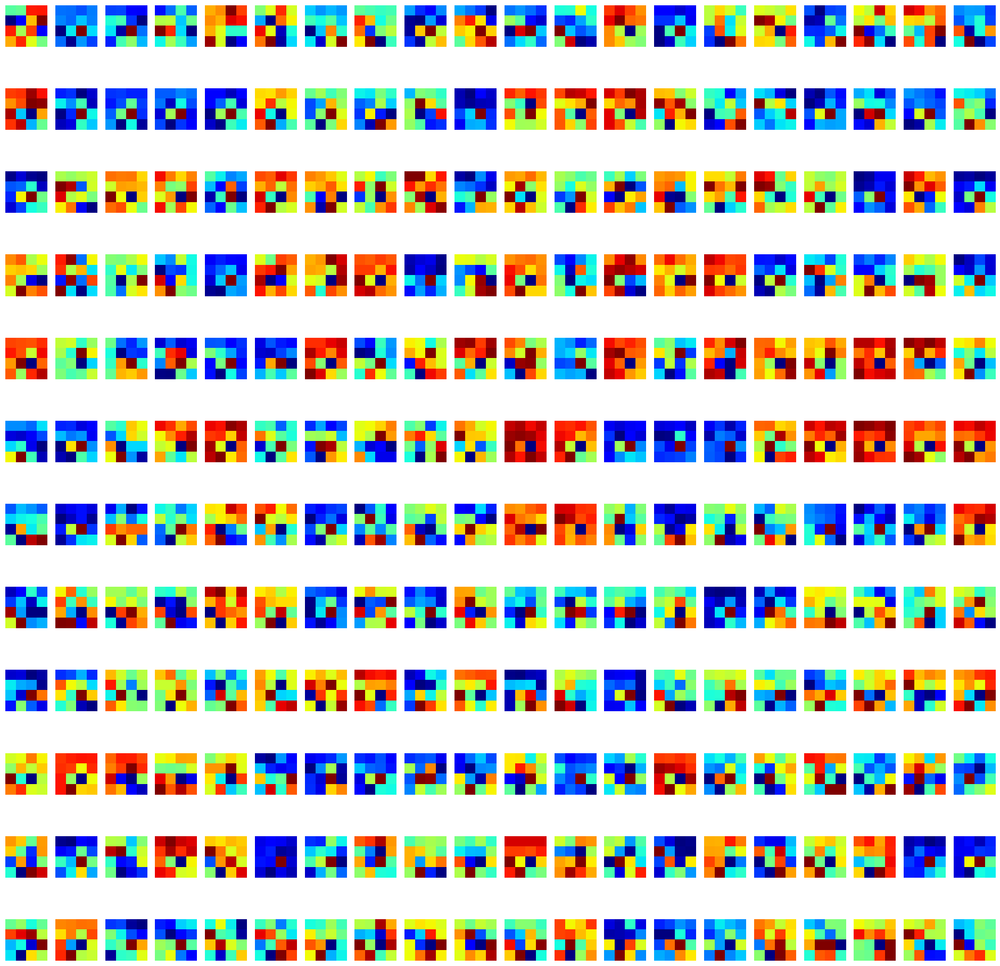

(1, 204, 256)
visual_feat
(1, 204, 256)
visual_feat
(1, 204, 256)
graph_convolution
(1, 204, 256)
evolved_feat
(1, 16, 204, 1)
Ws
(1, 16, 204, 1)
mapping_softmax
(1, 204, 256)
Wsp
(1, 16, 256)
applied_mapping
(1, 32, 32, 256)
conv2d_19


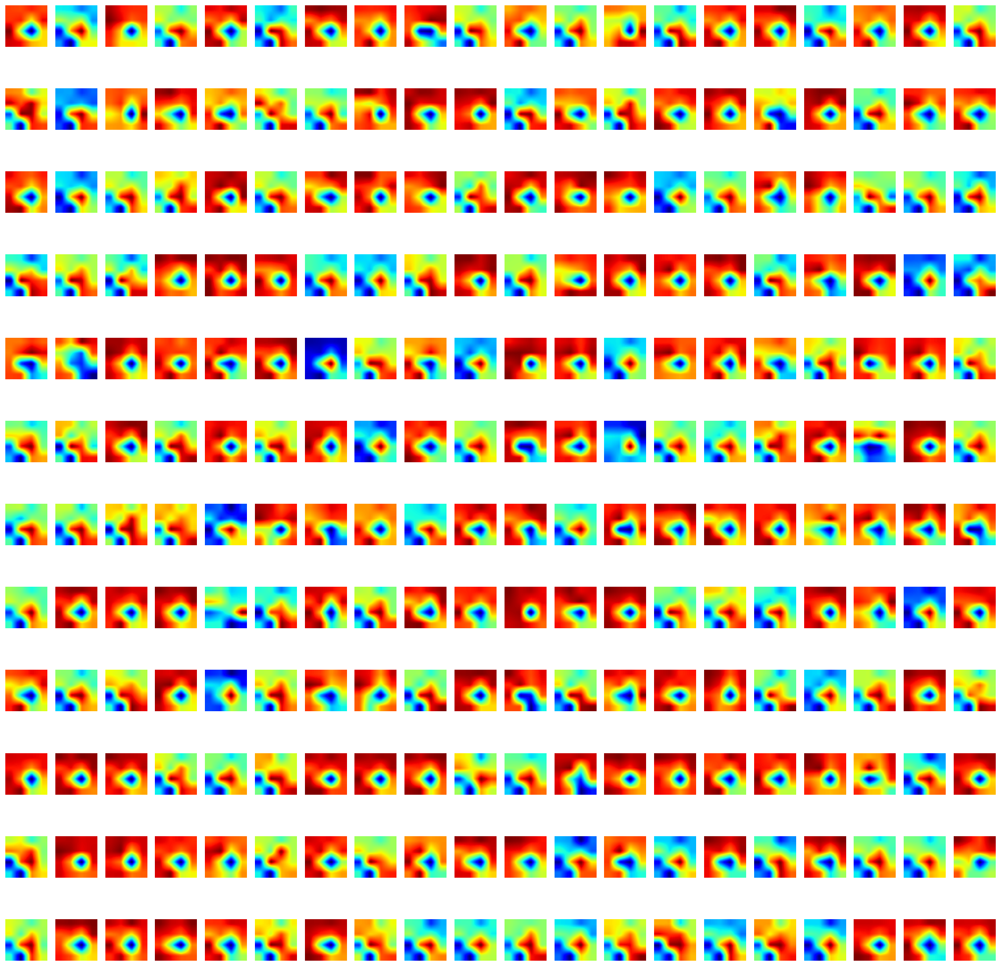

(1, 128, 128, 256)
conv2d_20


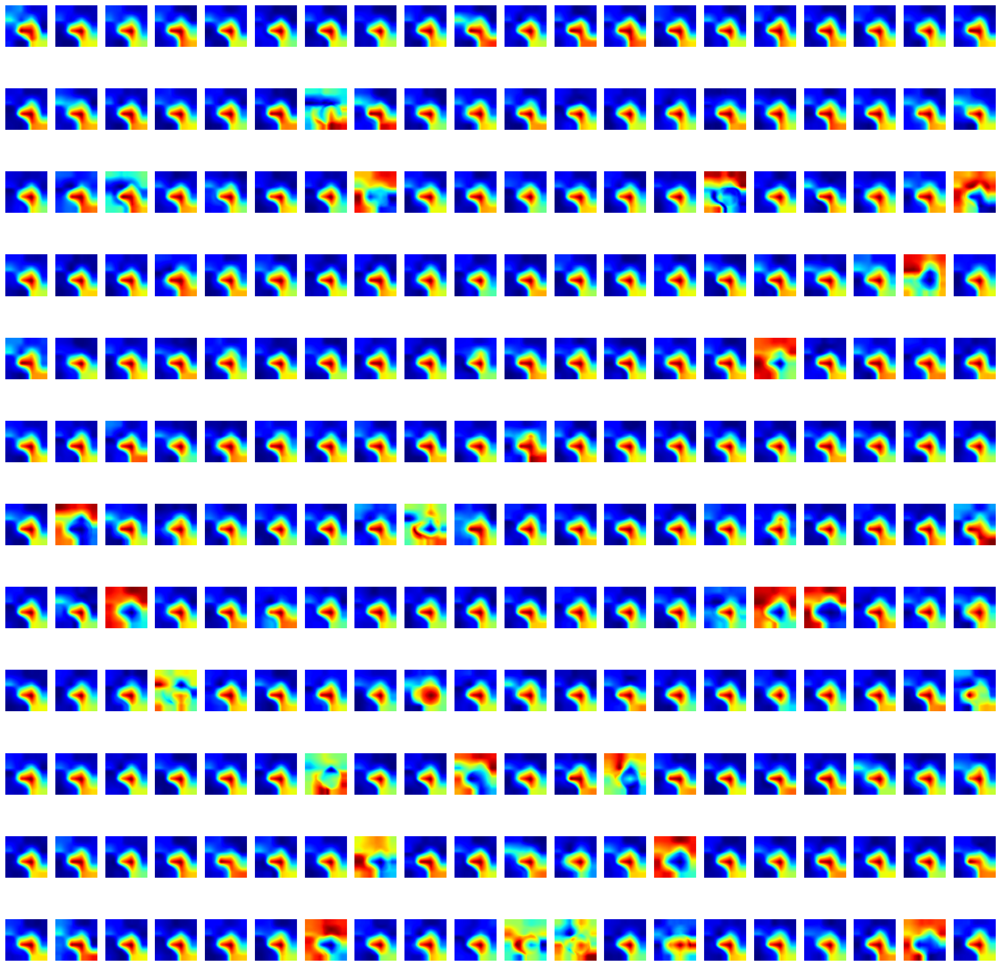

(1, 128, 128, 21)
conv2d_21


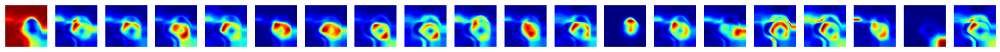

1/1 [==============================] - 0s 308ms/step
20
(1, 1, 1, 256)
conv2d_11


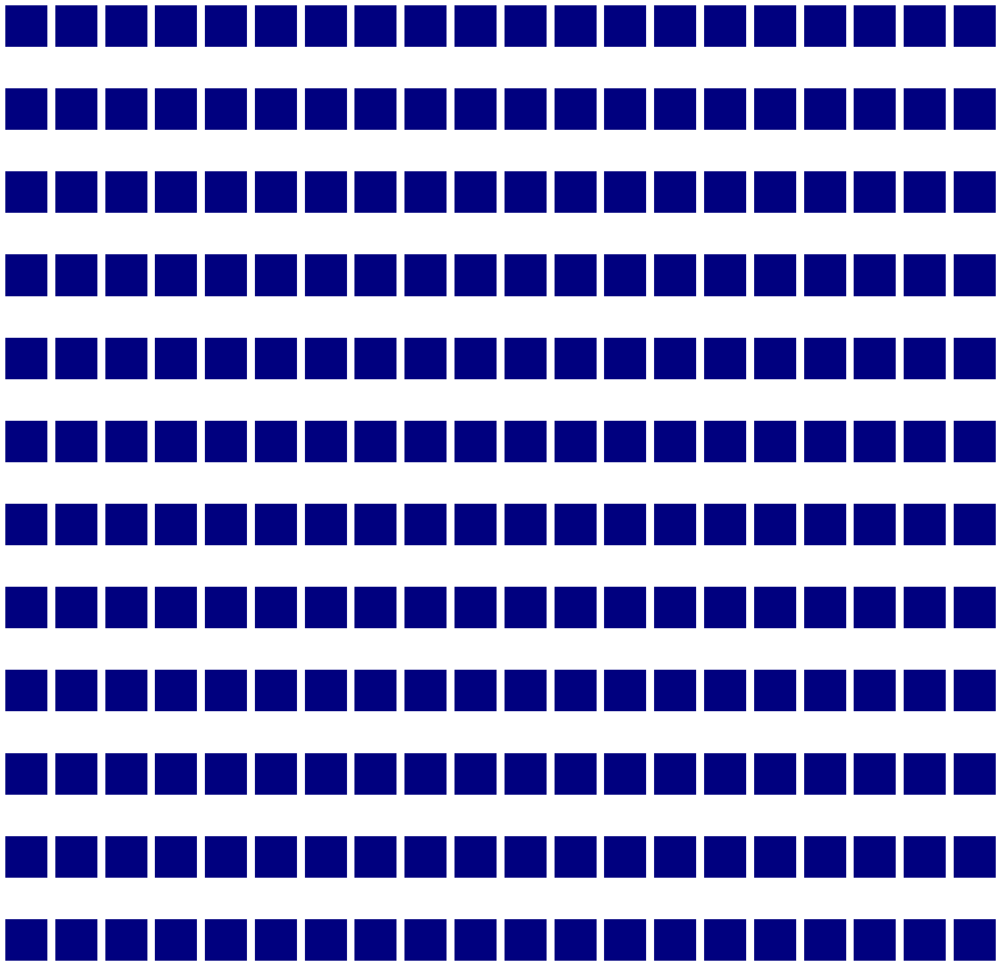

(1, 4, 4, 256)
conv2d_12


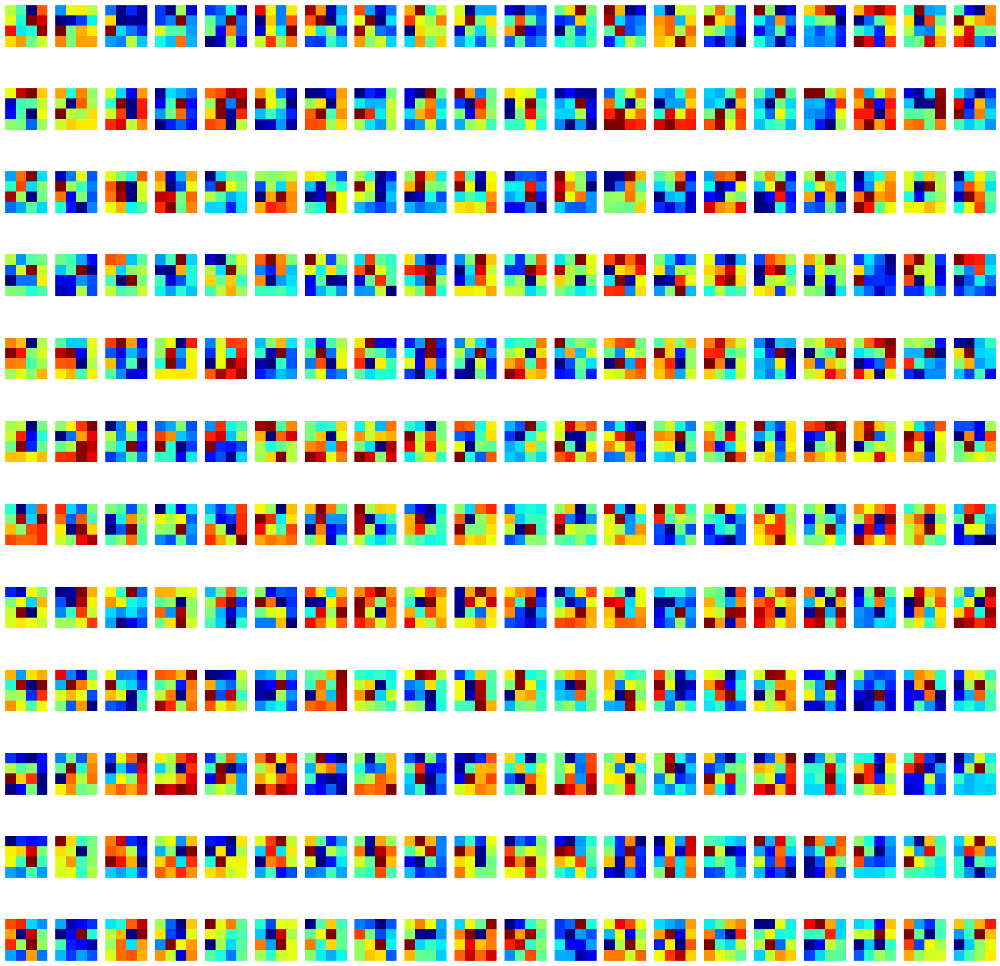

(1, 4, 4, 256)
conv2d_13


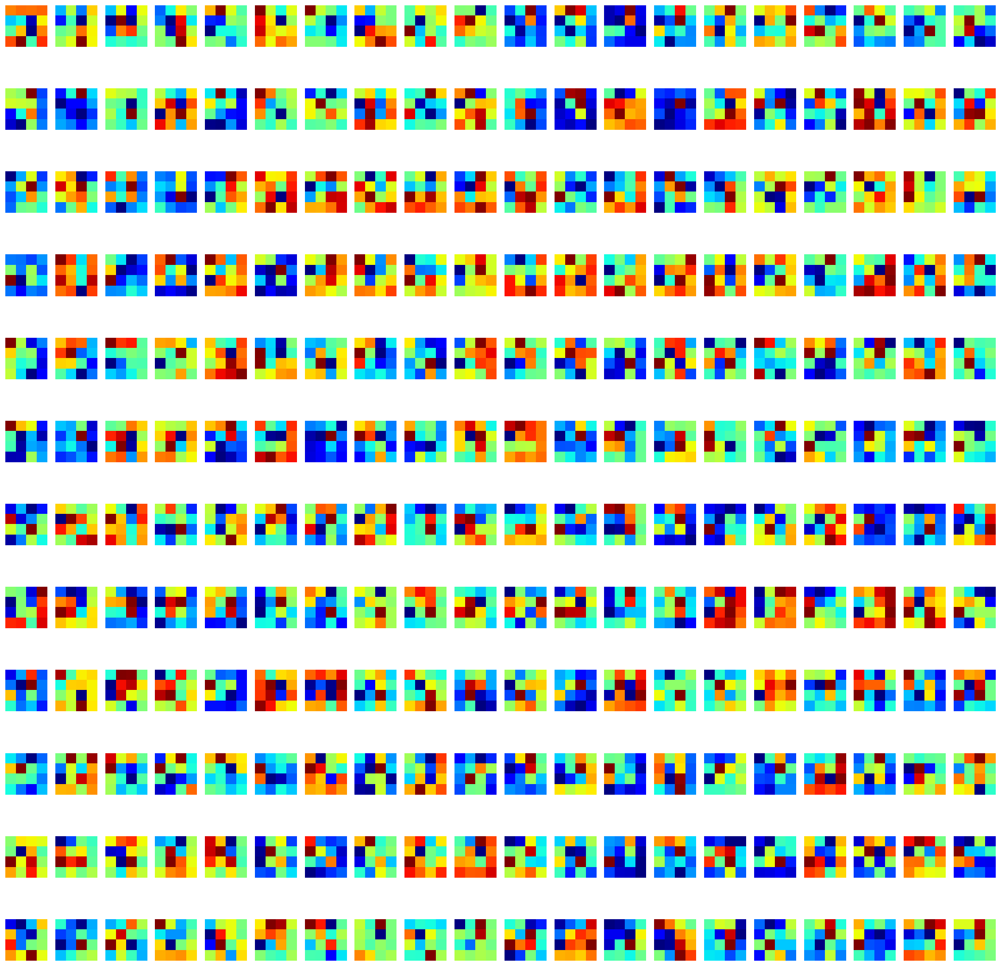

(1, 4, 4, 256)
conv2d_14


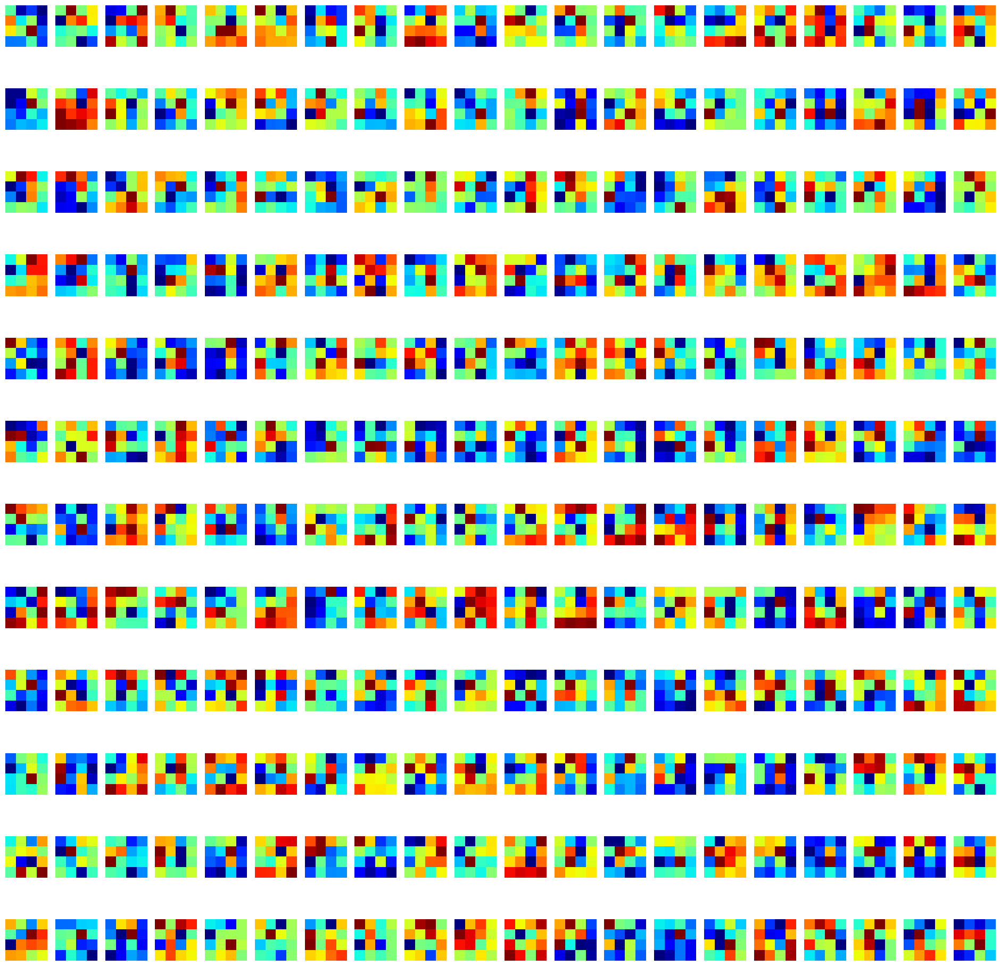

(1, 4, 4, 256)
conv2d_15


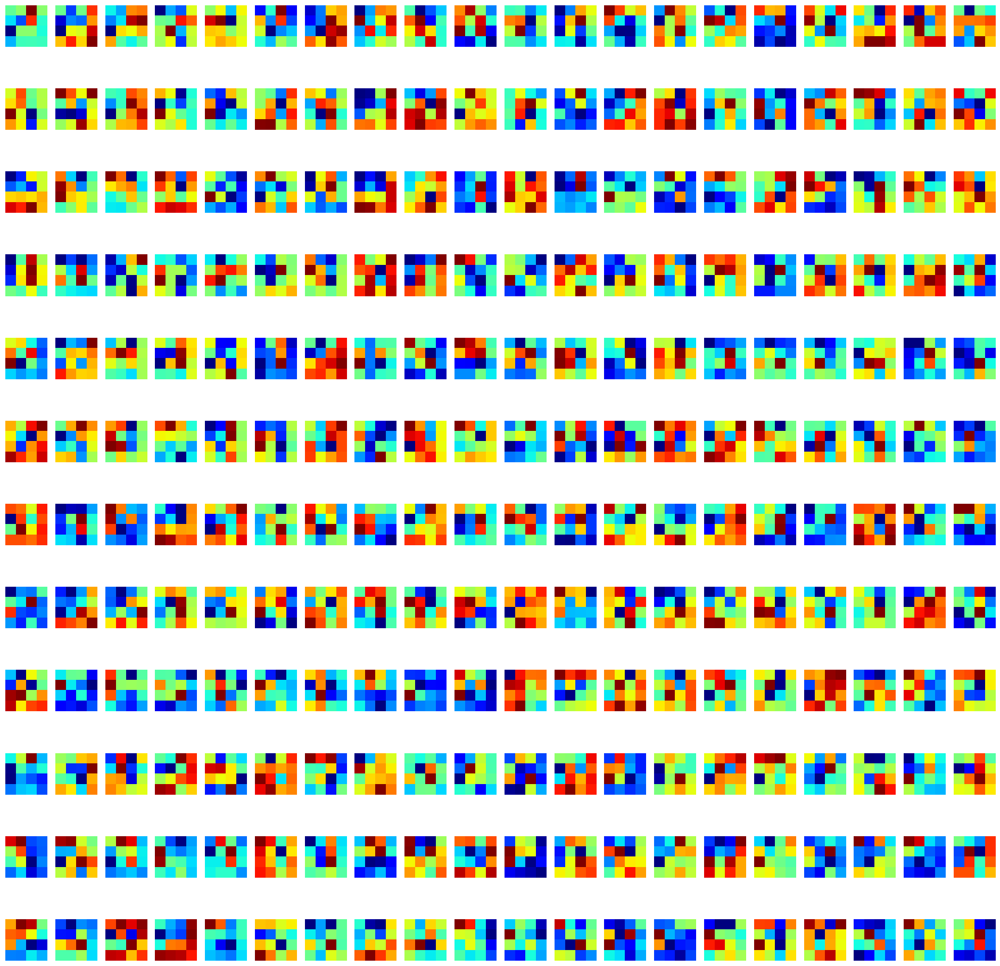

(1, 4, 4, 256)
conv2d_16


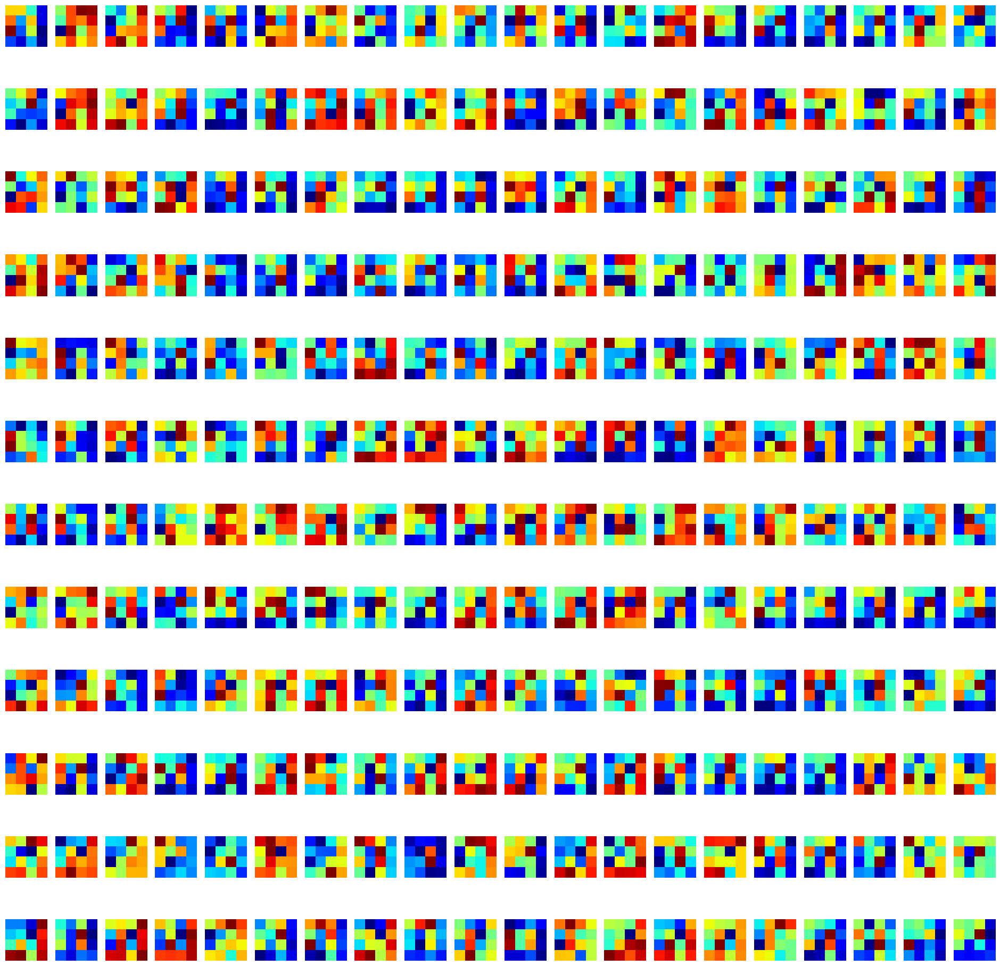

(1, 4, 4, 204)
voting_convolution


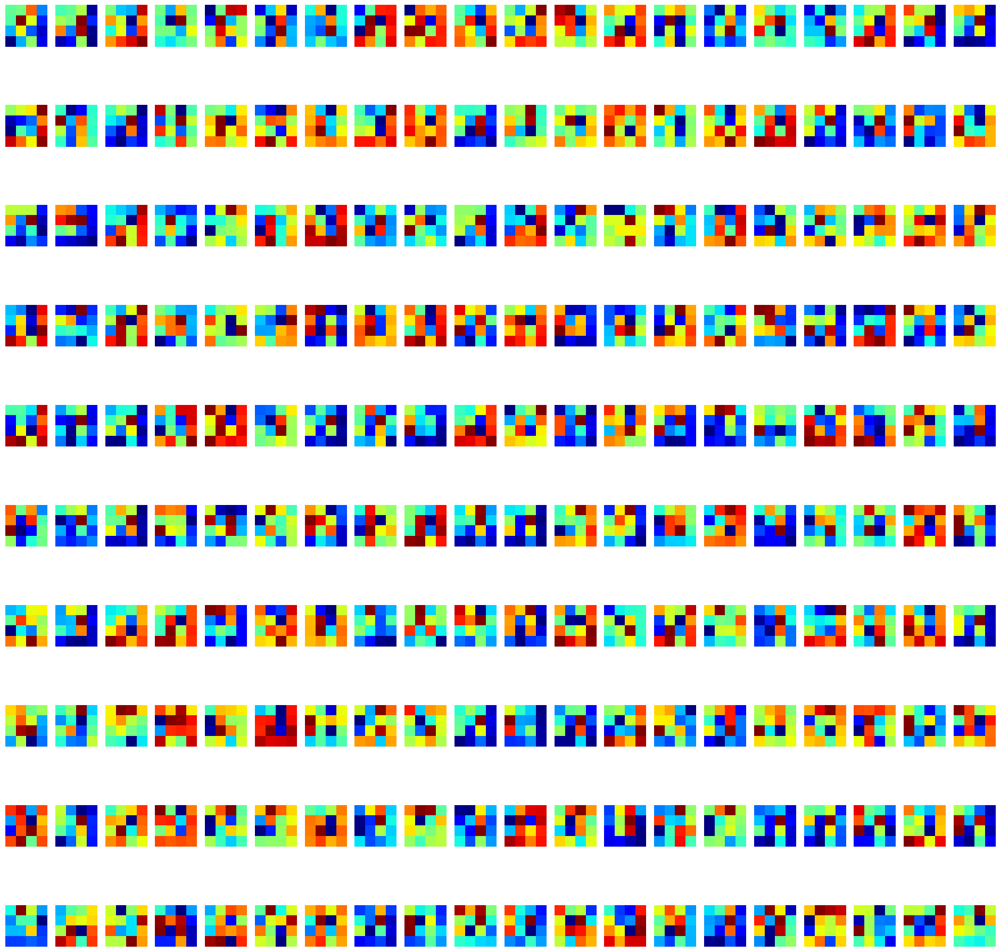

(1, 4, 4, 204)
voting_softmax_target
(1, 4, 4, 256)
feature_convolution


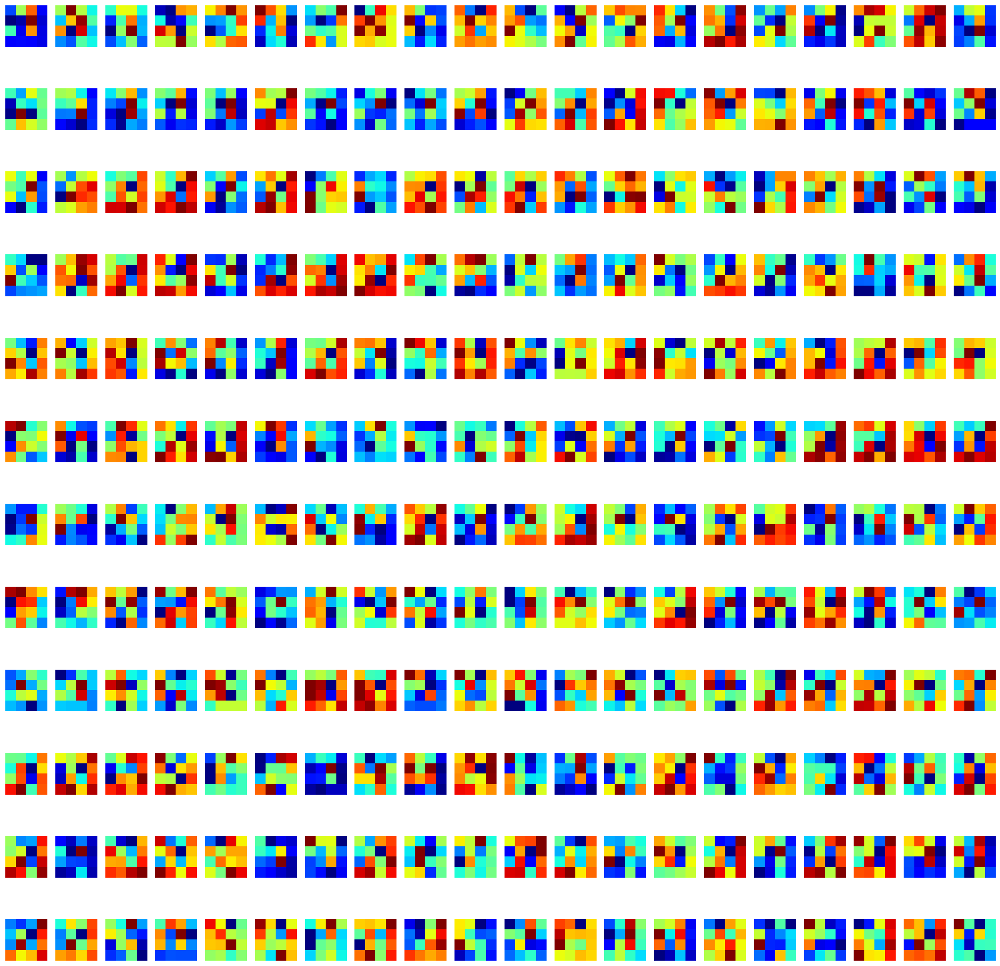

(1, 204, 256)
visual_feat
(1, 204, 256)
visual_feat
(1, 204, 256)
graph_convolution
(1, 204, 256)
evolved_feat
(1, 16, 204, 1)
Ws
(1, 16, 204, 1)
mapping_softmax
(1, 204, 256)
Wsp
(1, 16, 256)
applied_mapping
(1, 32, 32, 256)
conv2d_19


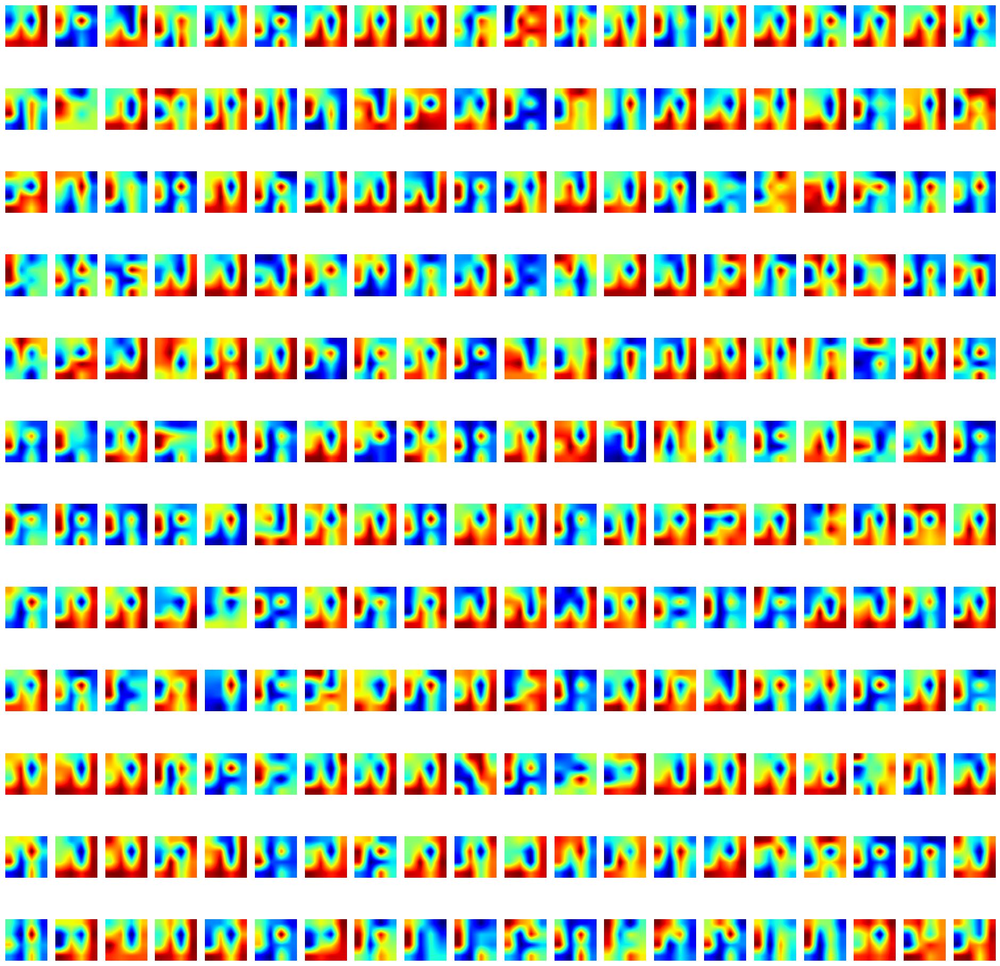

(1, 128, 128, 256)
conv2d_20


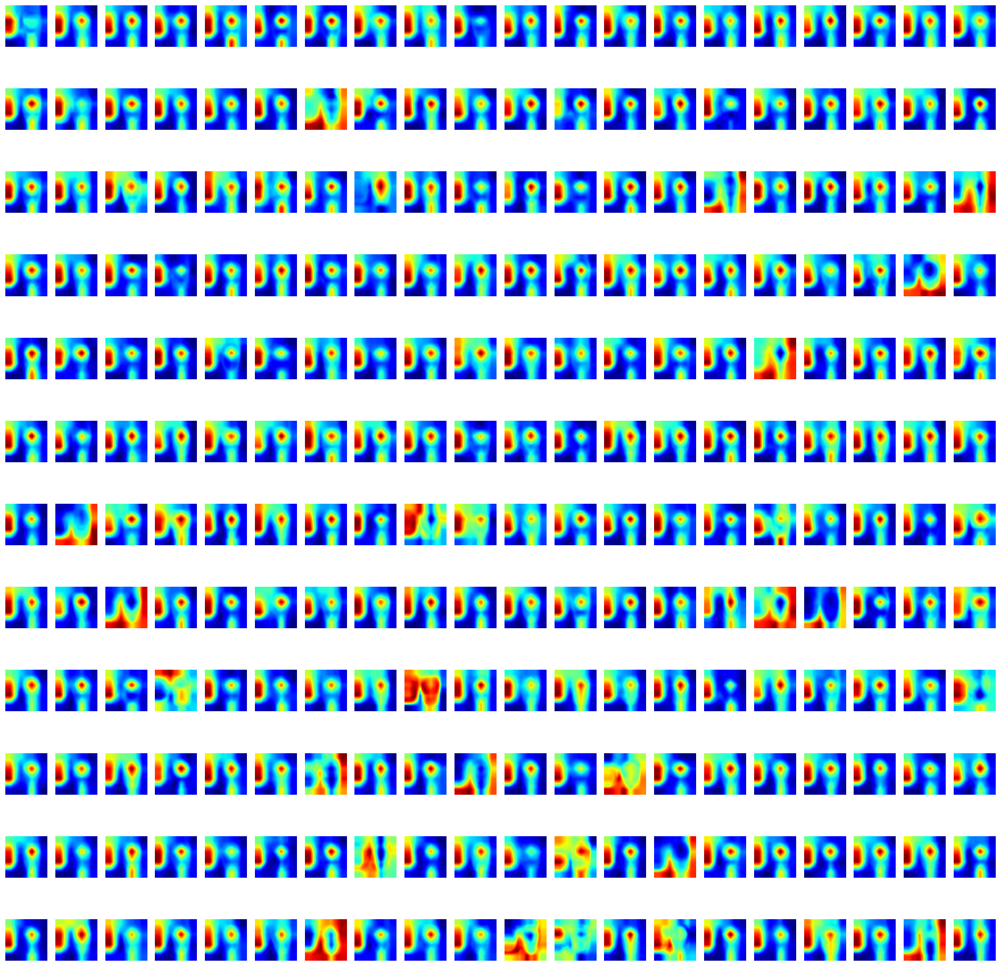

(1, 128, 128, 21)
conv2d_21


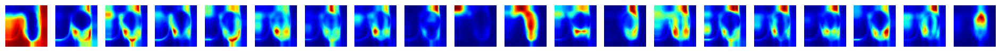

1/1 [==============================] - 0s 316ms/step
20
(1, 1, 1, 256)
conv2d_11


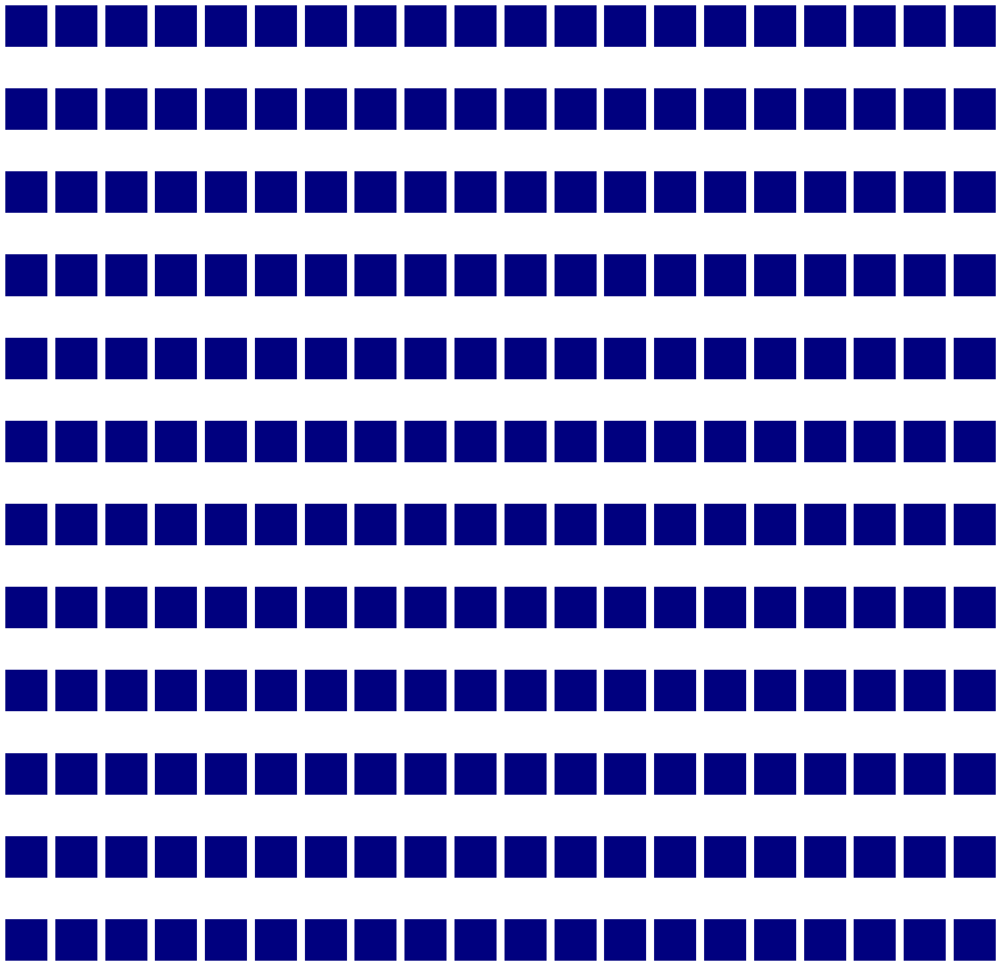

(1, 4, 4, 256)
conv2d_12


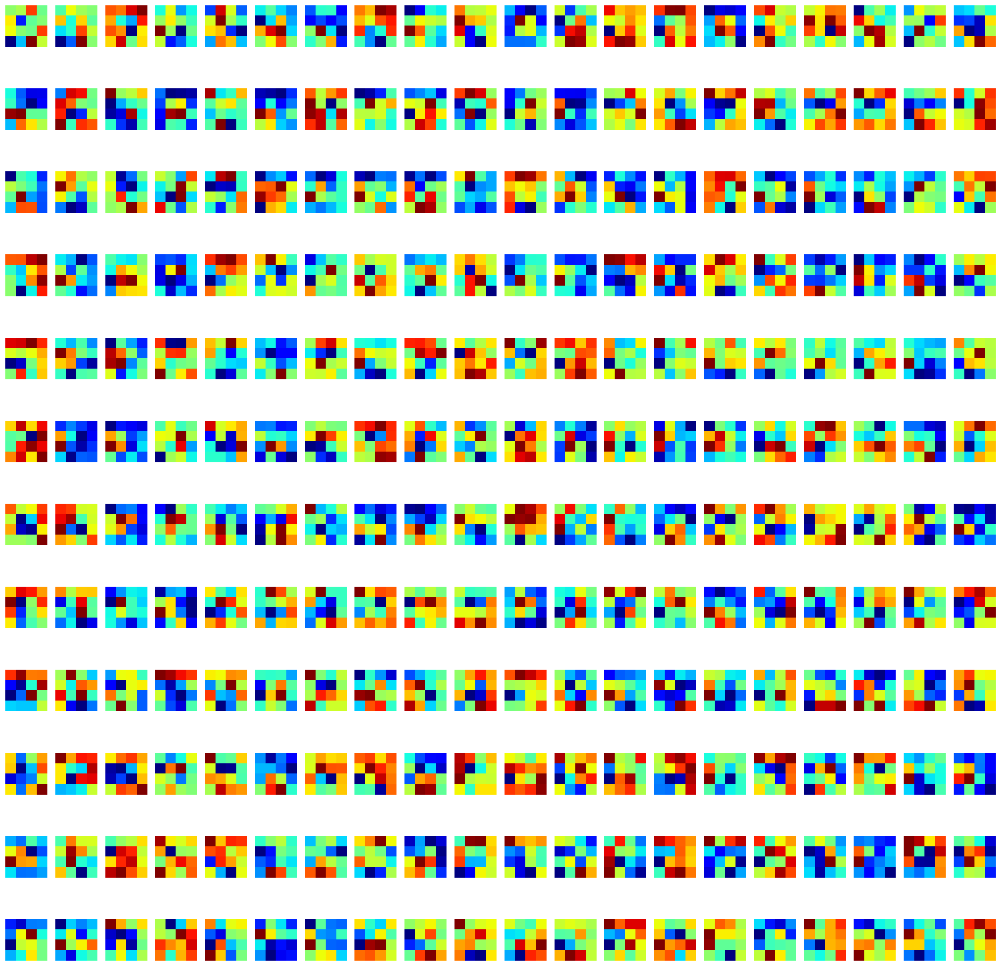

(1, 4, 4, 256)
conv2d_13


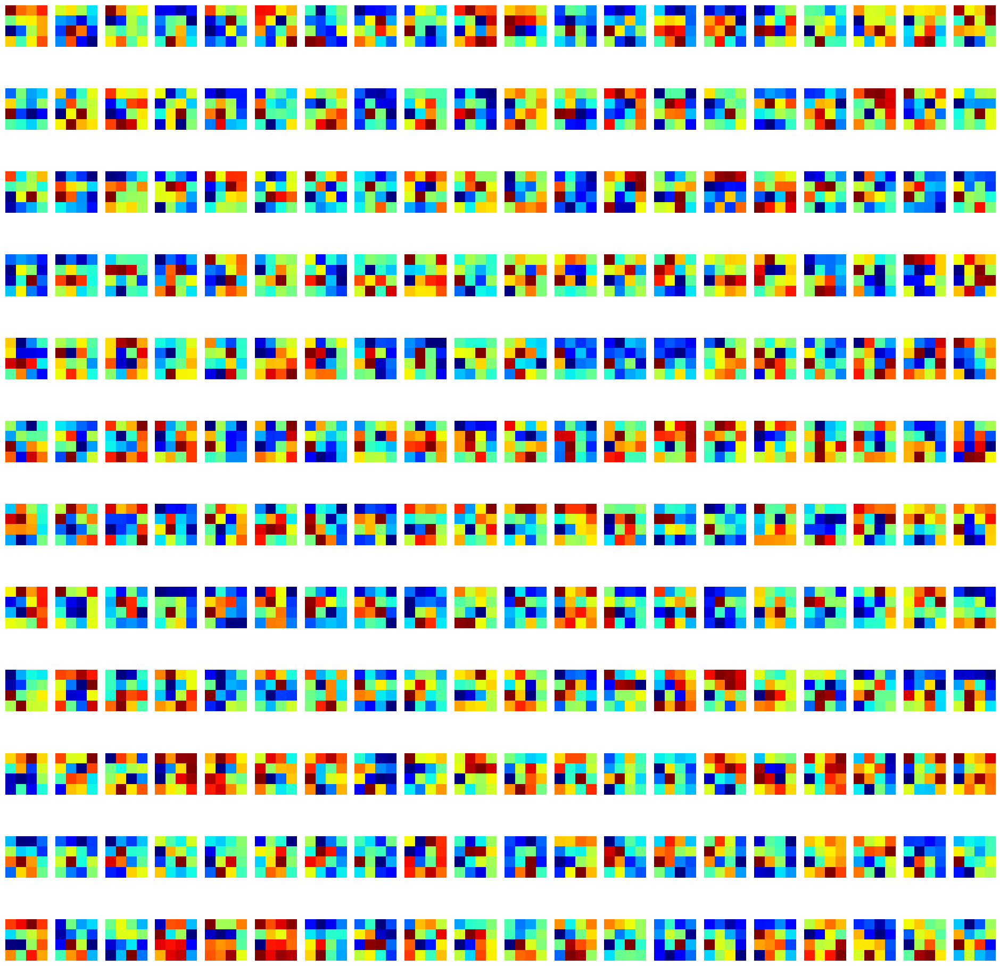

(1, 4, 4, 256)
conv2d_14


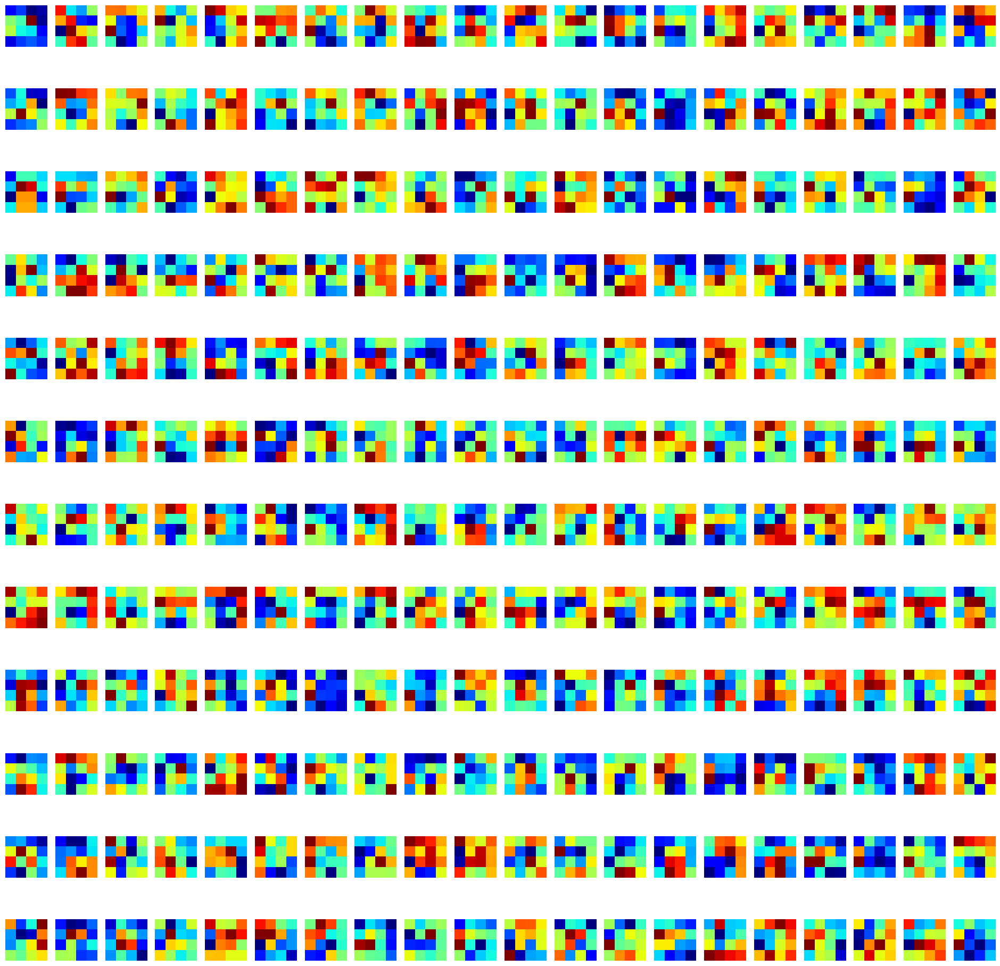

(1, 4, 4, 256)
conv2d_15


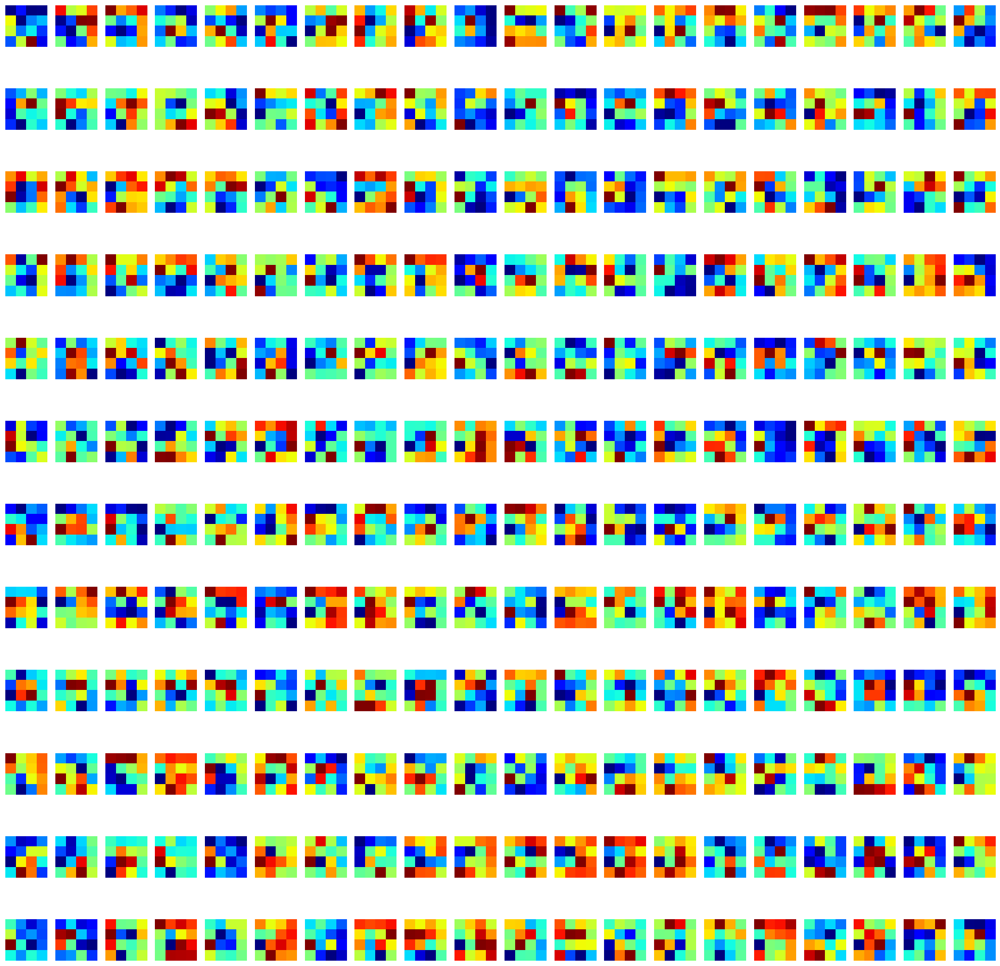

(1, 4, 4, 256)
conv2d_16


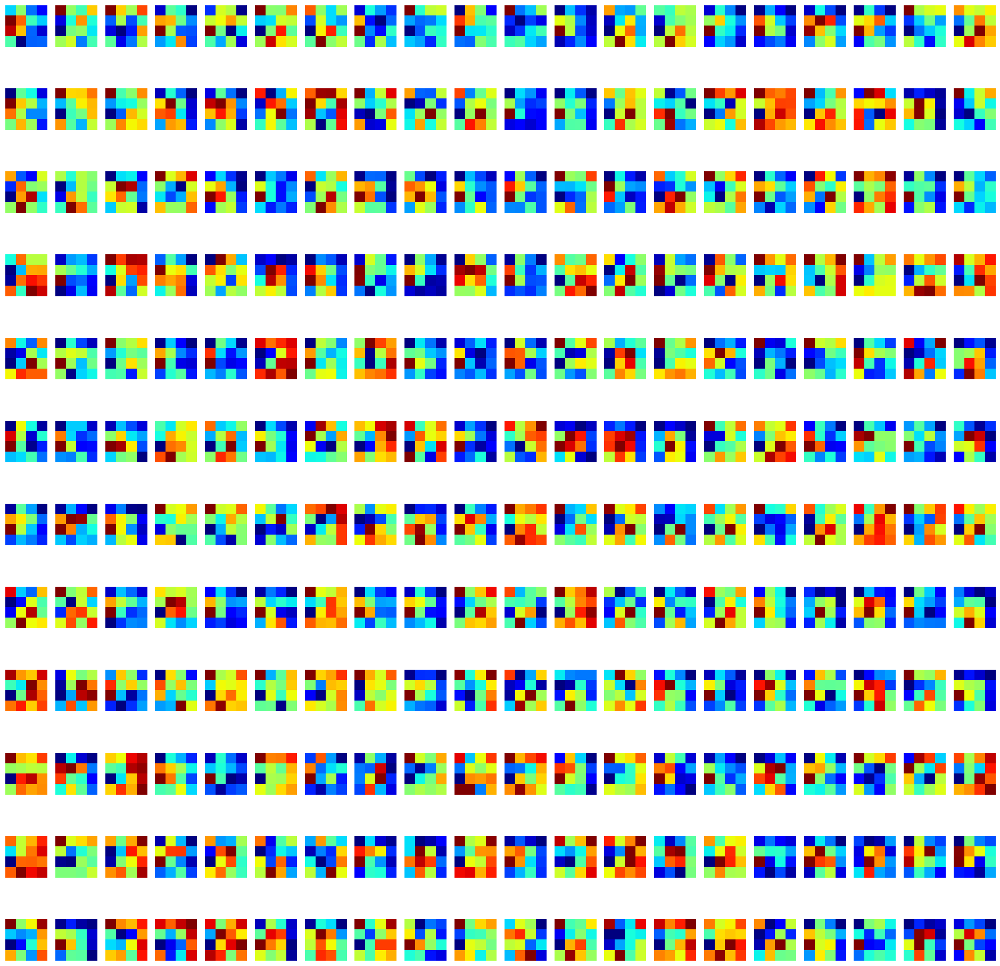

(1, 4, 4, 204)
voting_convolution


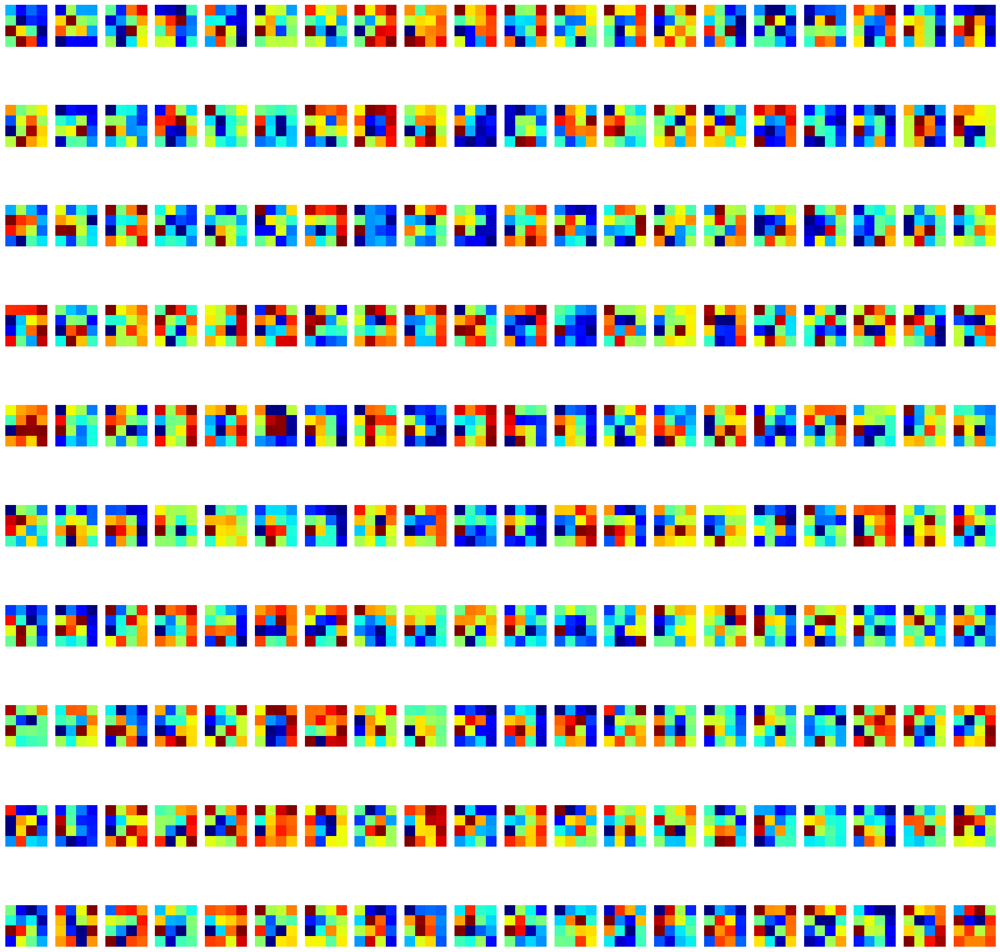

(1, 4, 4, 204)
voting_softmax_target
(1, 4, 4, 256)
feature_convolution


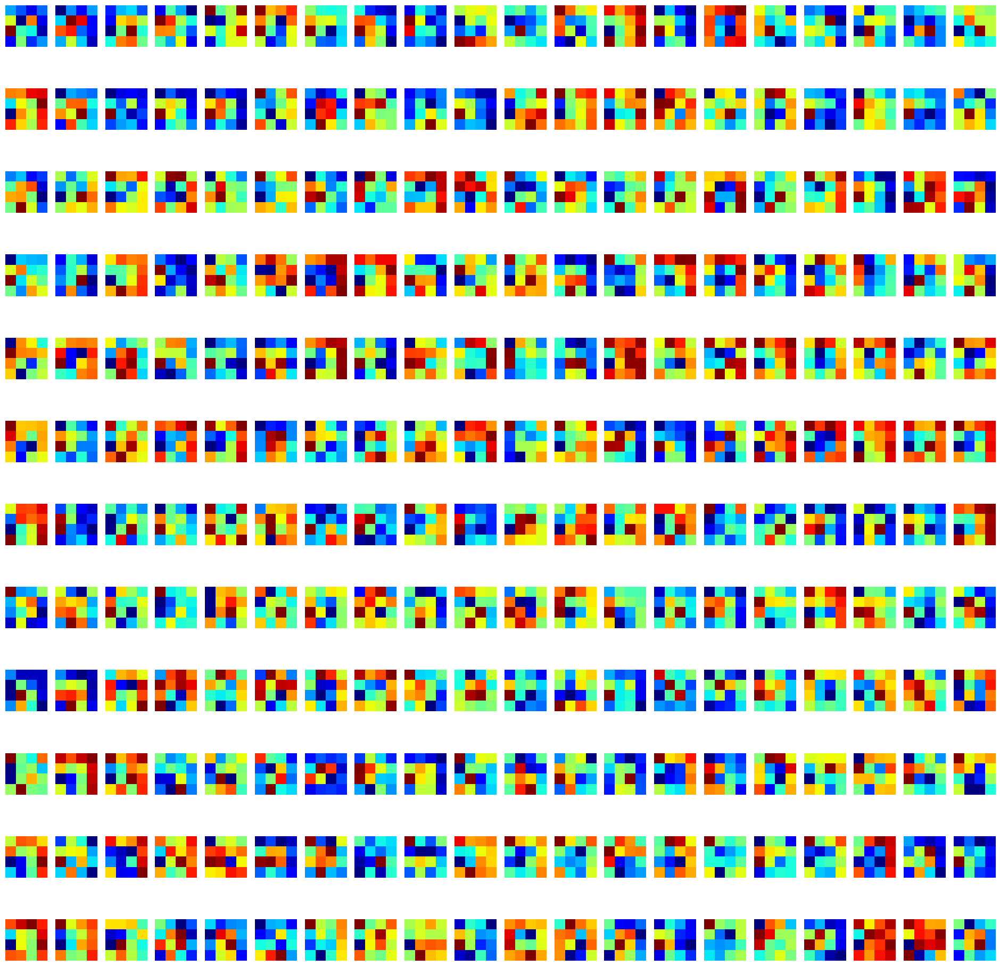

(1, 204, 256)
visual_feat
(1, 204, 256)
visual_feat
(1, 204, 256)
graph_convolution
(1, 204, 256)
evolved_feat
(1, 16, 204, 1)
Ws
(1, 16, 204, 1)
mapping_softmax
(1, 204, 256)
Wsp
(1, 16, 256)
applied_mapping
(1, 32, 32, 256)
conv2d_19


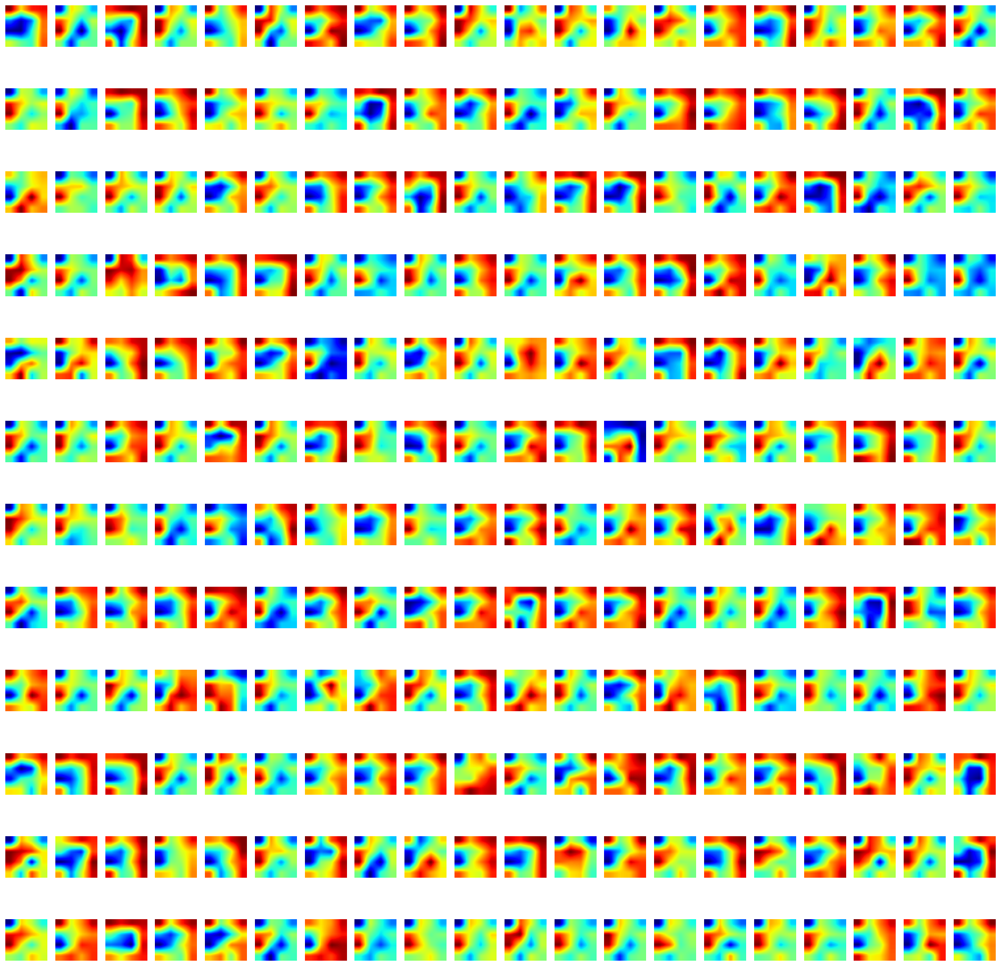

(1, 128, 128, 256)
conv2d_20


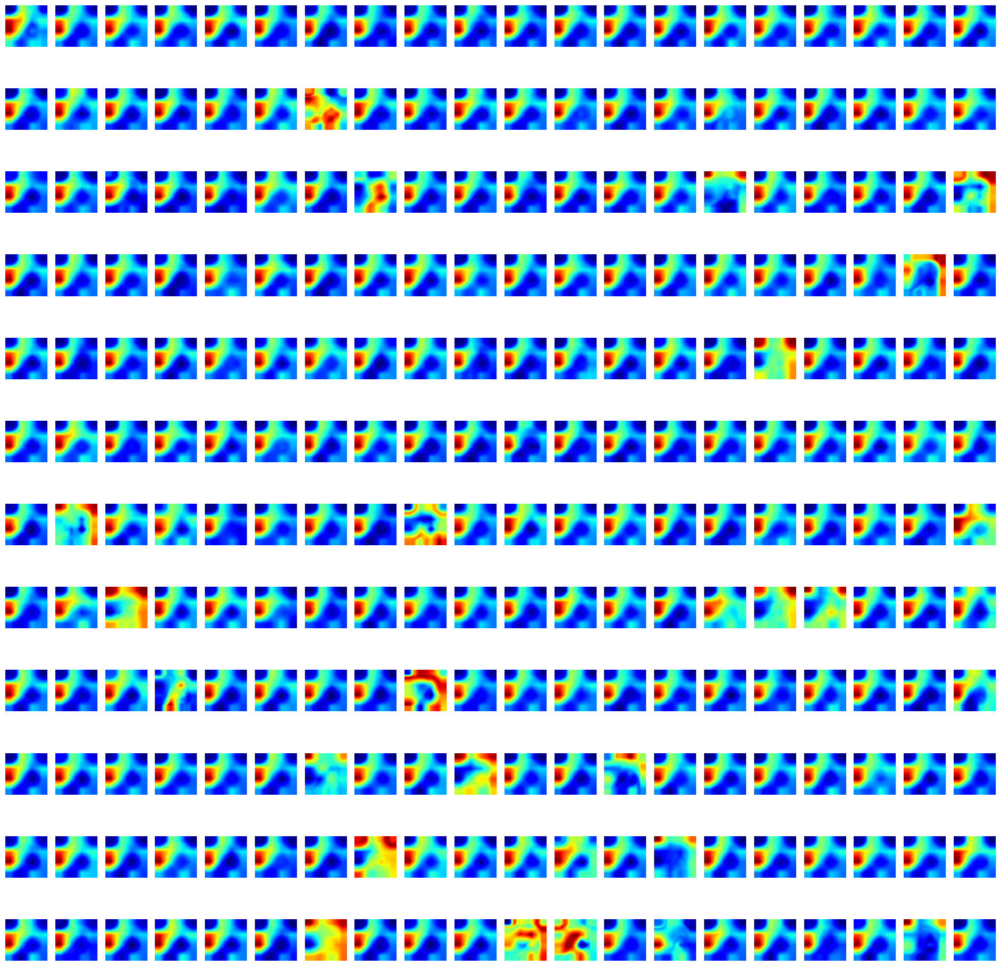

(1, 128, 128, 21)
conv2d_21


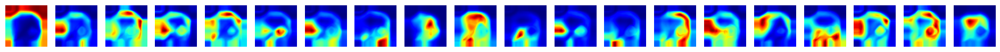

1/1 [==============================] - 0s 316ms/step
20
(1, 1, 1, 256)
conv2d_11


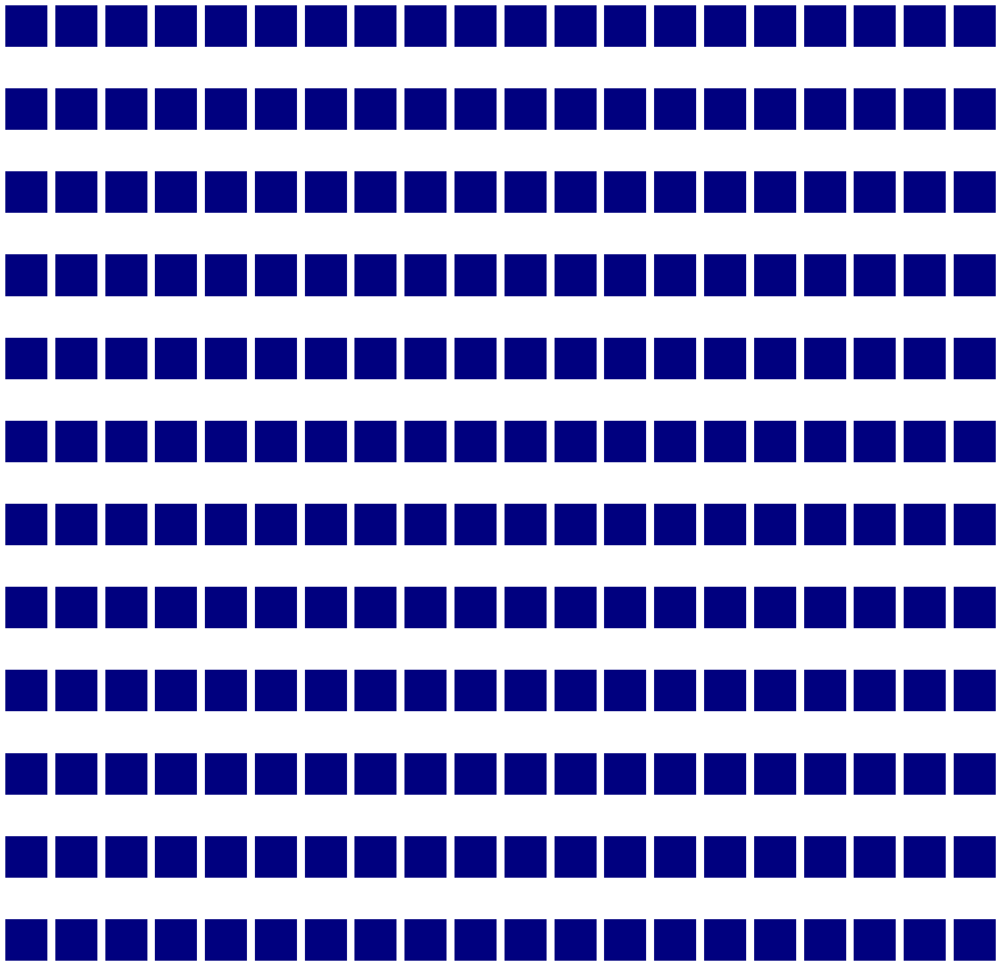

(1, 4, 4, 256)
conv2d_12


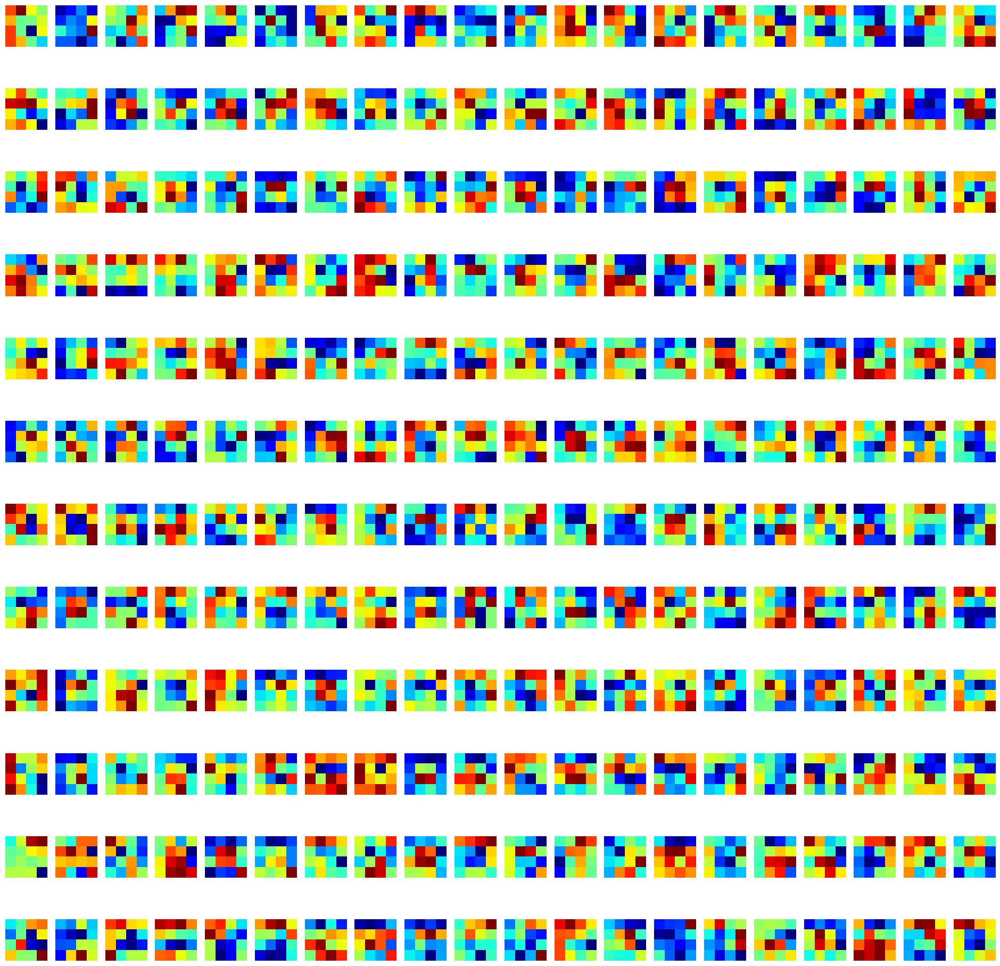

(1, 4, 4, 256)
conv2d_13


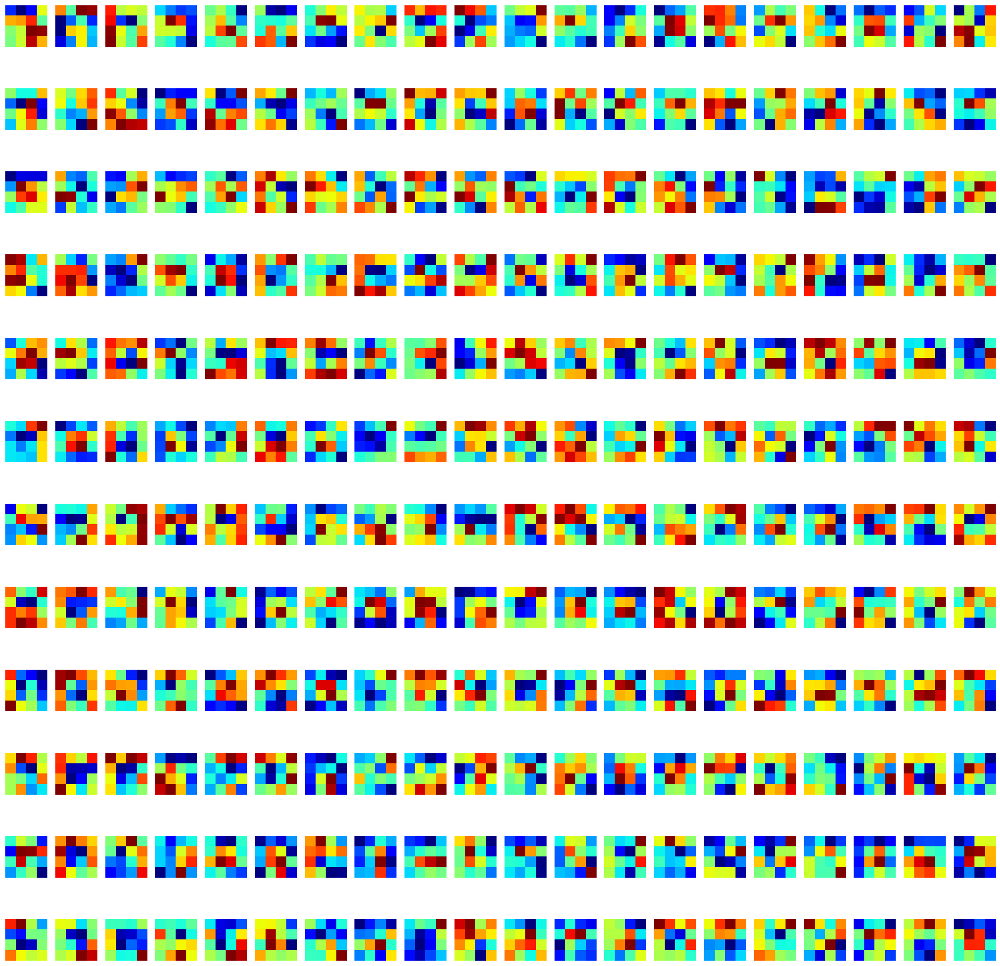

(1, 4, 4, 256)
conv2d_14


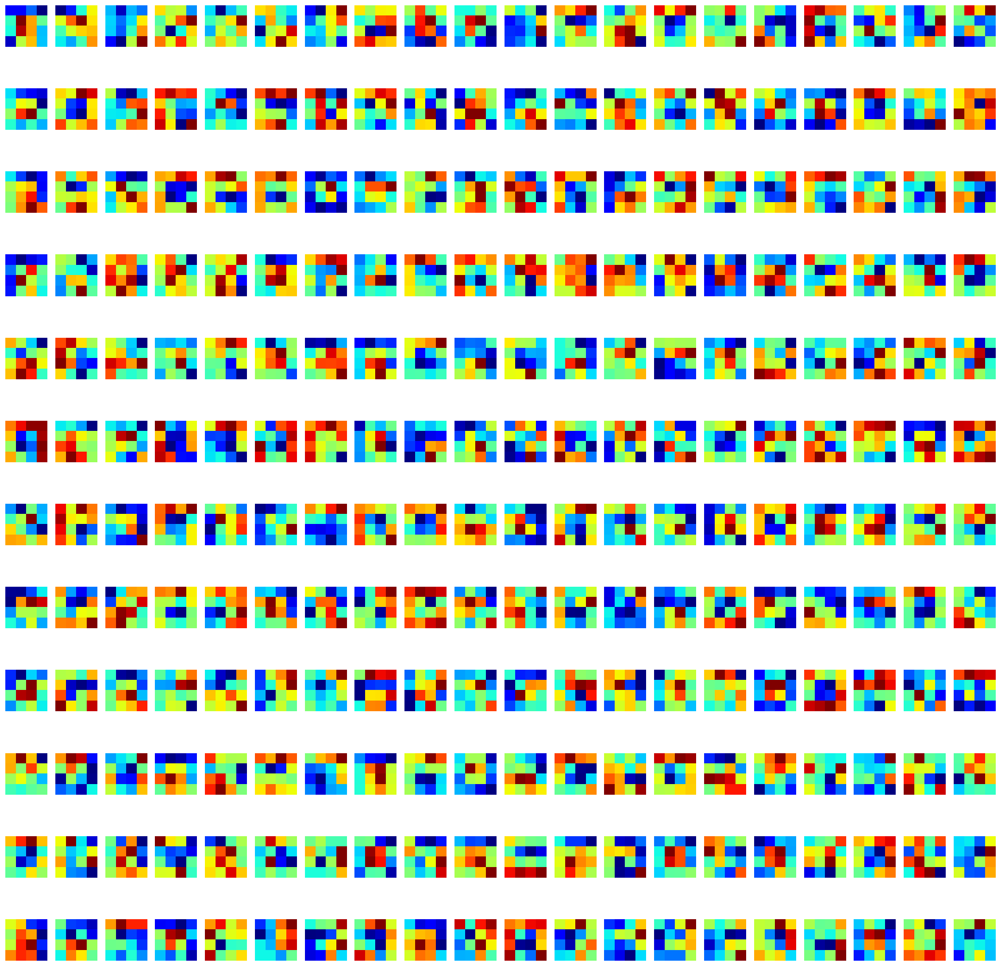

(1, 4, 4, 256)
conv2d_15


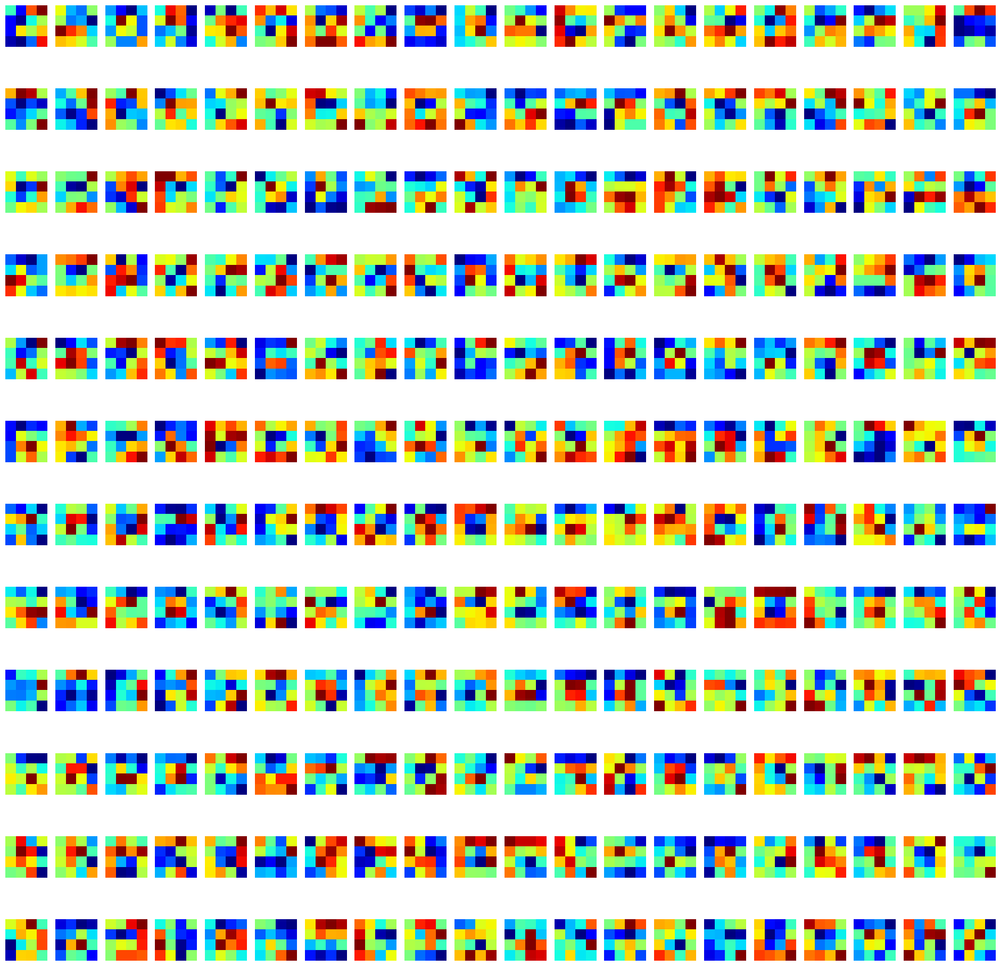

(1, 4, 4, 256)
conv2d_16


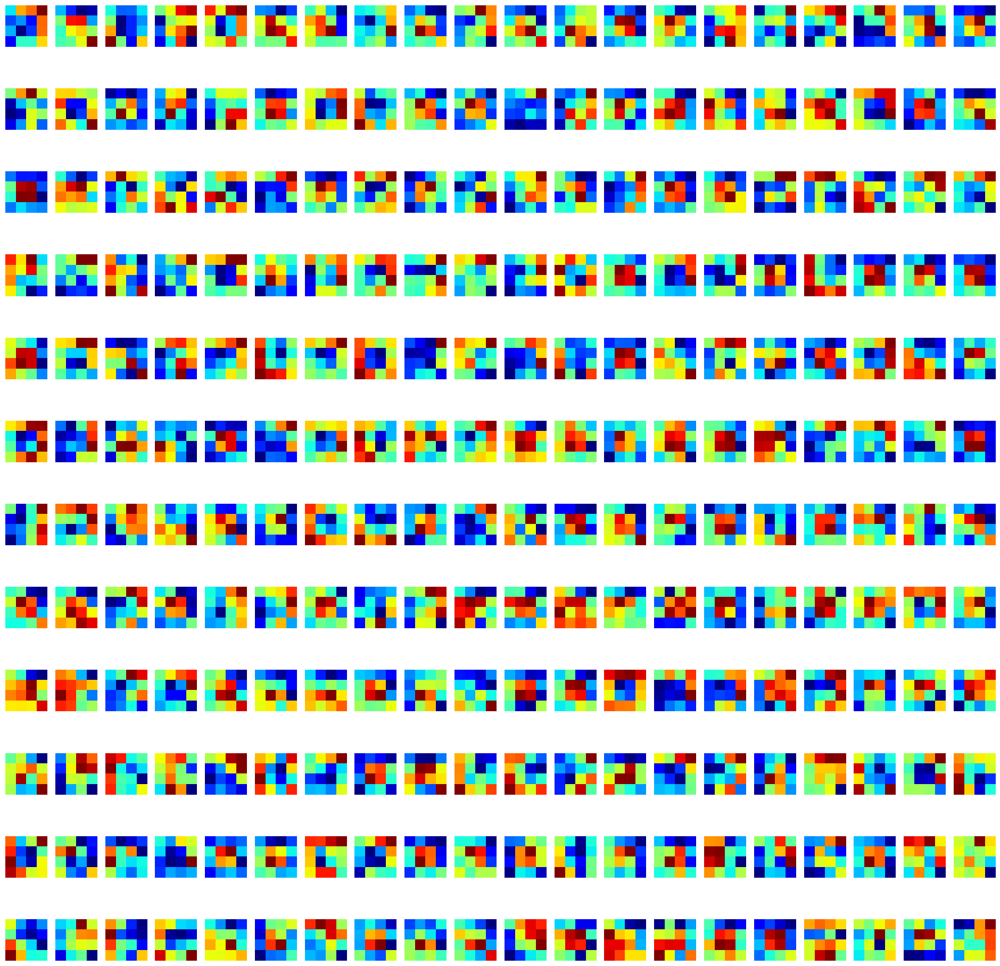

(1, 4, 4, 204)
voting_convolution


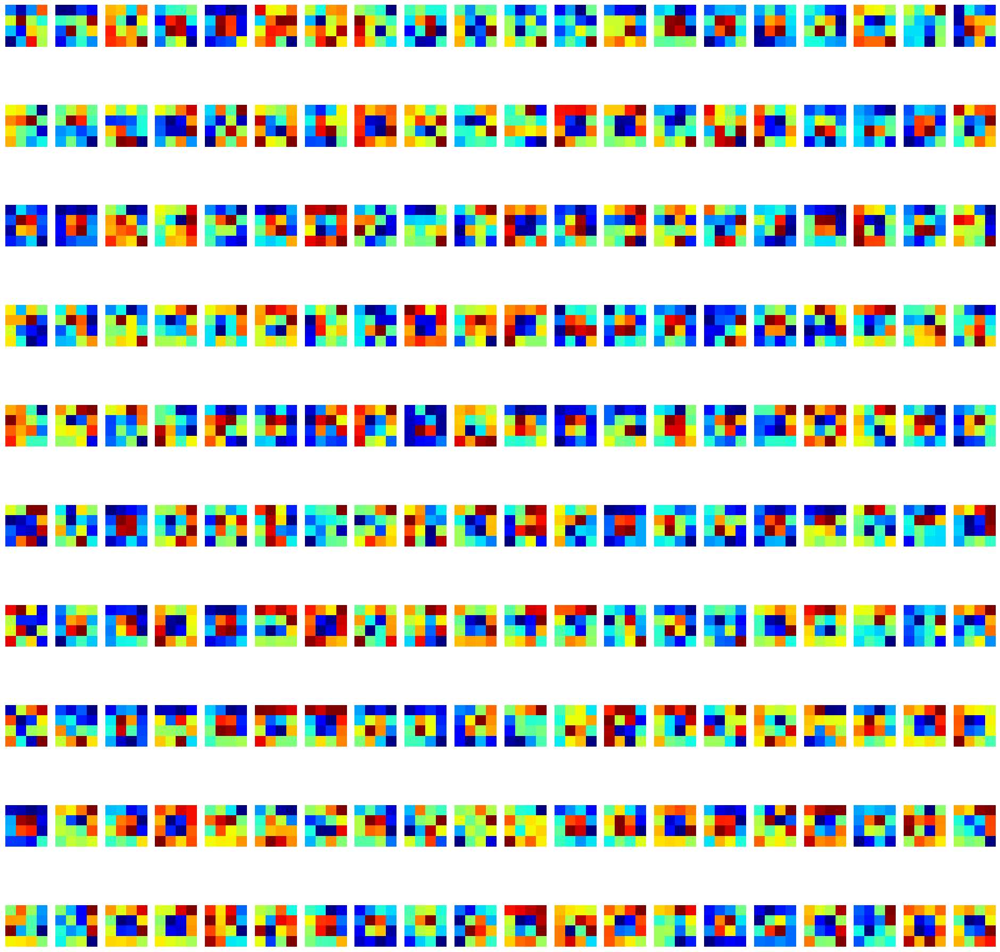

(1, 4, 4, 204)
voting_softmax_target
(1, 4, 4, 256)
feature_convolution


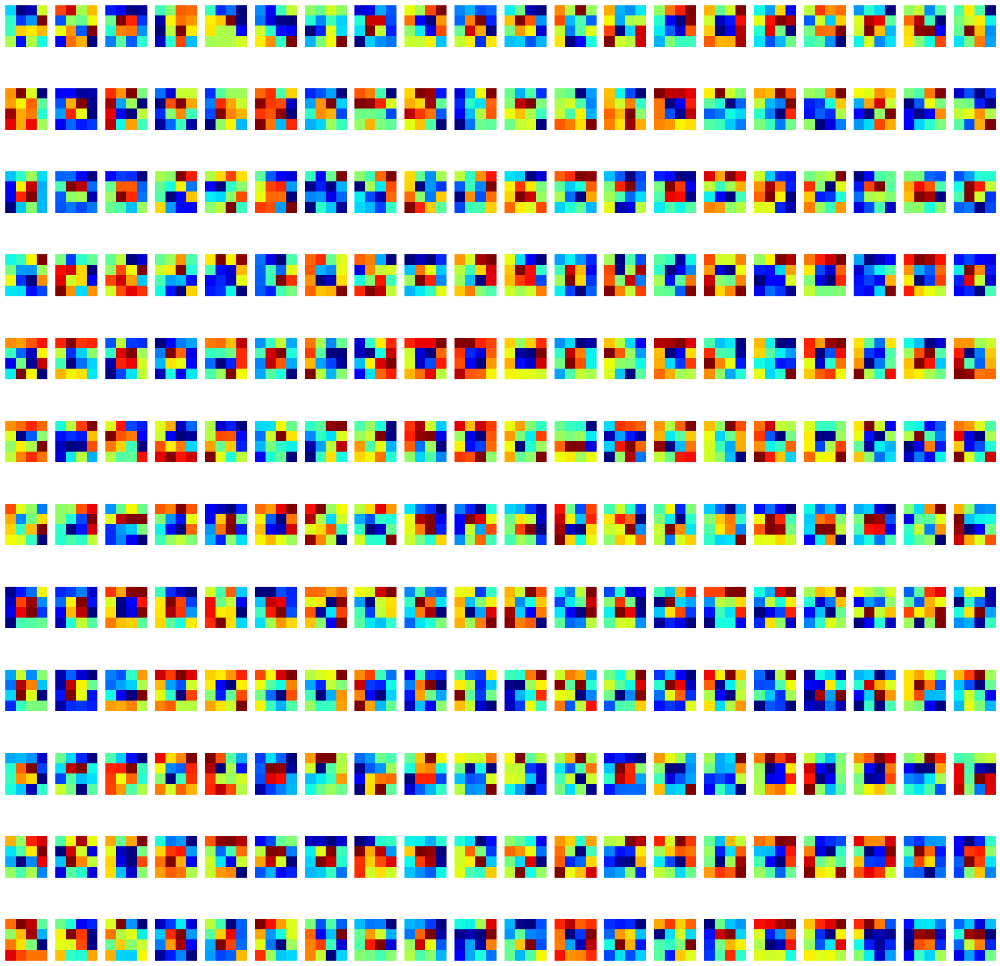

(1, 204, 256)
visual_feat
(1, 204, 256)
visual_feat
(1, 204, 256)
graph_convolution
(1, 204, 256)
evolved_feat
(1, 16, 204, 1)
Ws
(1, 16, 204, 1)
mapping_softmax
(1, 204, 256)
Wsp
(1, 16, 256)
applied_mapping
(1, 32, 32, 256)
conv2d_19


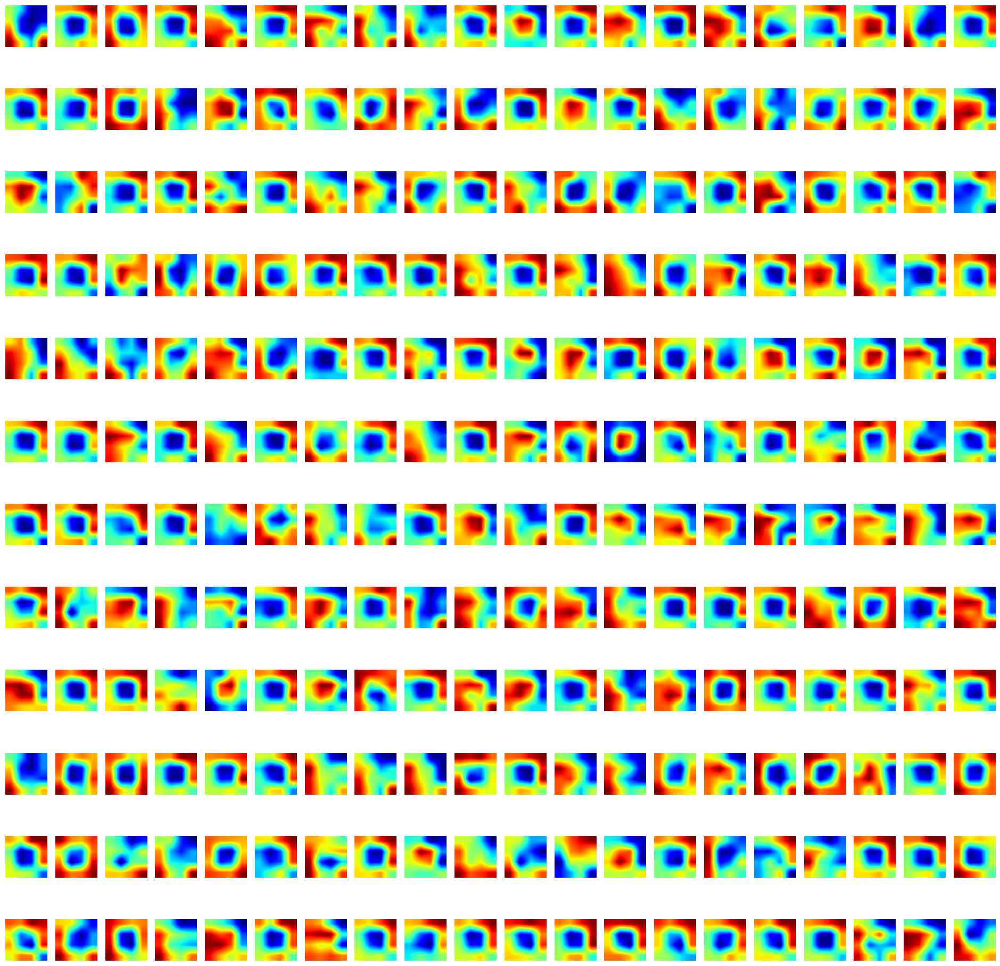

(1, 128, 128, 256)
conv2d_20


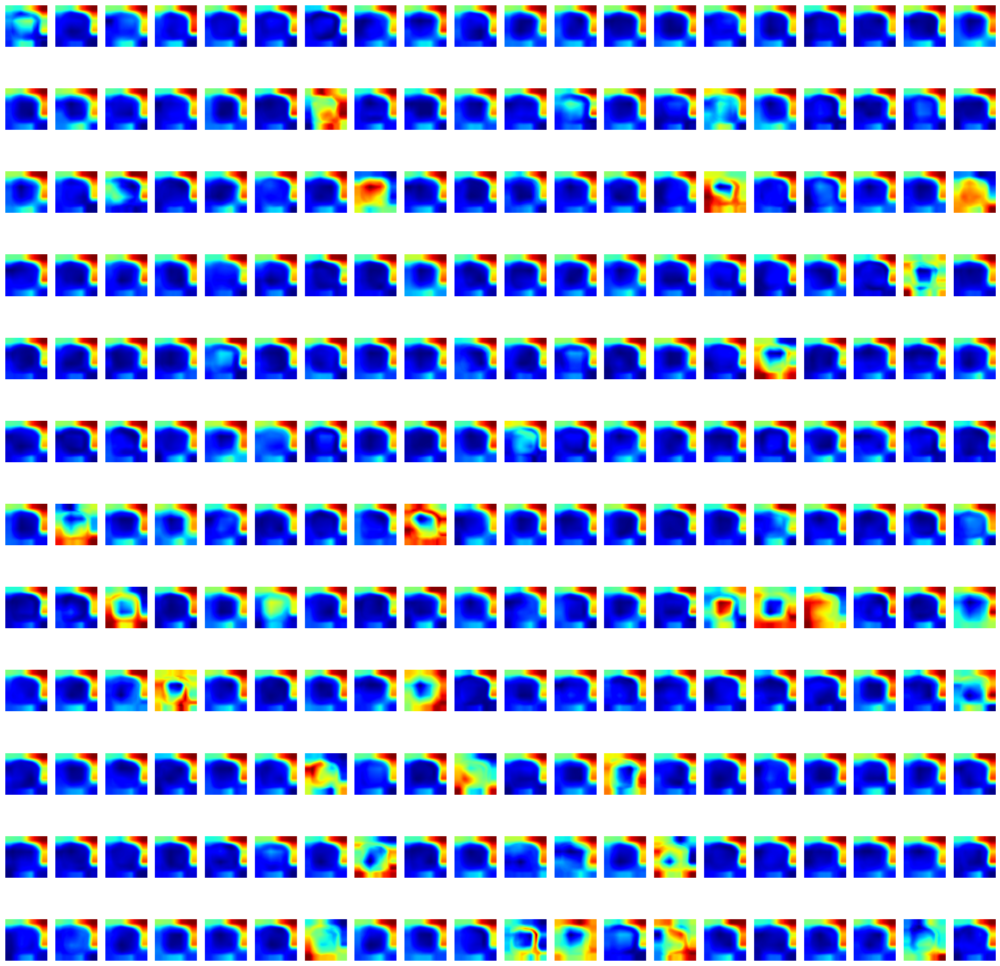

(1, 128, 128, 21)
conv2d_21


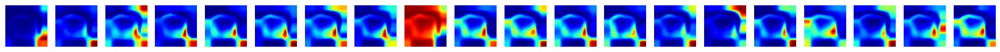

1/1 [==============================] - 0s 316ms/step
20
(1, 1, 1, 256)
conv2d_11


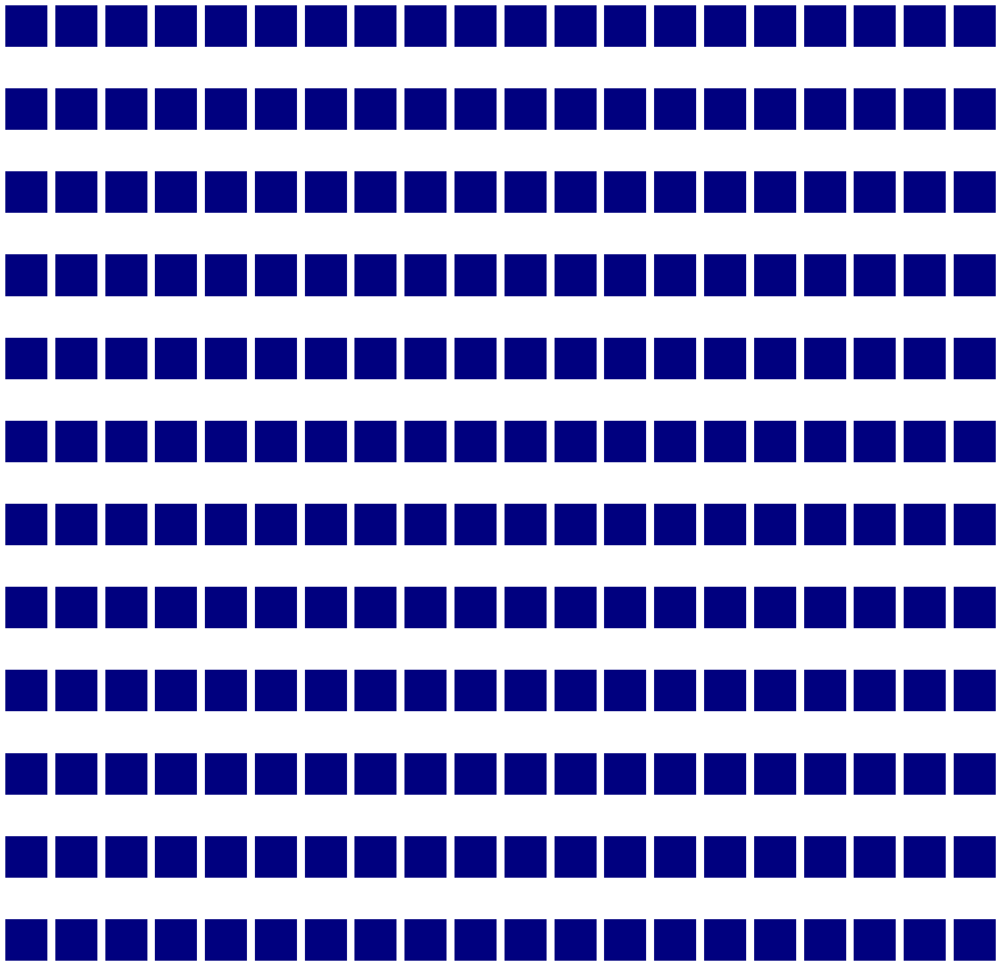

(1, 4, 4, 256)
conv2d_12


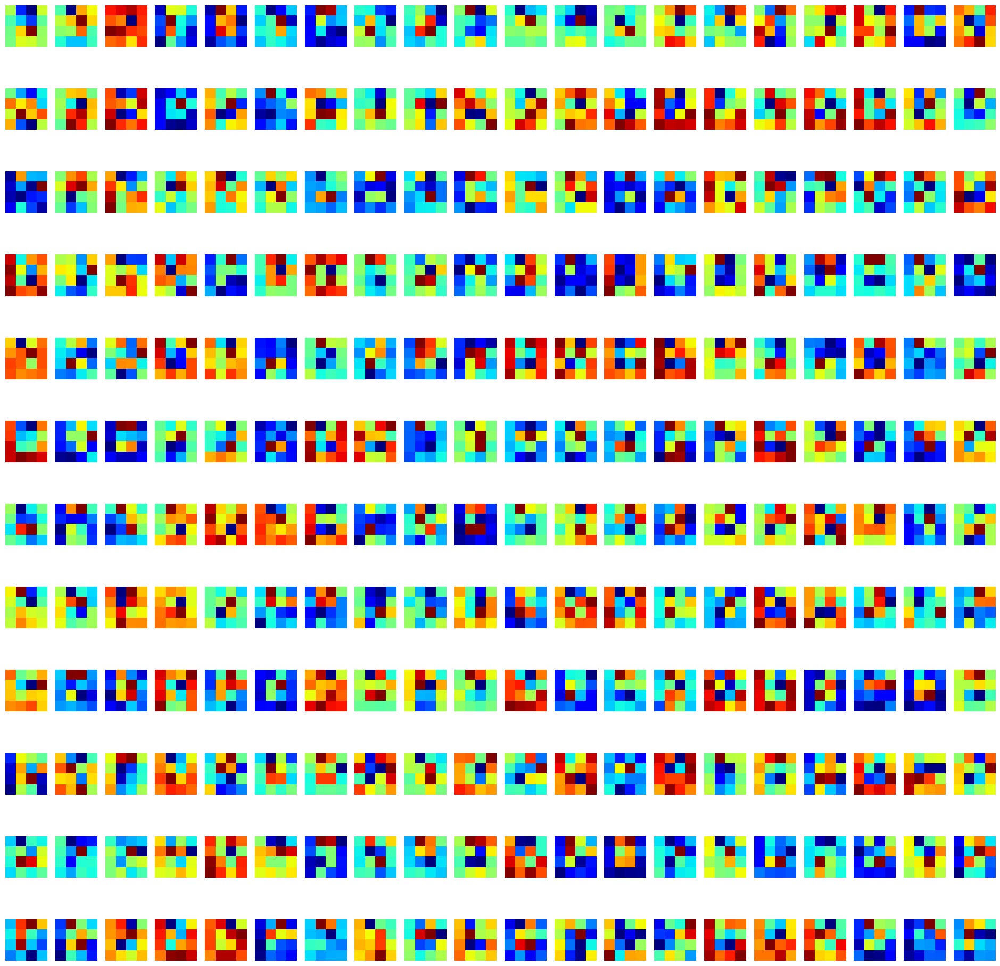

(1, 4, 4, 256)
conv2d_13


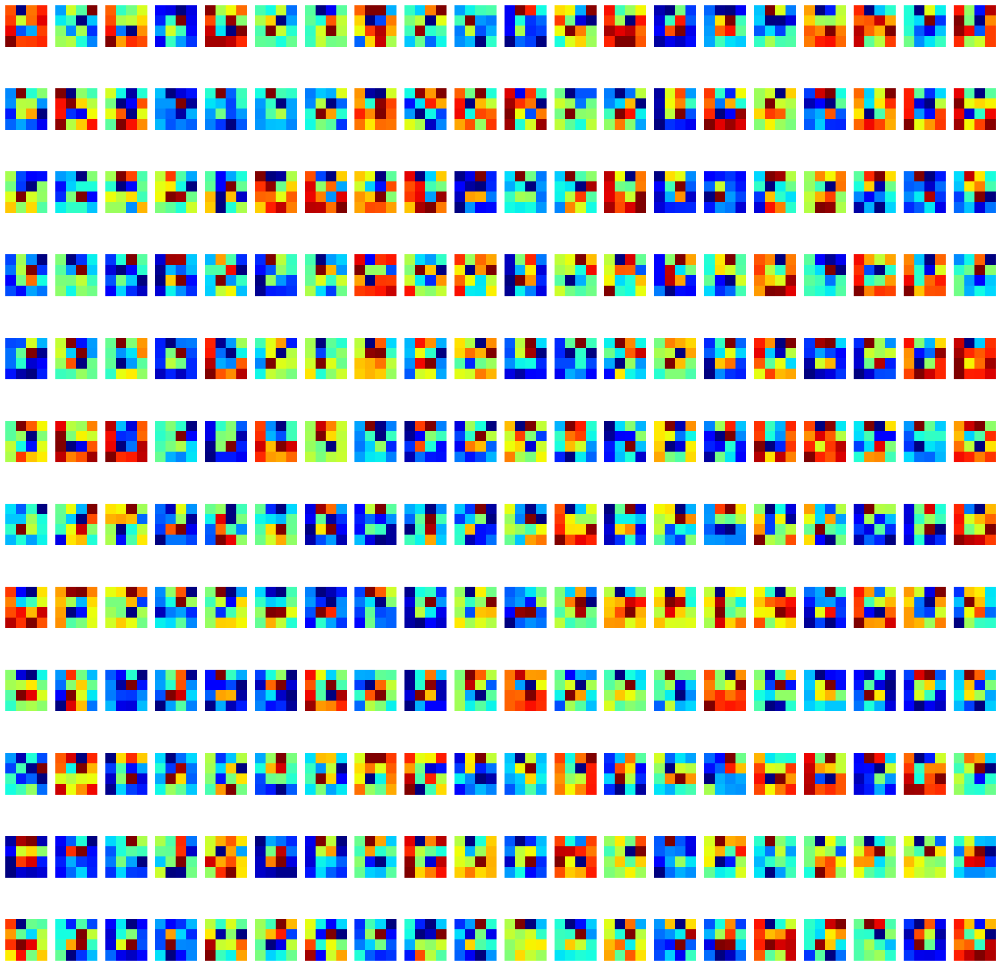

(1, 4, 4, 256)
conv2d_14


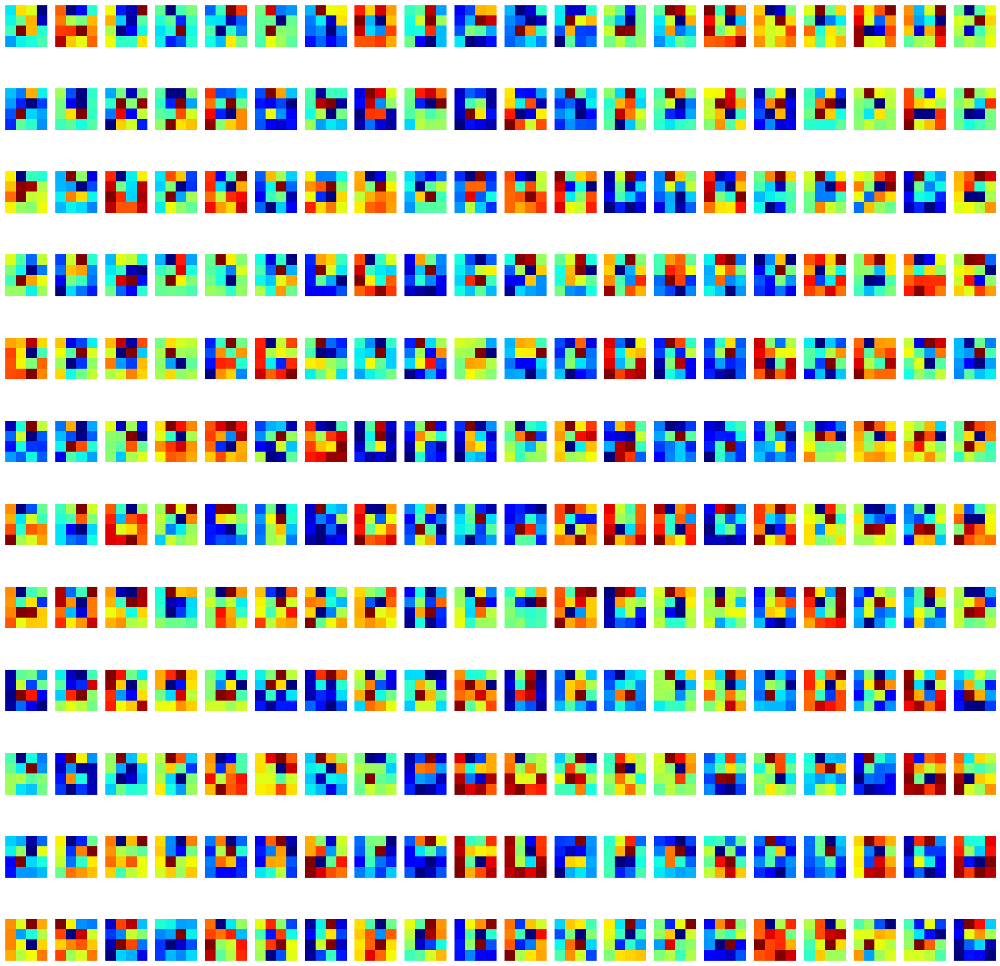

(1, 4, 4, 256)
conv2d_15


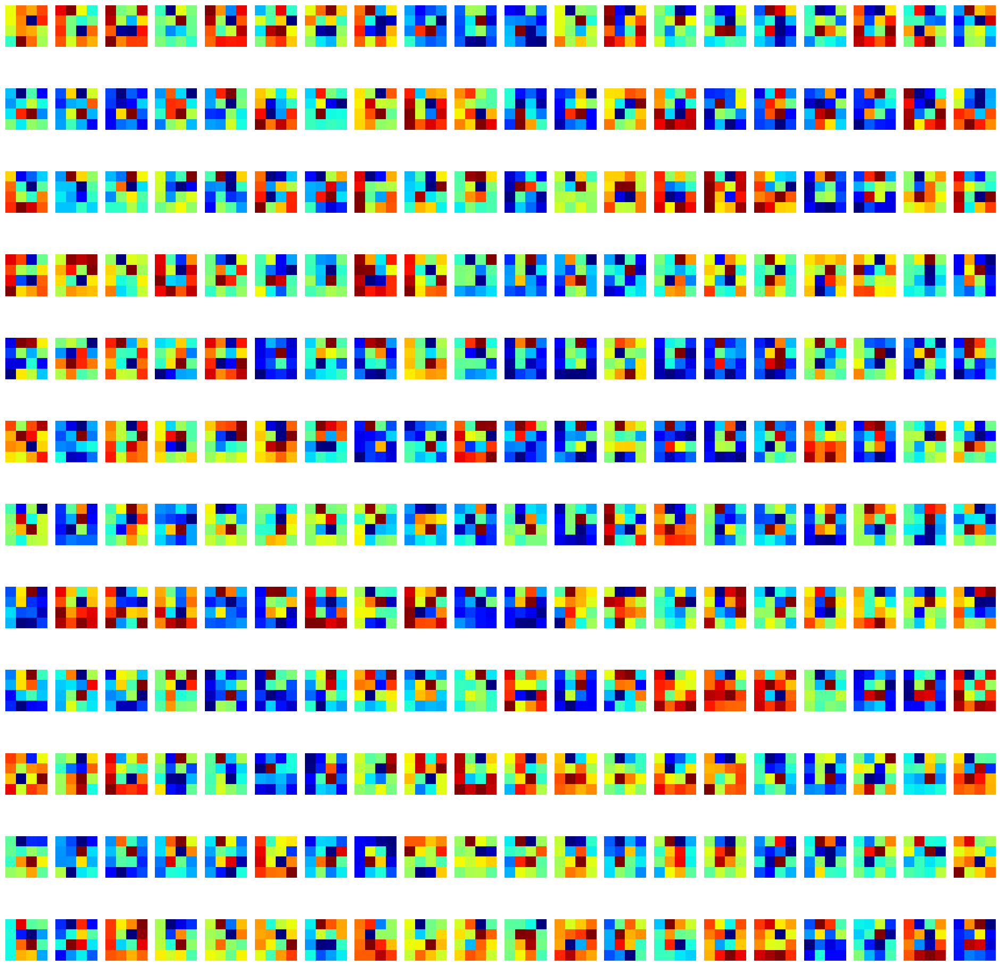

(1, 4, 4, 256)
conv2d_16


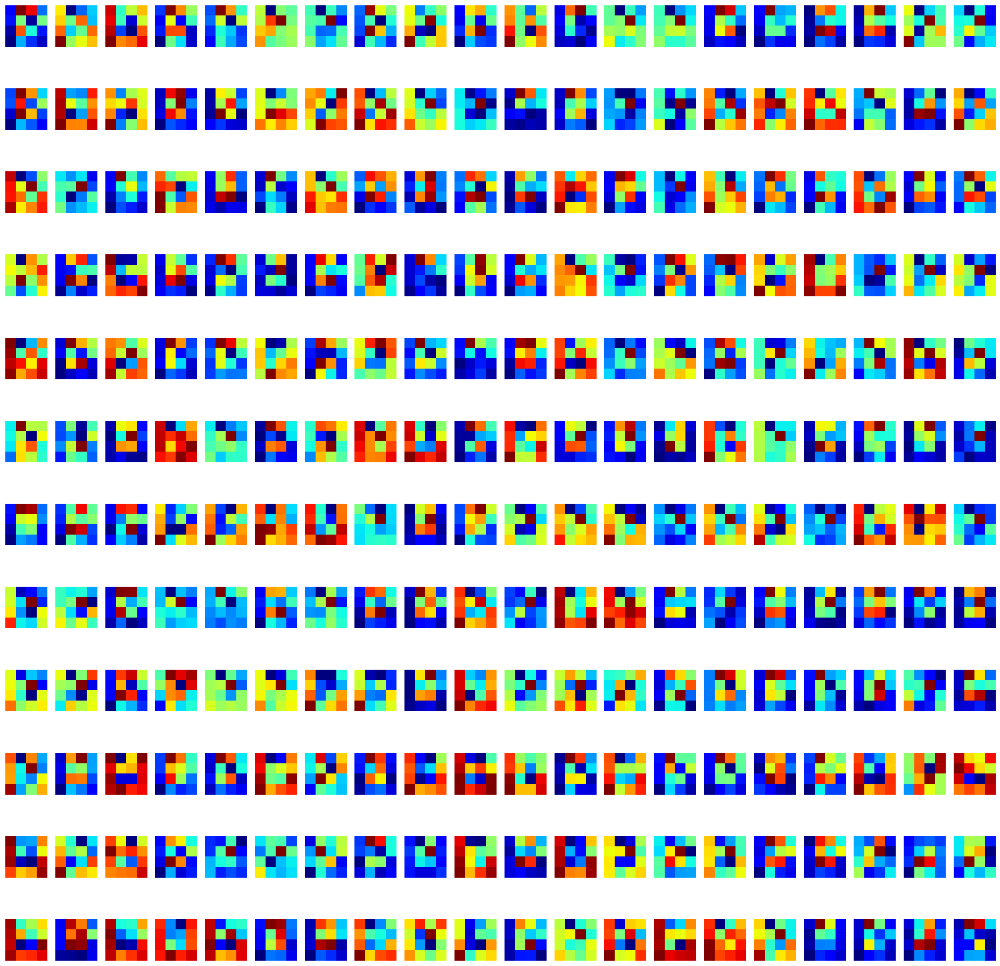

(1, 4, 4, 204)
voting_convolution


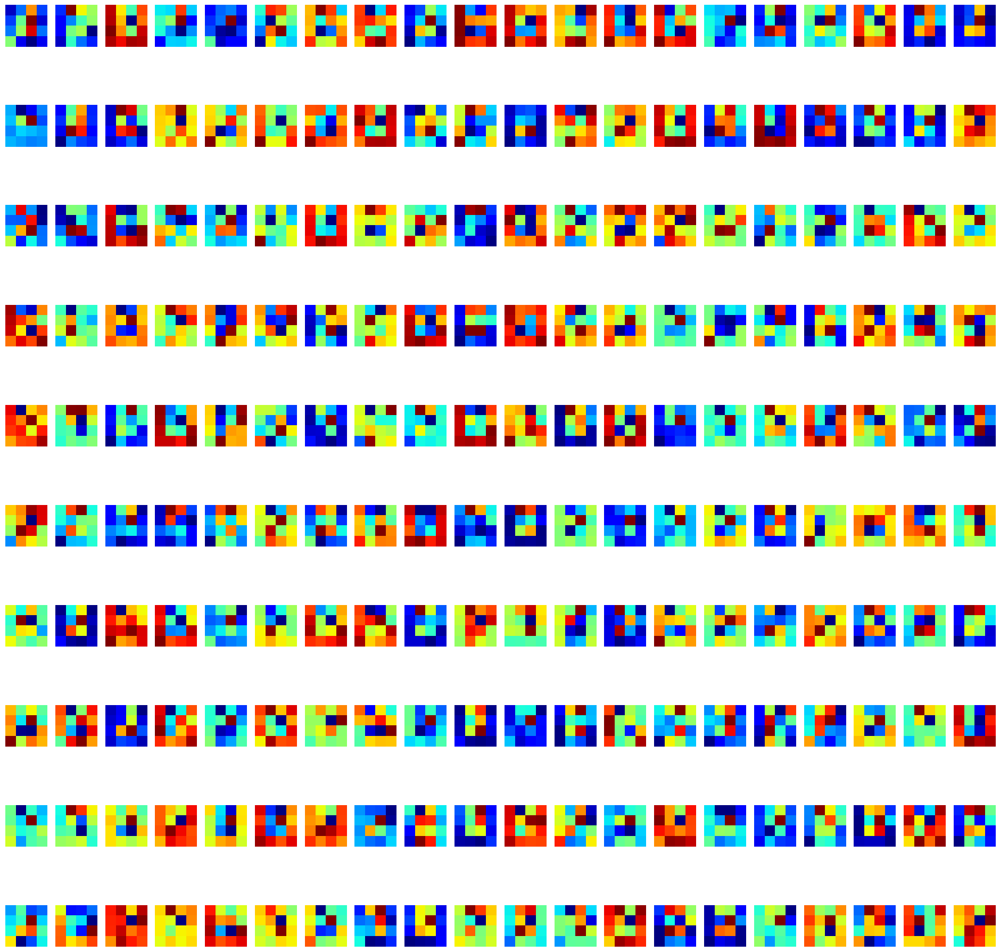

(1, 4, 4, 204)
voting_softmax_target
(1, 4, 4, 256)
feature_convolution


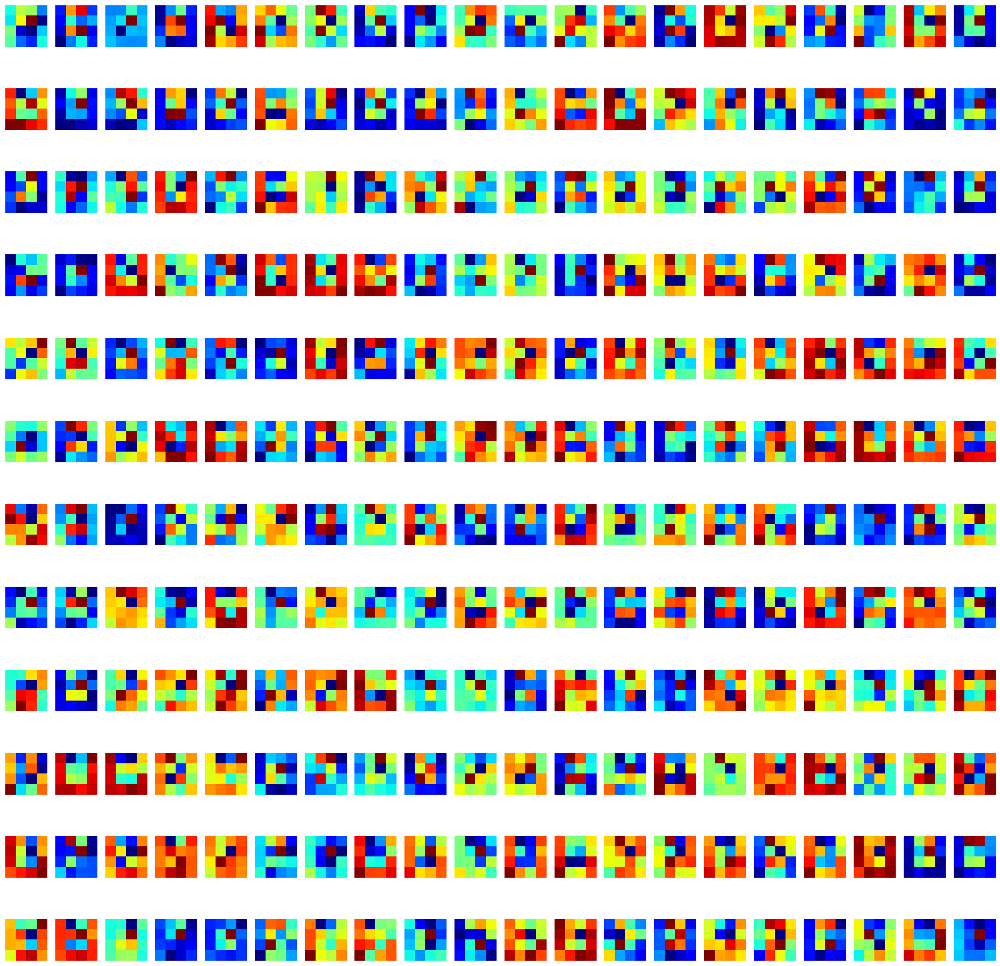

(1, 204, 256)
visual_feat
(1, 204, 256)
visual_feat
(1, 204, 256)
graph_convolution
(1, 204, 256)
evolved_feat
(1, 16, 204, 1)
Ws
(1, 16, 204, 1)
mapping_softmax
(1, 204, 256)
Wsp
(1, 16, 256)
applied_mapping
(1, 32, 32, 256)
conv2d_19


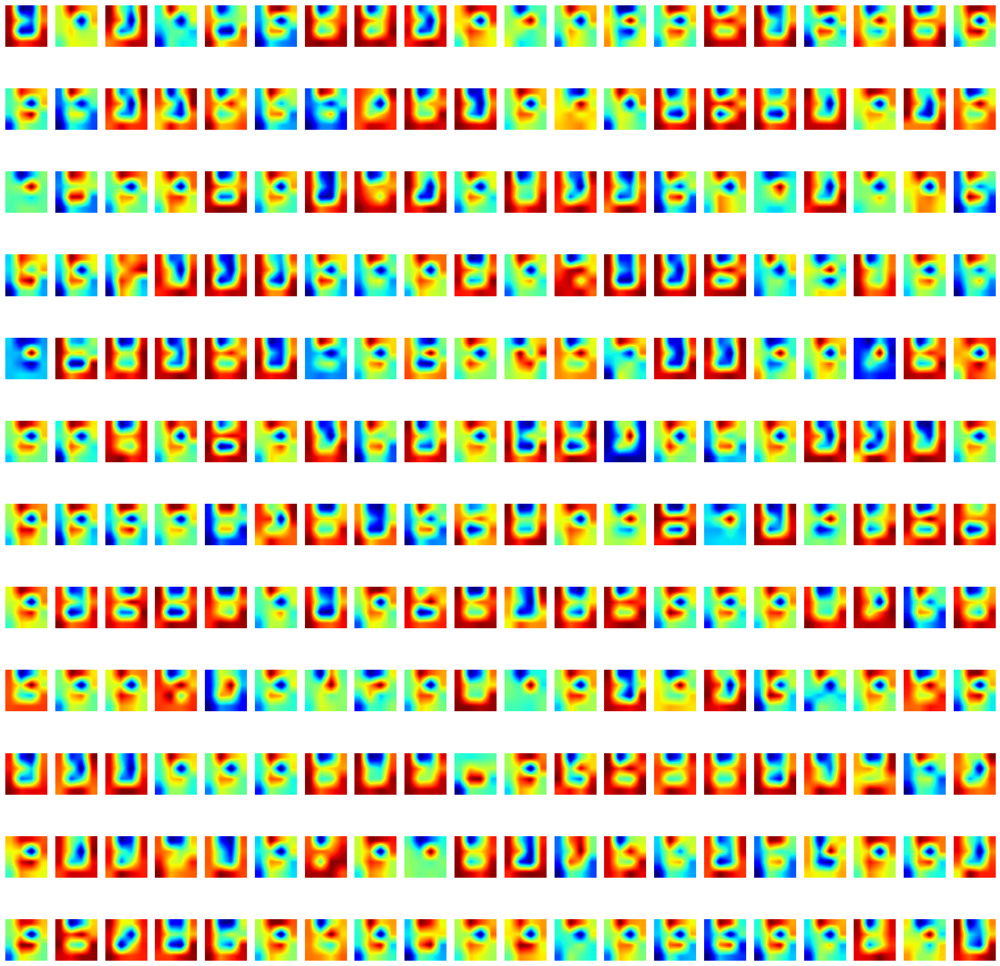

(1, 128, 128, 256)
conv2d_20


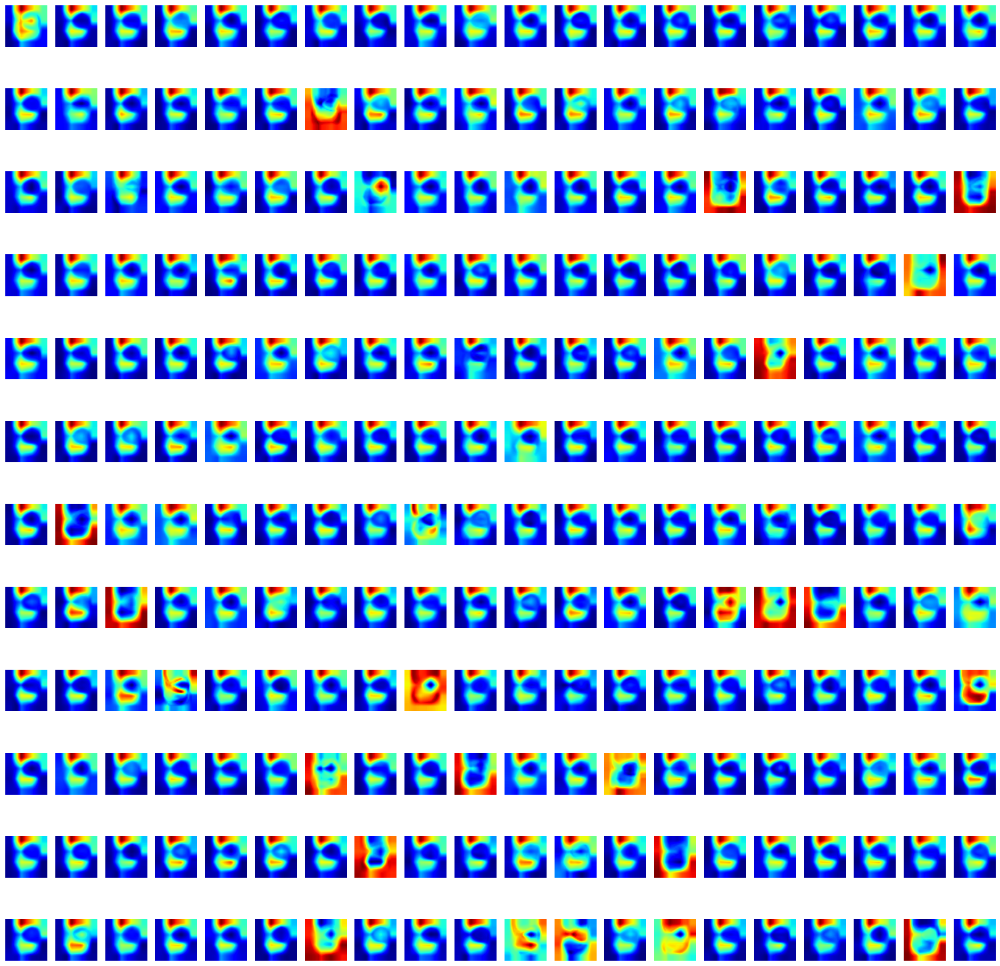

(1, 128, 128, 21)
conv2d_21


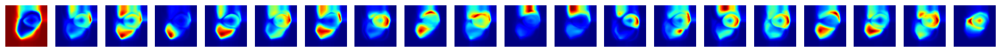

1/1 [==============================] - 0s 313ms/step
20
(1, 1, 1, 256)
conv2d_11


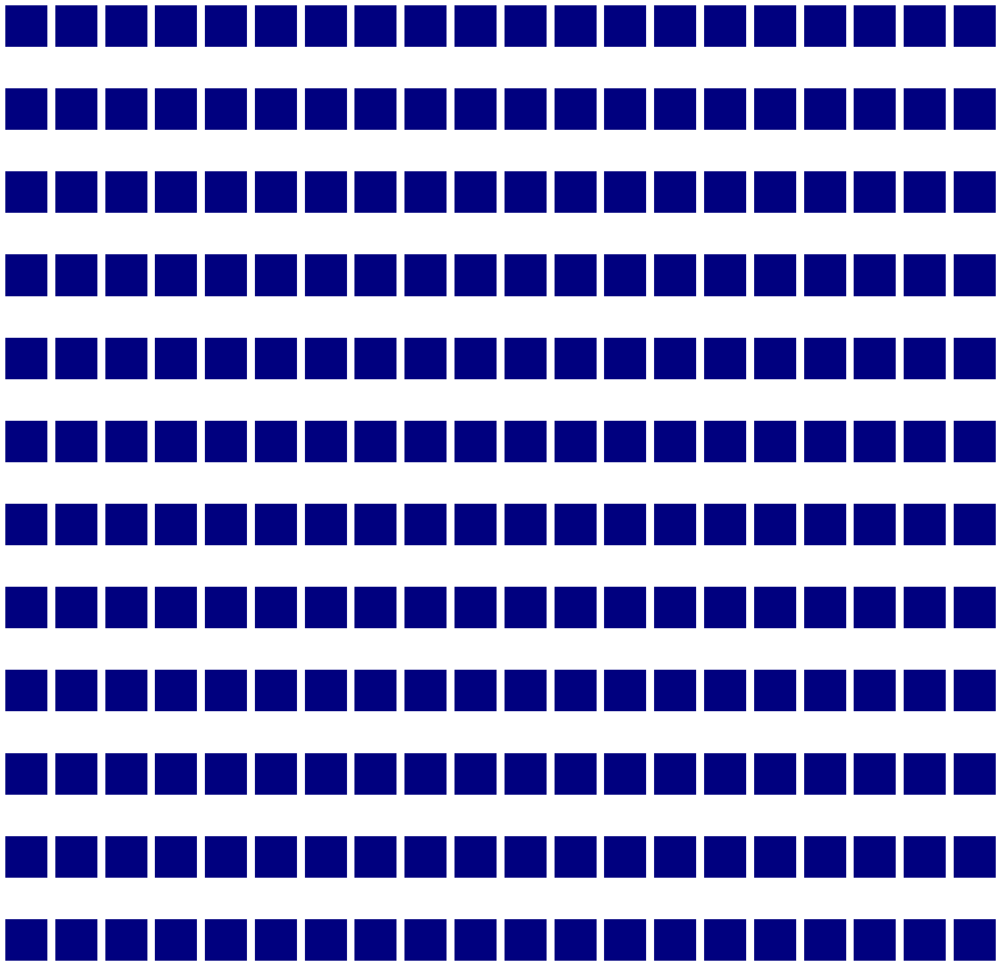

(1, 4, 4, 256)
conv2d_12


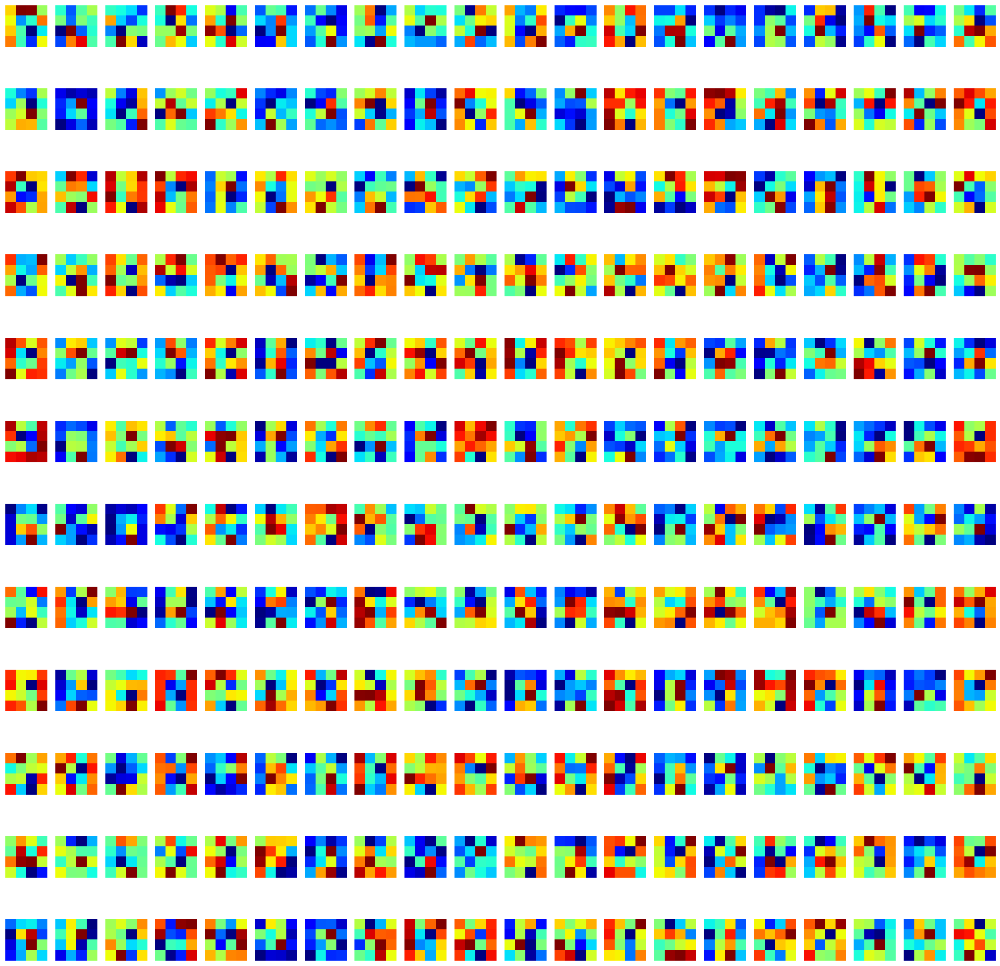

(1, 4, 4, 256)
conv2d_13


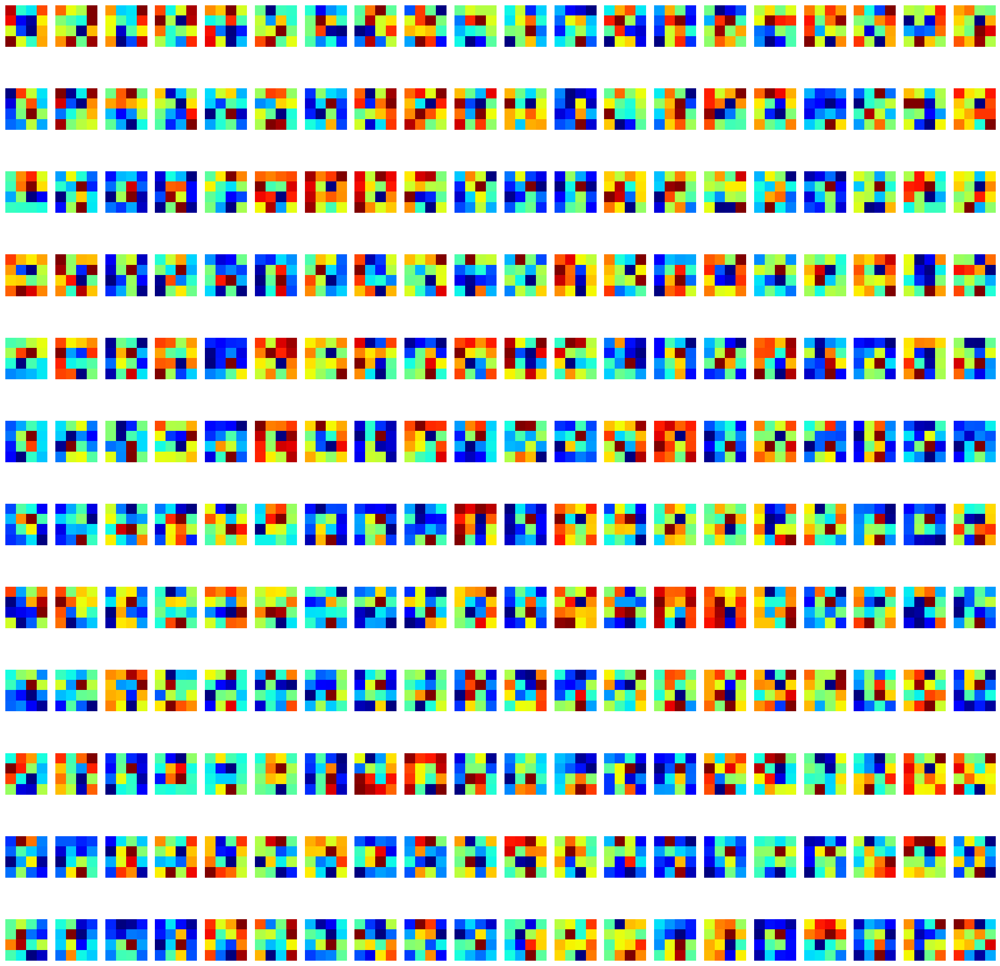

(1, 4, 4, 256)
conv2d_14


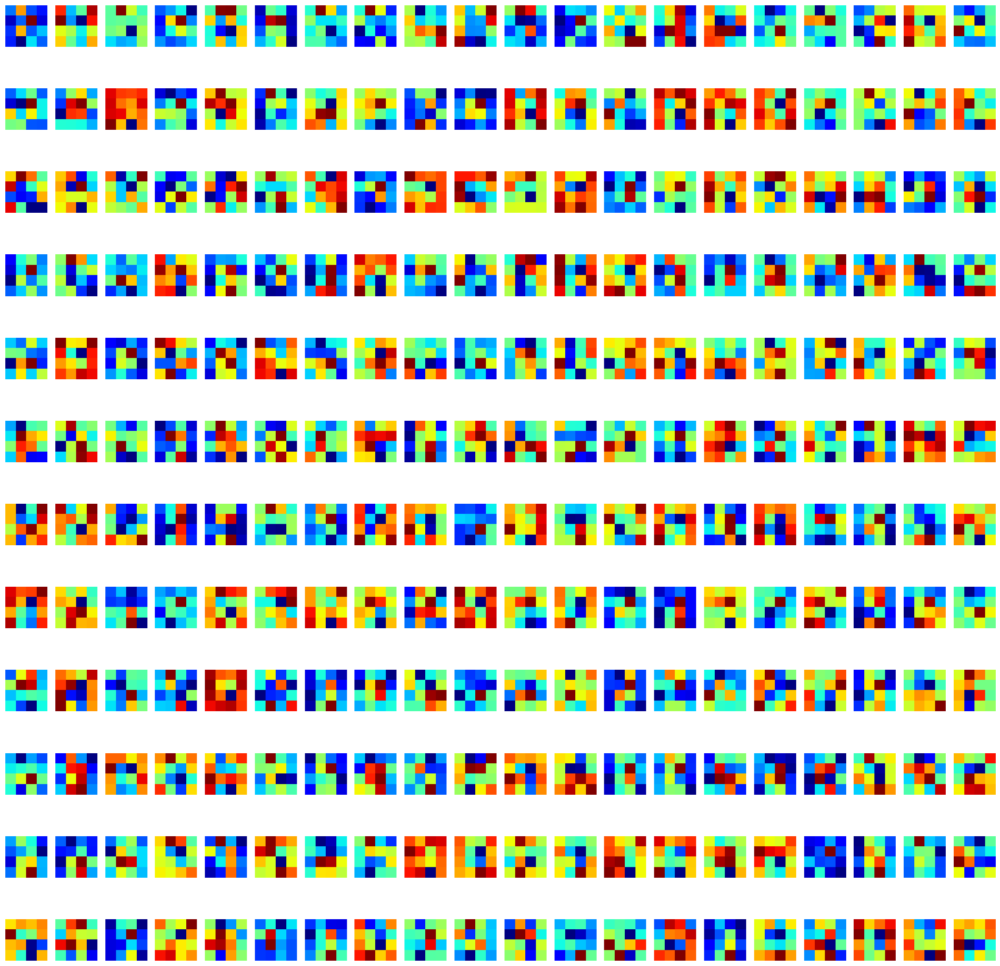

(1, 4, 4, 256)
conv2d_15


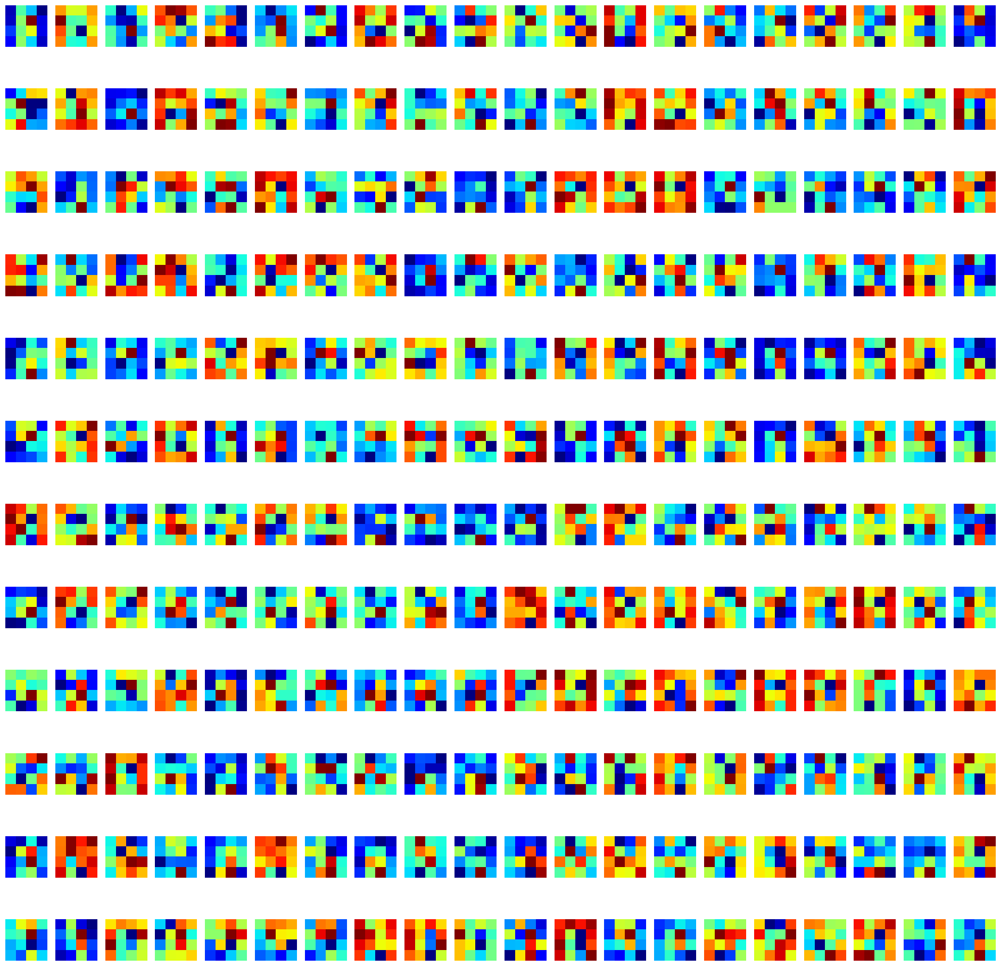

(1, 4, 4, 256)
conv2d_16


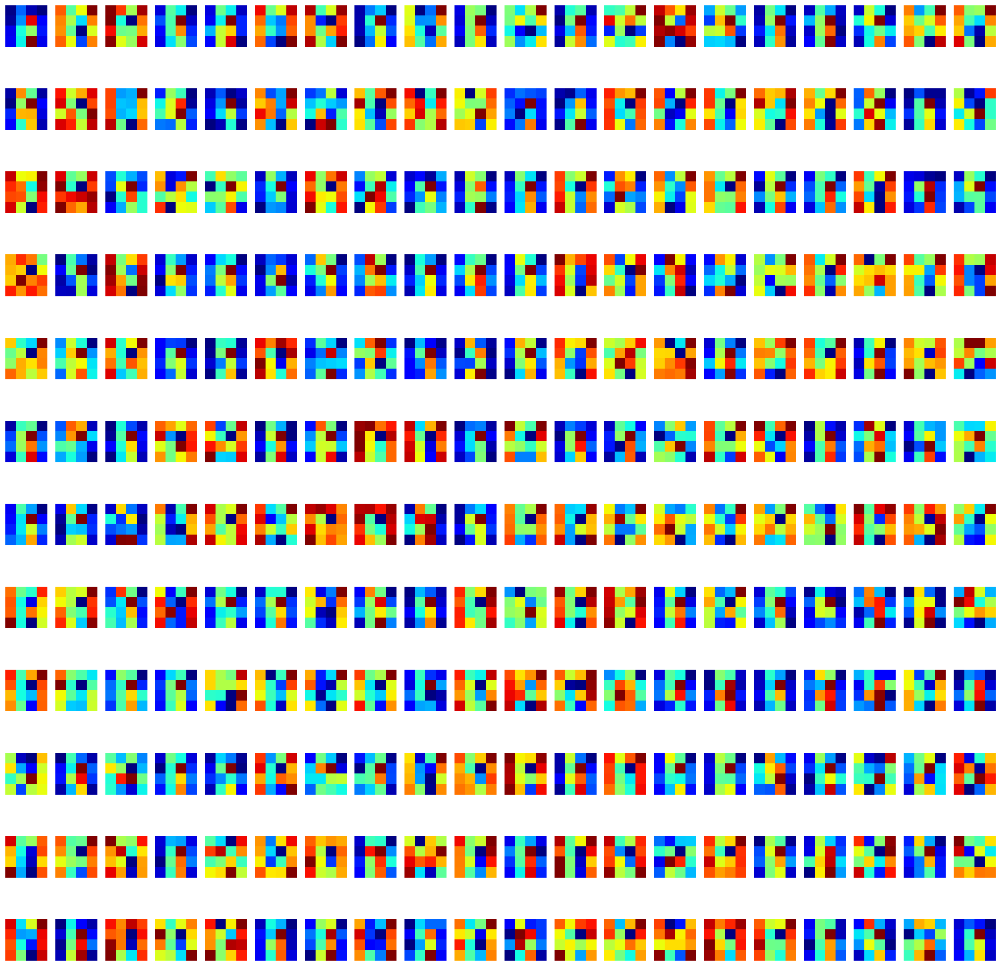

(1, 4, 4, 204)
voting_convolution


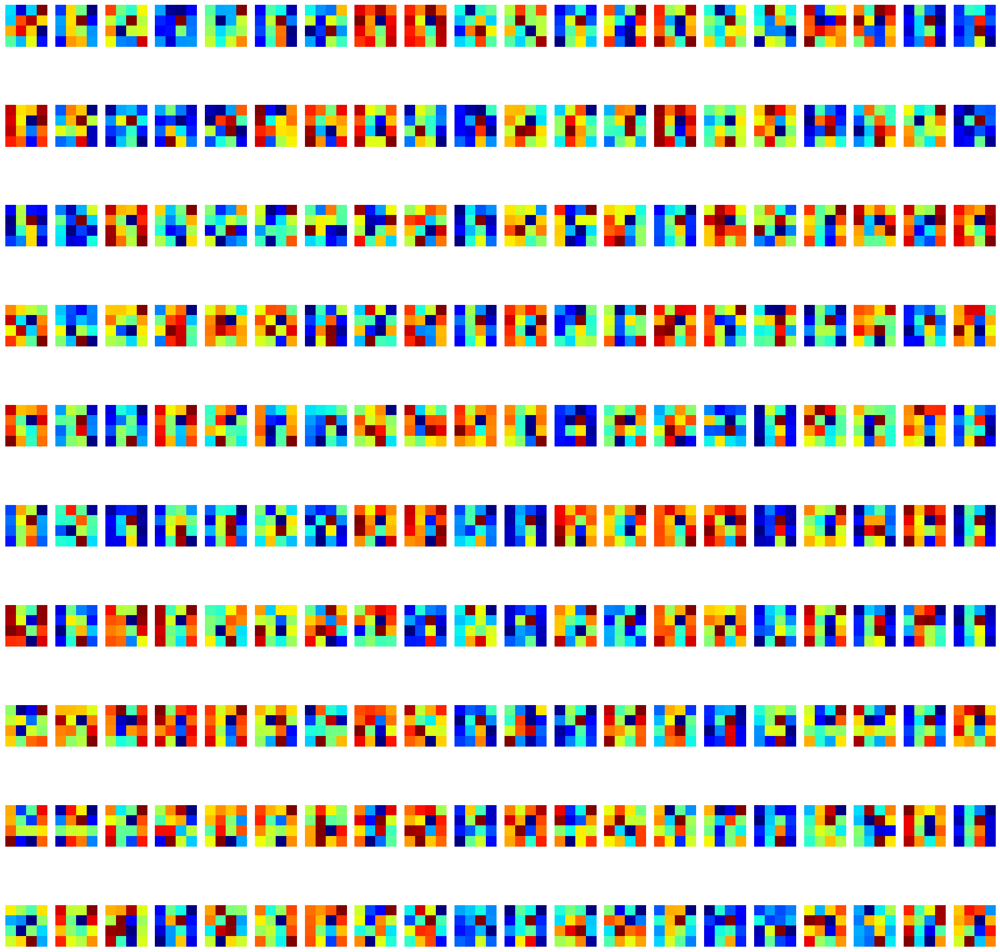

(1, 4, 4, 204)
voting_softmax_target
(1, 4, 4, 256)
feature_convolution


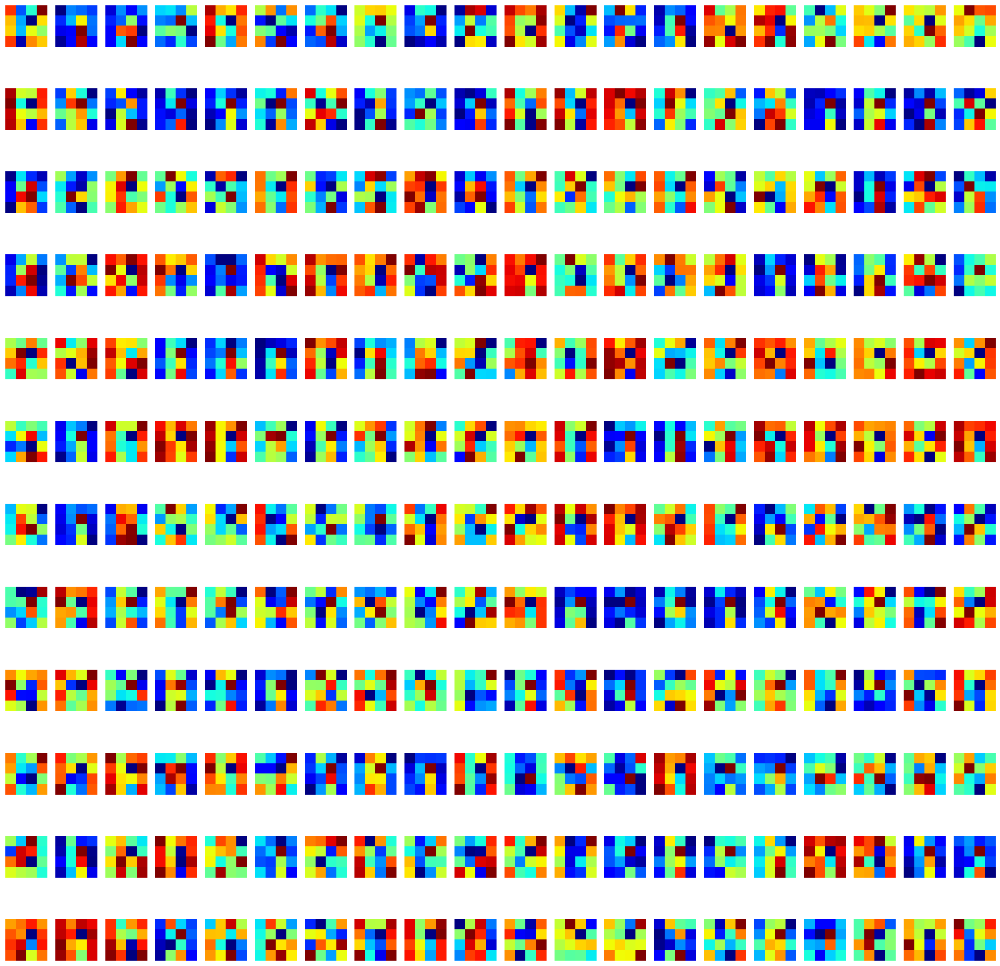

(1, 204, 256)
visual_feat
(1, 204, 256)
visual_feat
(1, 204, 256)
graph_convolution
(1, 204, 256)
evolved_feat
(1, 16, 204, 1)
Ws
(1, 16, 204, 1)
mapping_softmax
(1, 204, 256)
Wsp
(1, 16, 256)
applied_mapping
(1, 32, 32, 256)
conv2d_19


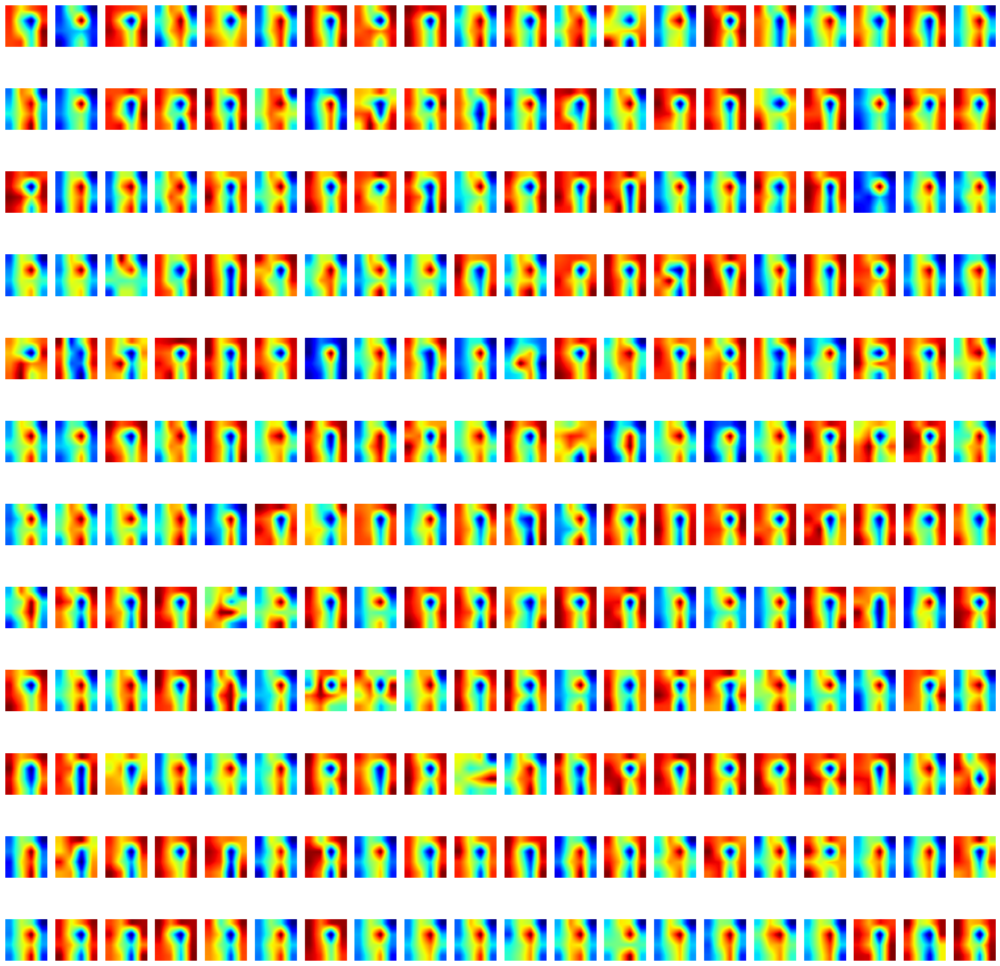

(1, 128, 128, 256)
conv2d_20


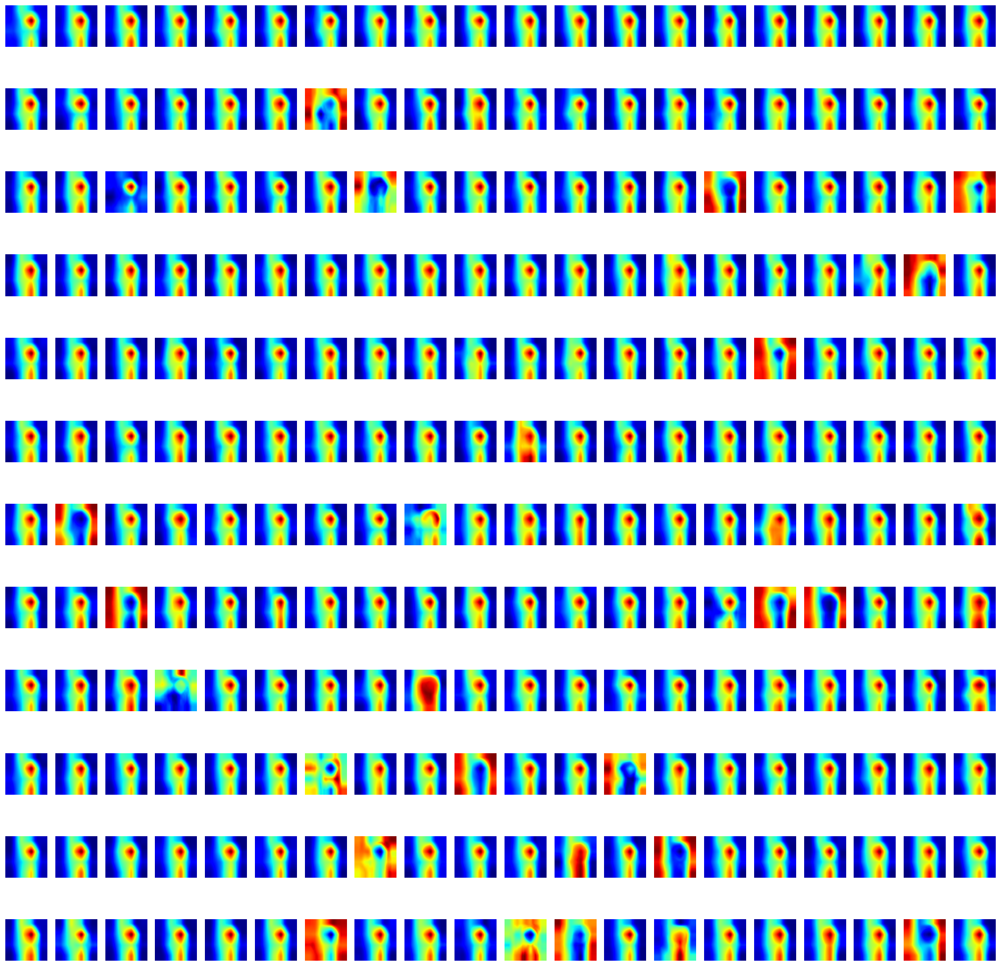

(1, 128, 128, 21)
conv2d_21


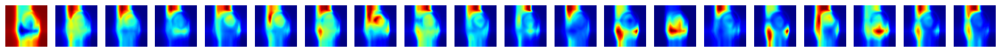

1/1 [==============================] - 0s 317ms/step
20
(1, 1, 1, 256)
conv2d_11


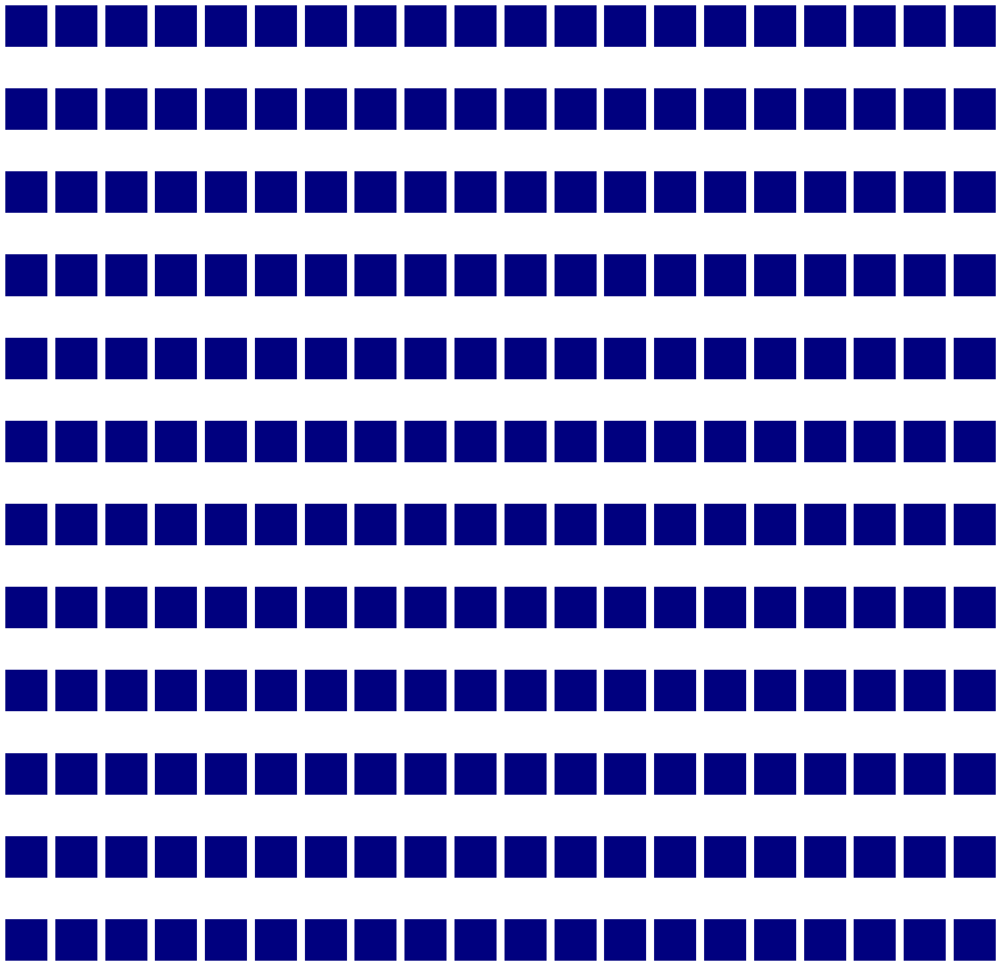

(1, 4, 4, 256)
conv2d_12


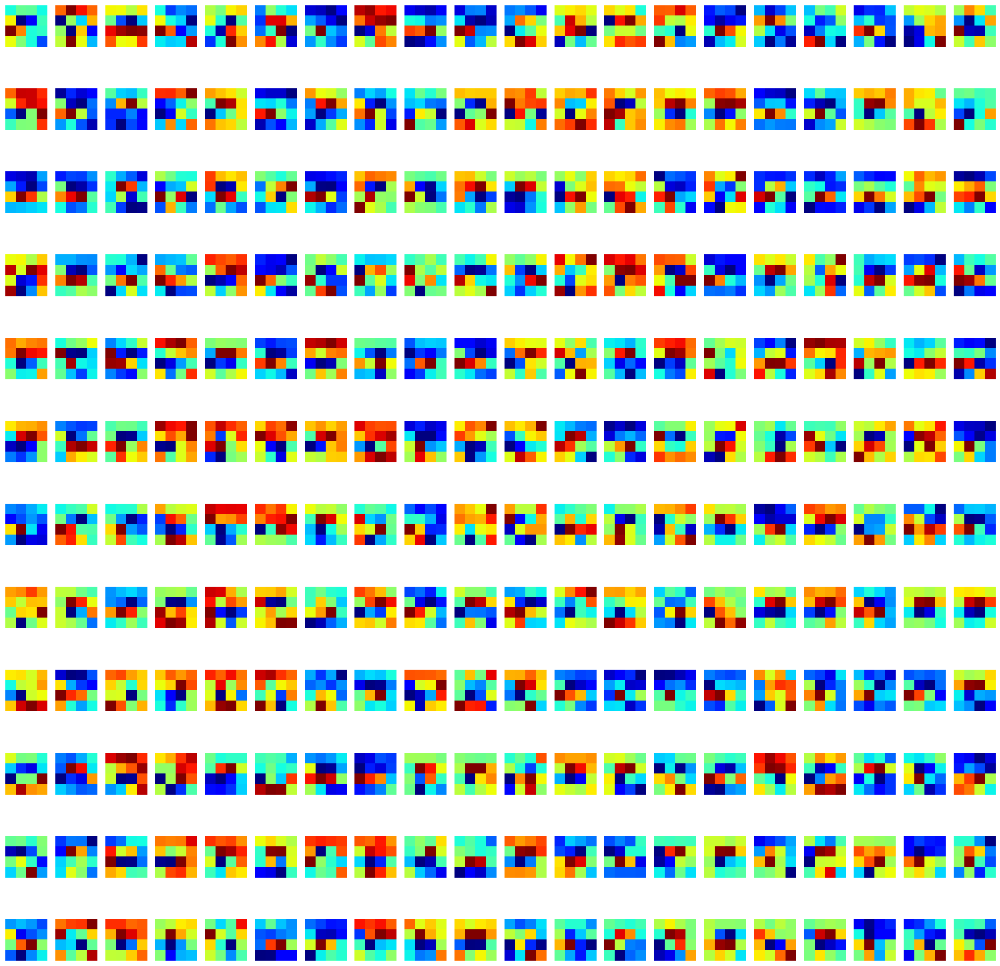

(1, 4, 4, 256)
conv2d_13


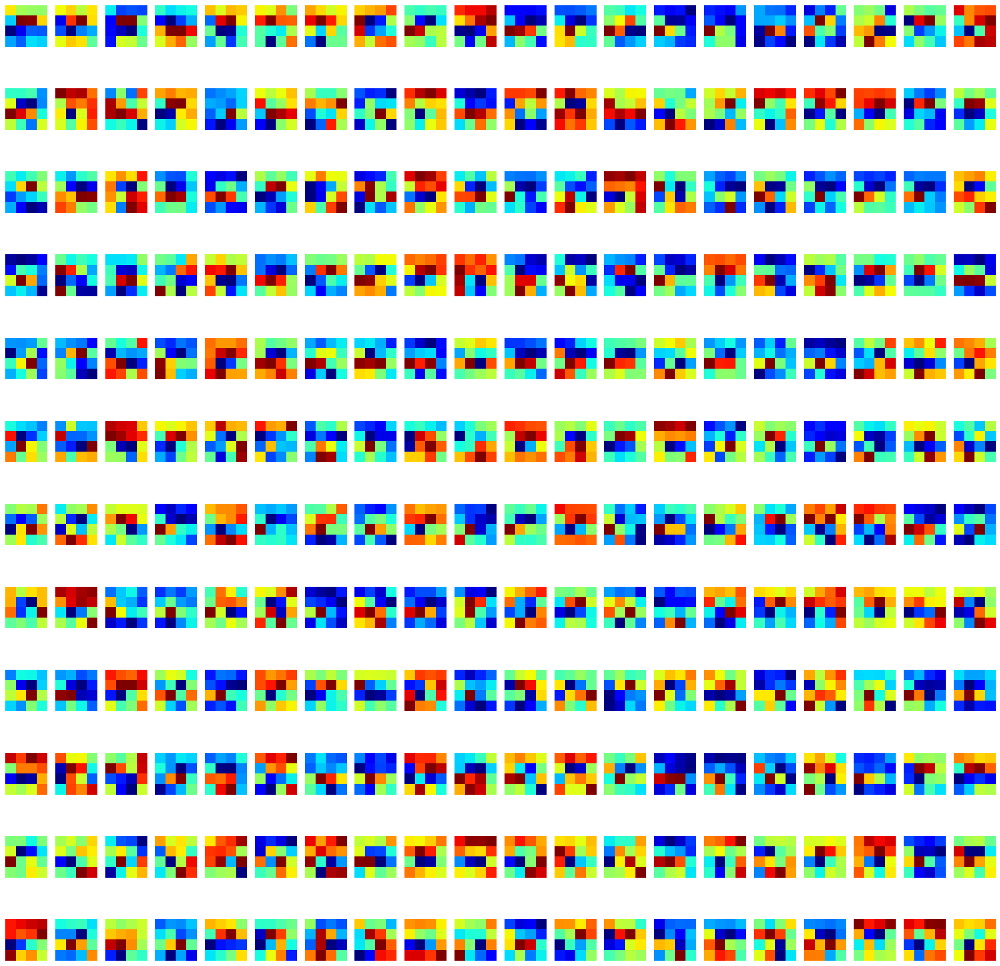

(1, 4, 4, 256)
conv2d_14


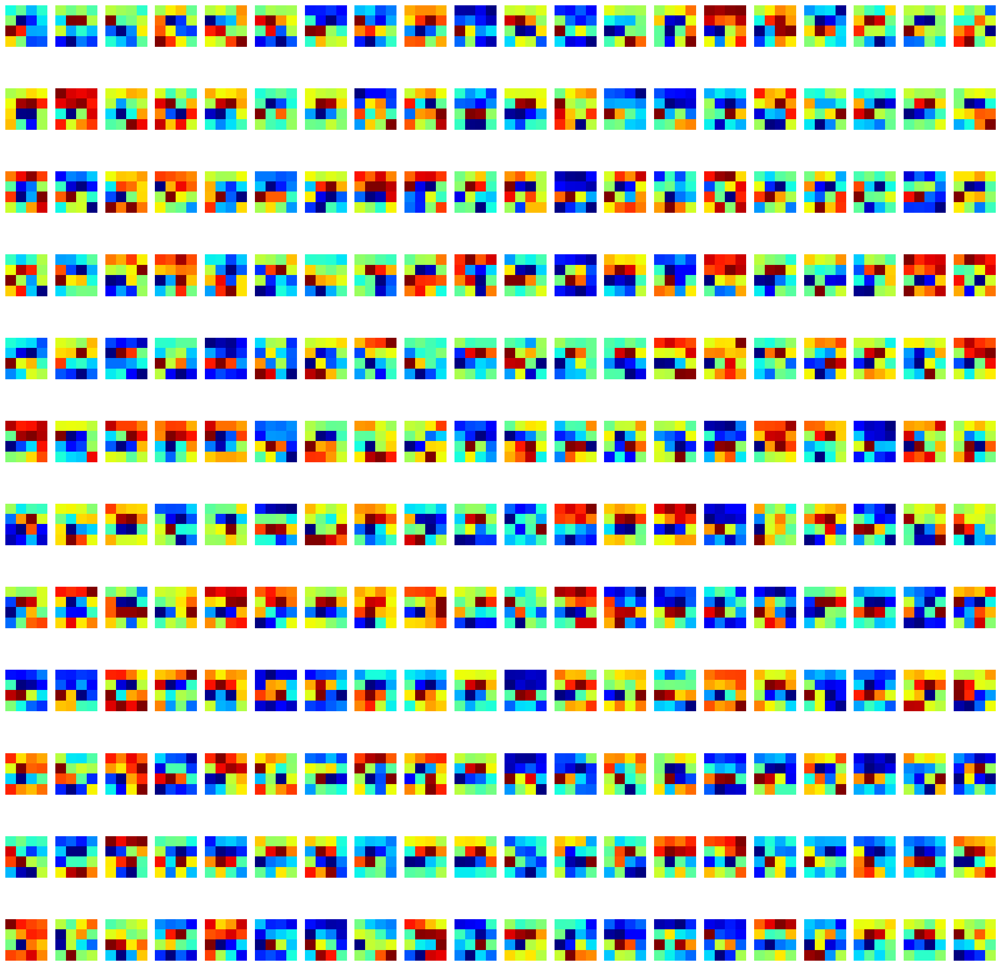

(1, 4, 4, 256)
conv2d_15


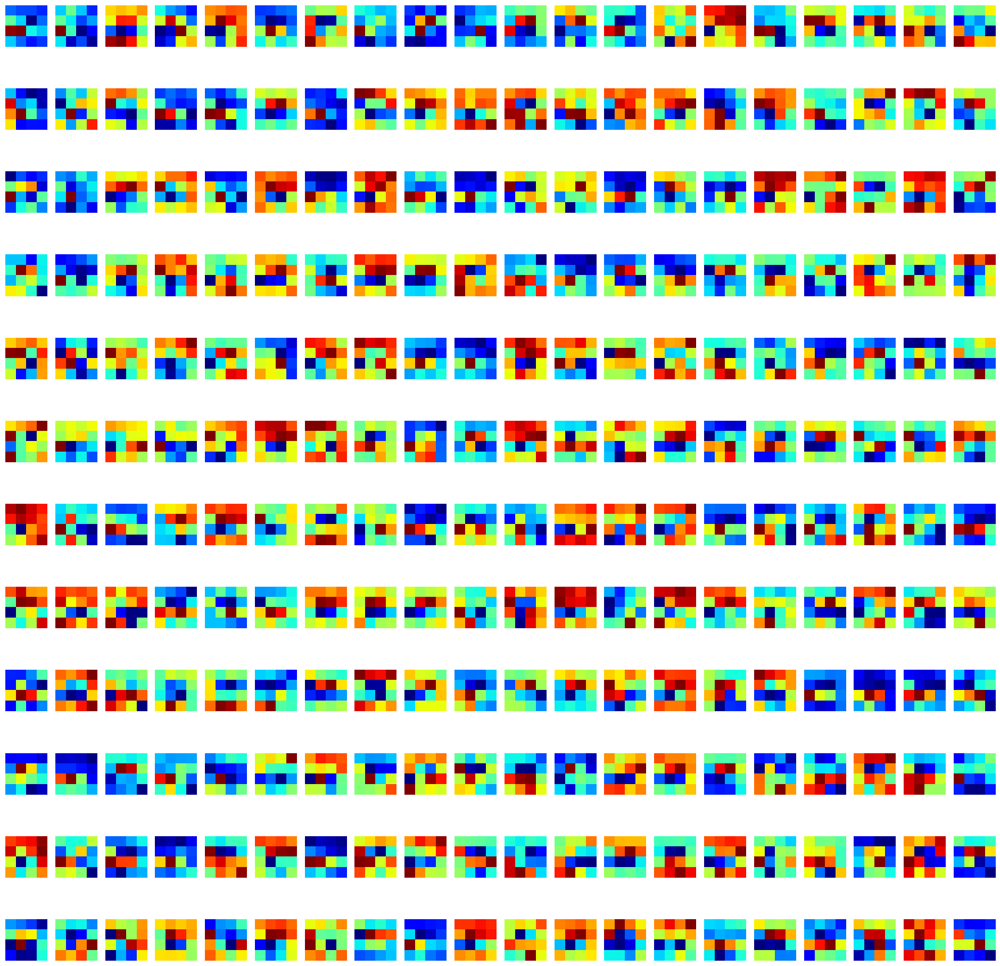

(1, 4, 4, 256)
conv2d_16


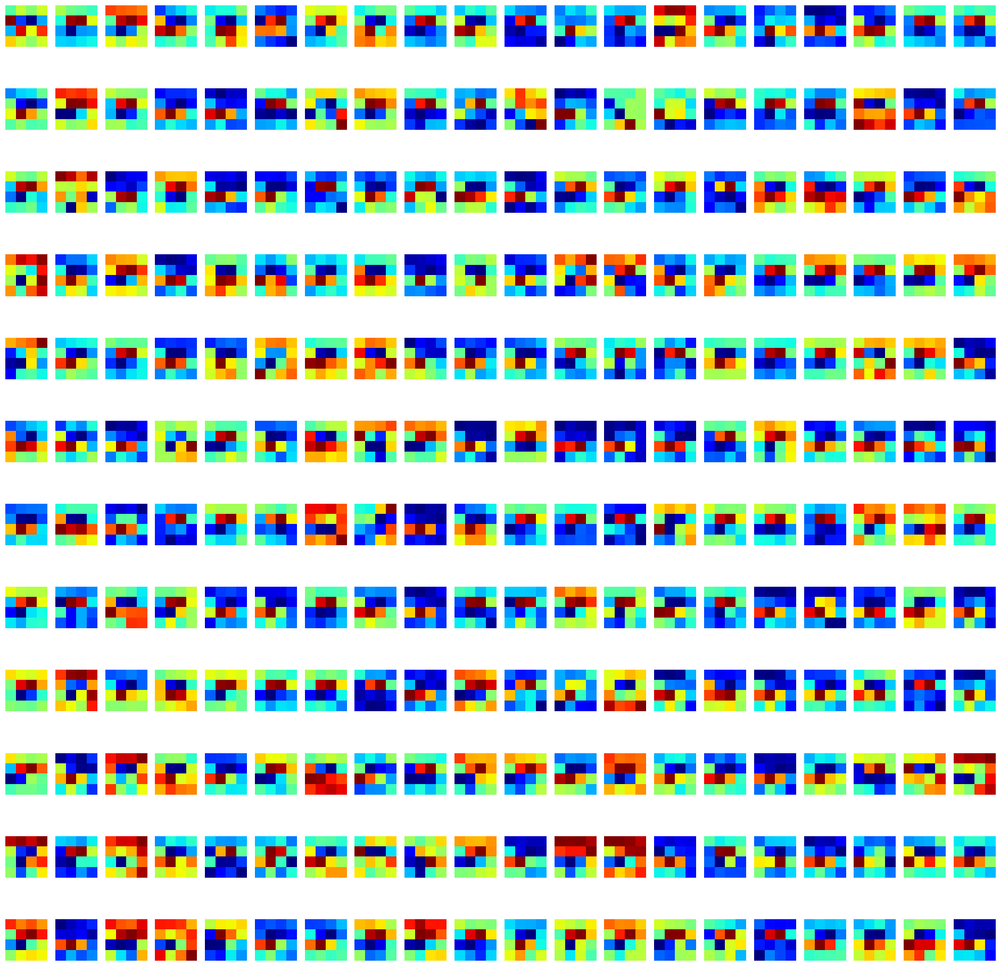

(1, 4, 4, 204)
voting_convolution


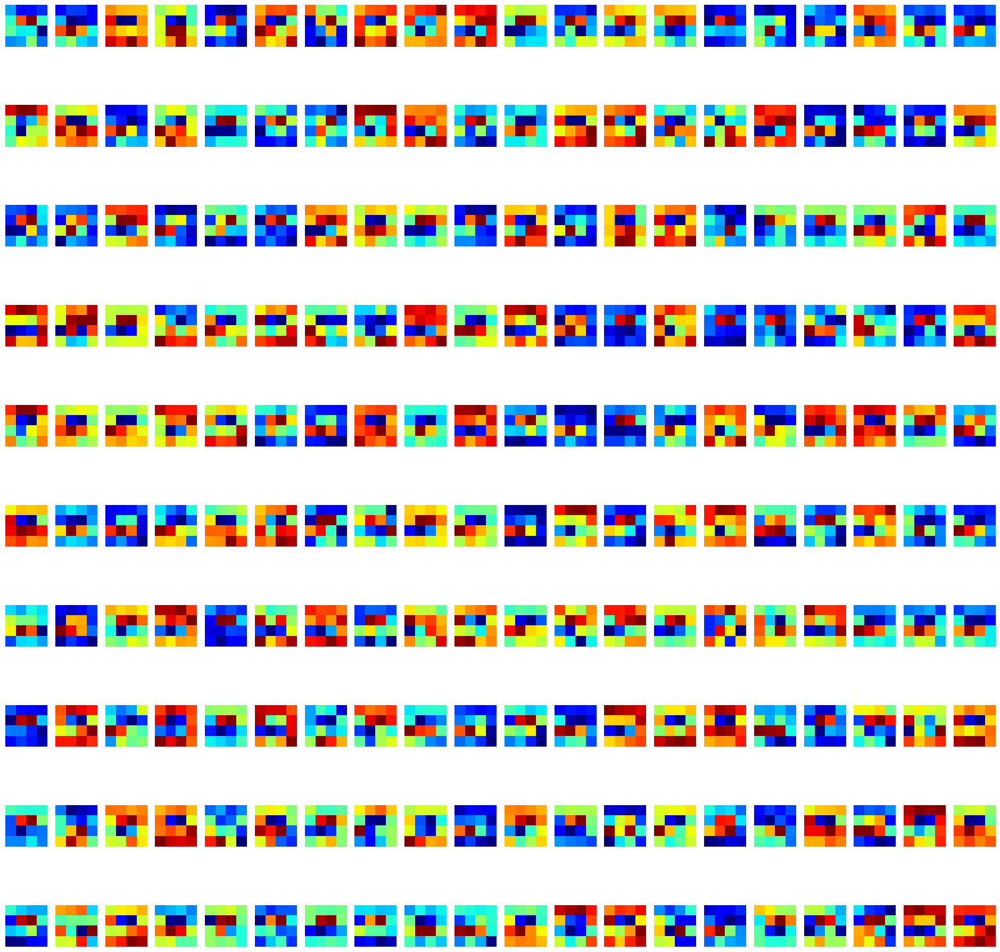

(1, 4, 4, 204)
voting_softmax_target
(1, 4, 4, 256)
feature_convolution


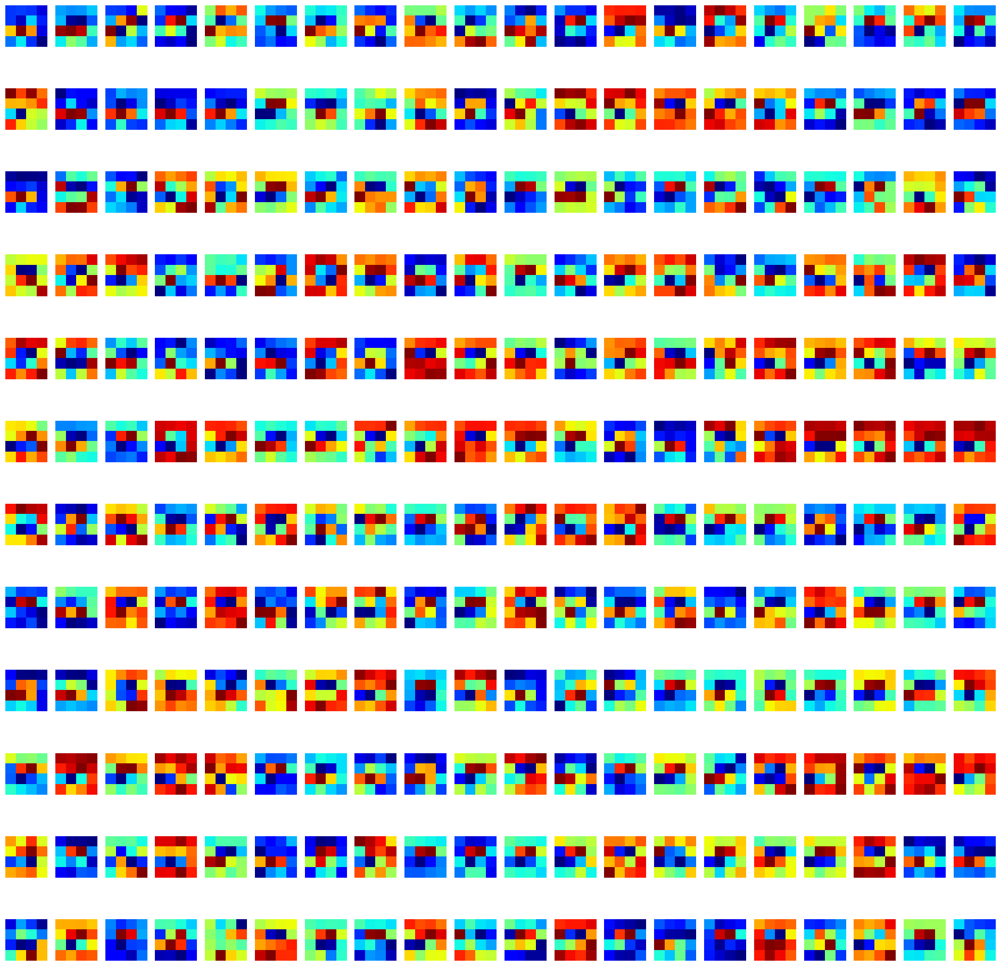

(1, 204, 256)
visual_feat
(1, 204, 256)
visual_feat
(1, 204, 256)
graph_convolution
(1, 204, 256)
evolved_feat
(1, 16, 204, 1)
Ws
(1, 16, 204, 1)
mapping_softmax
(1, 204, 256)
Wsp
(1, 16, 256)
applied_mapping
(1, 32, 32, 256)
conv2d_19


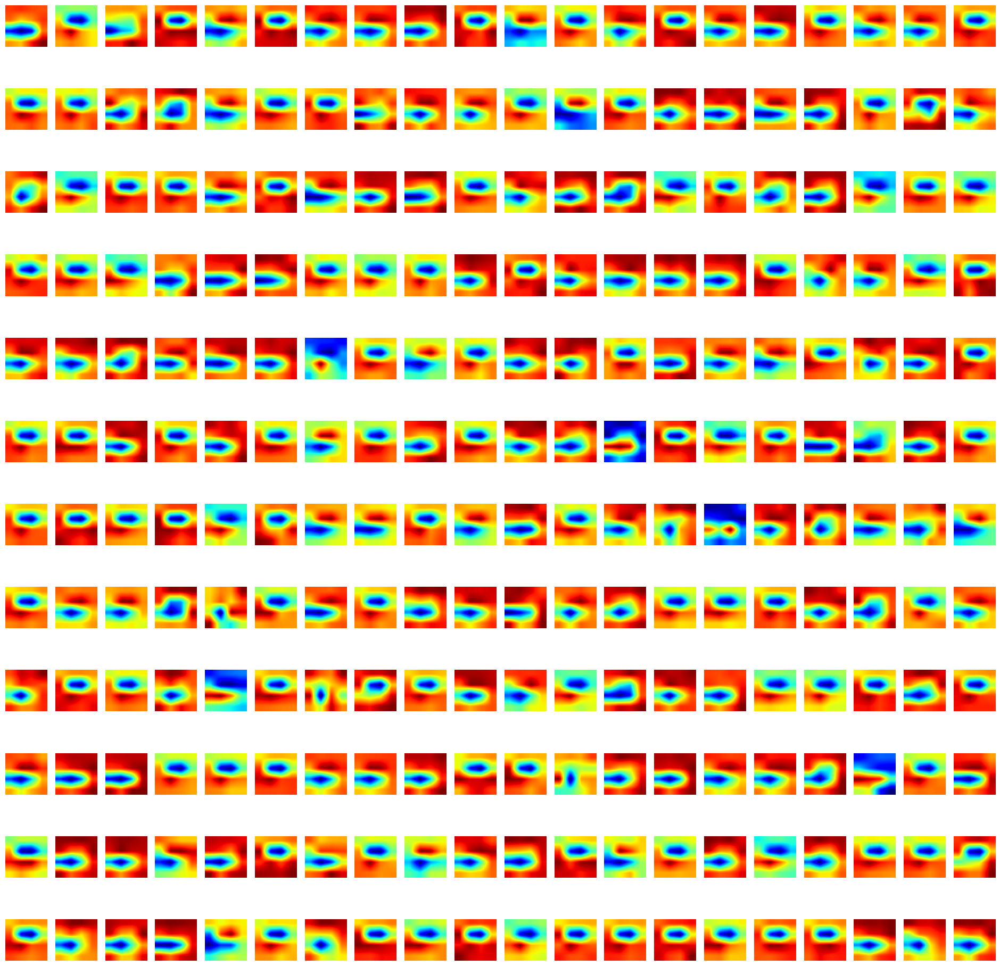

(1, 128, 128, 256)
conv2d_20


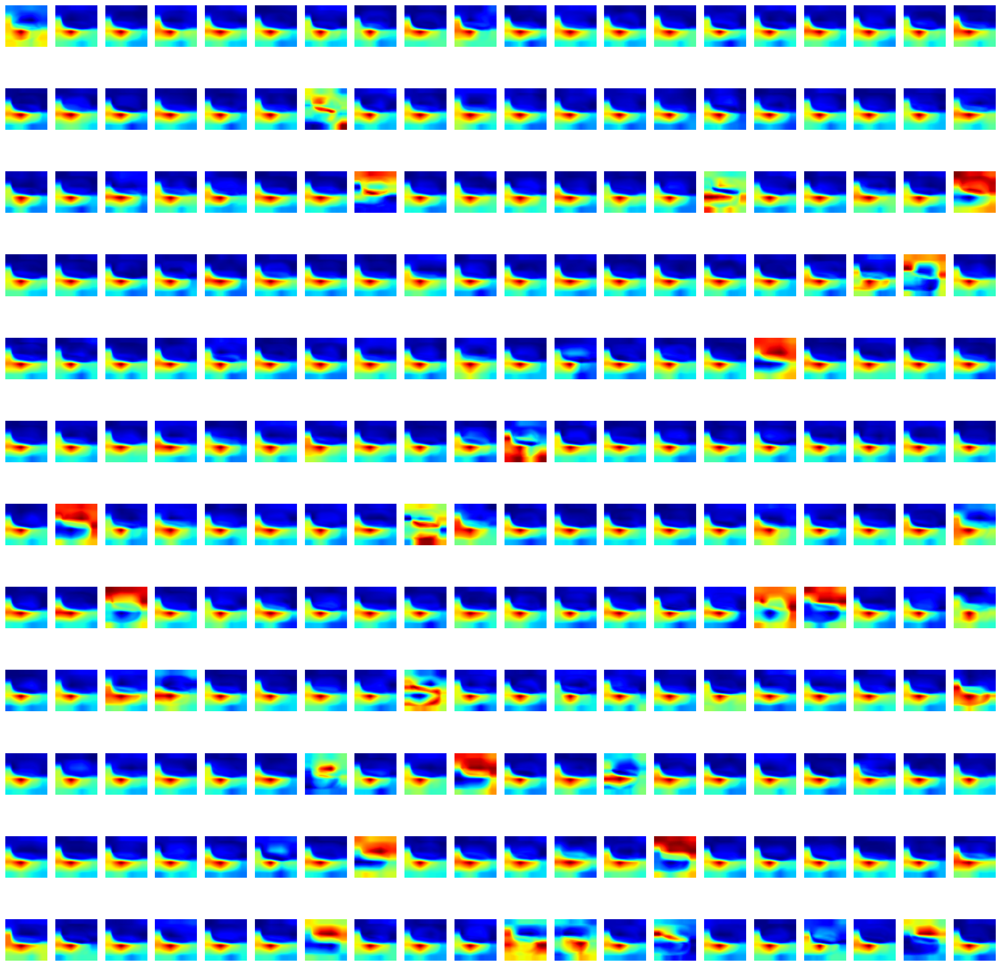

(1, 128, 128, 21)
conv2d_21


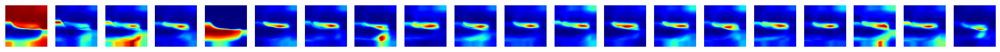

1/1 [==============================] - 0s 307ms/step
20
(1, 1, 1, 256)
conv2d_11


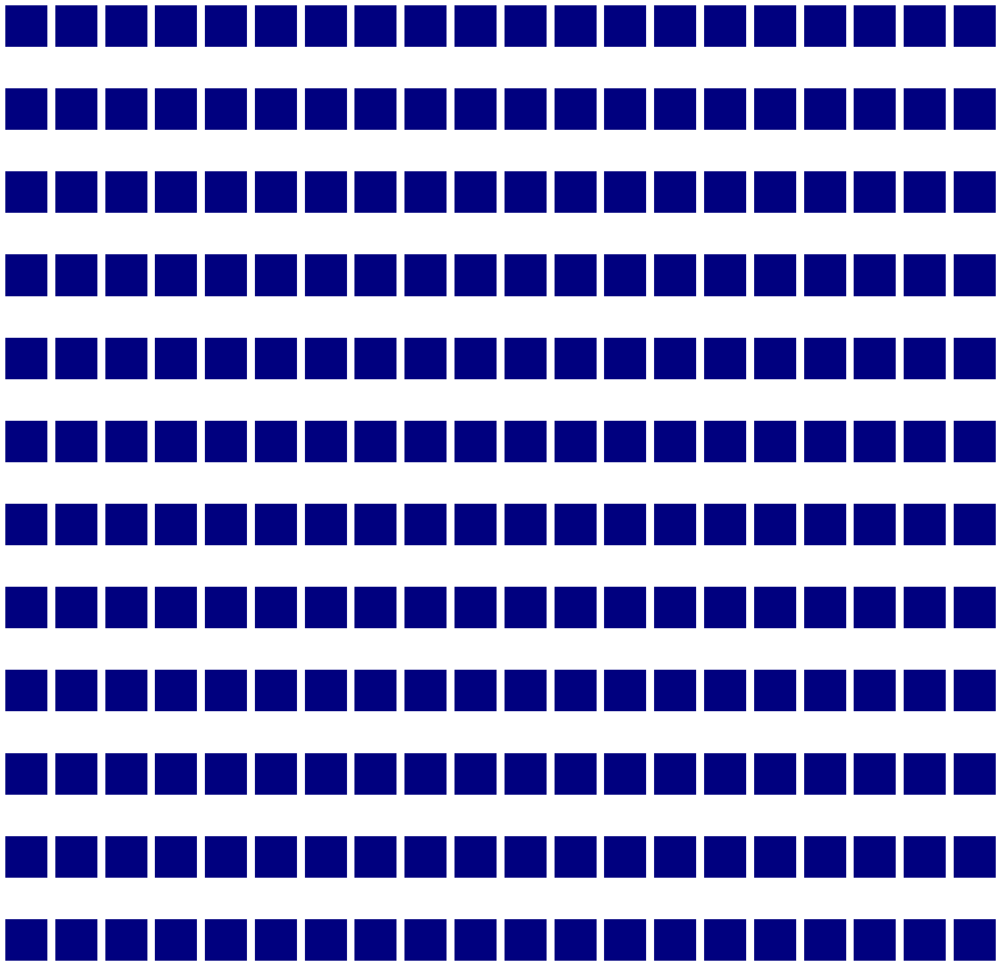

(1, 4, 4, 256)
conv2d_12


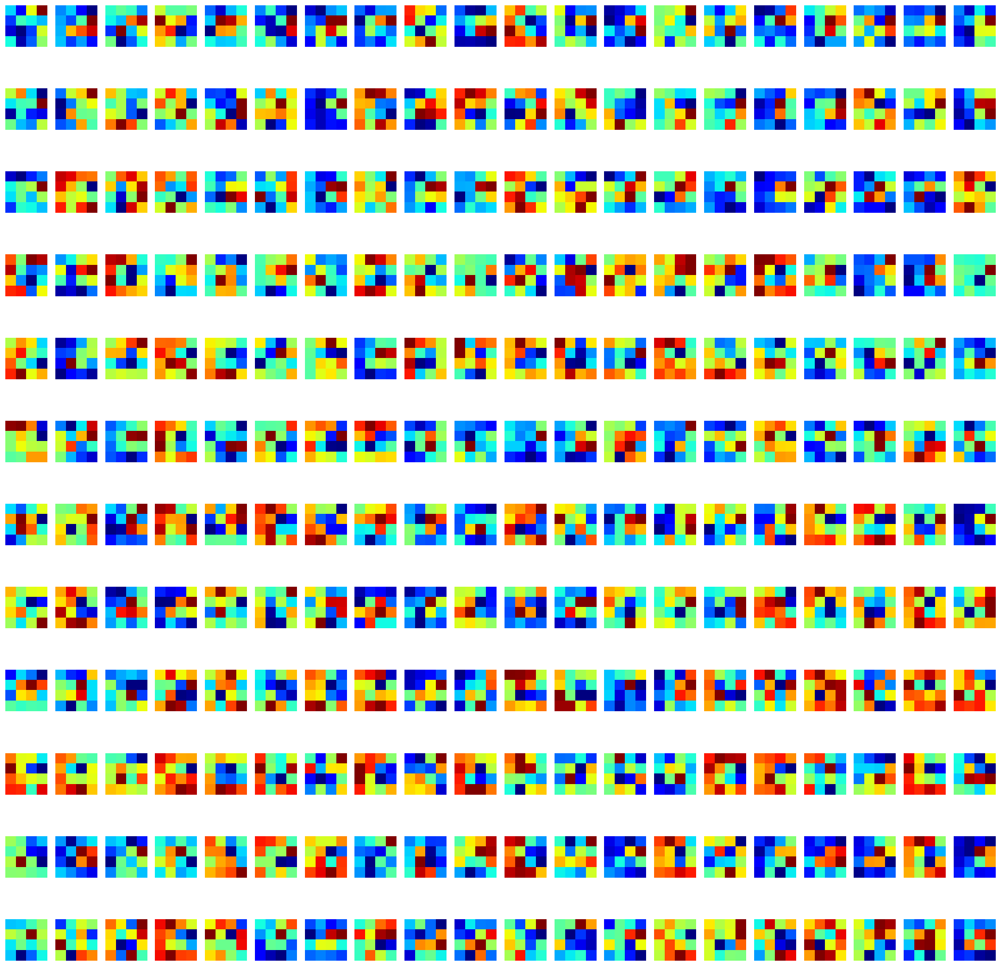

(1, 4, 4, 256)
conv2d_13


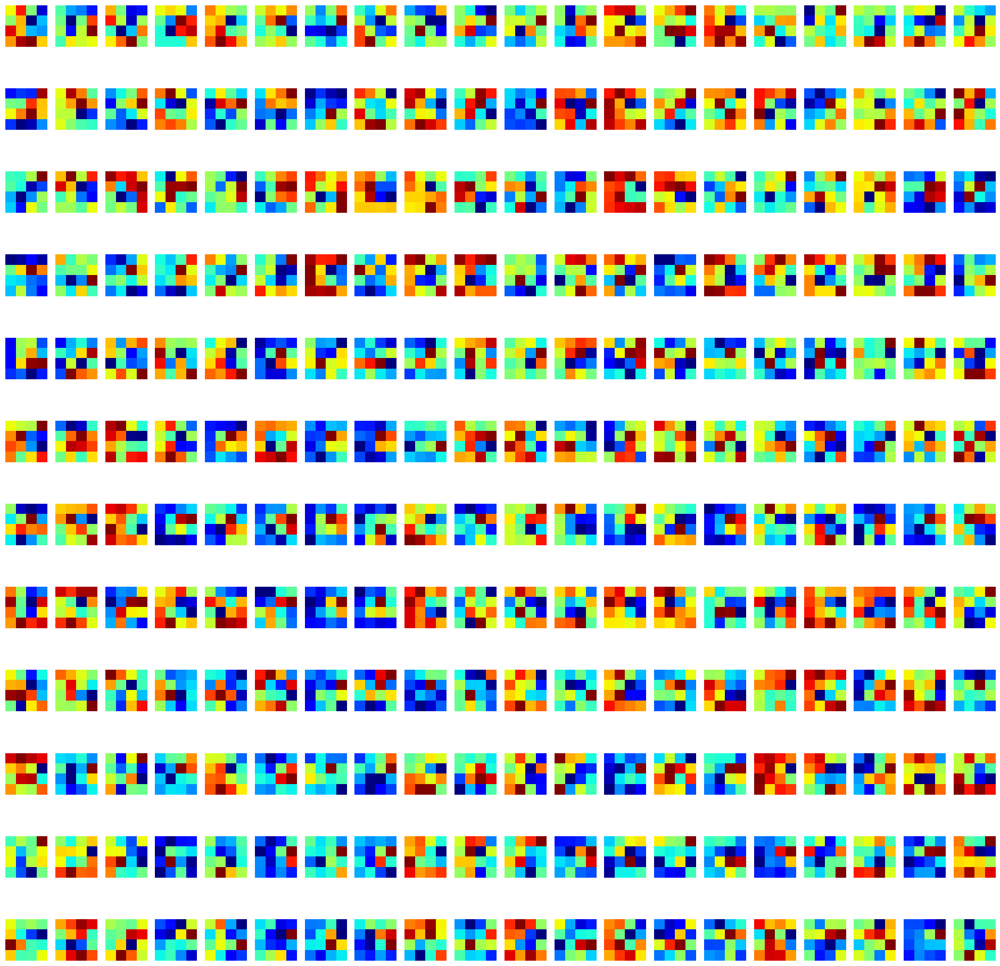

(1, 4, 4, 256)
conv2d_14


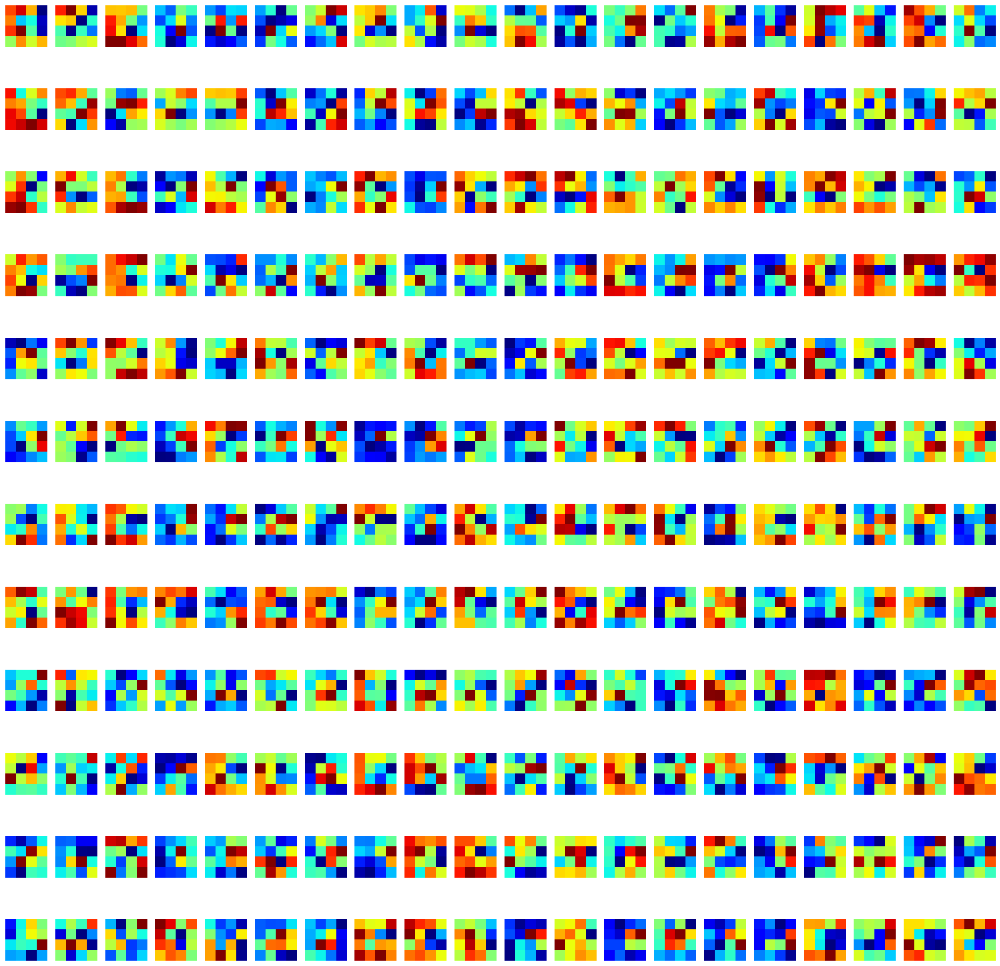

(1, 4, 4, 256)
conv2d_15


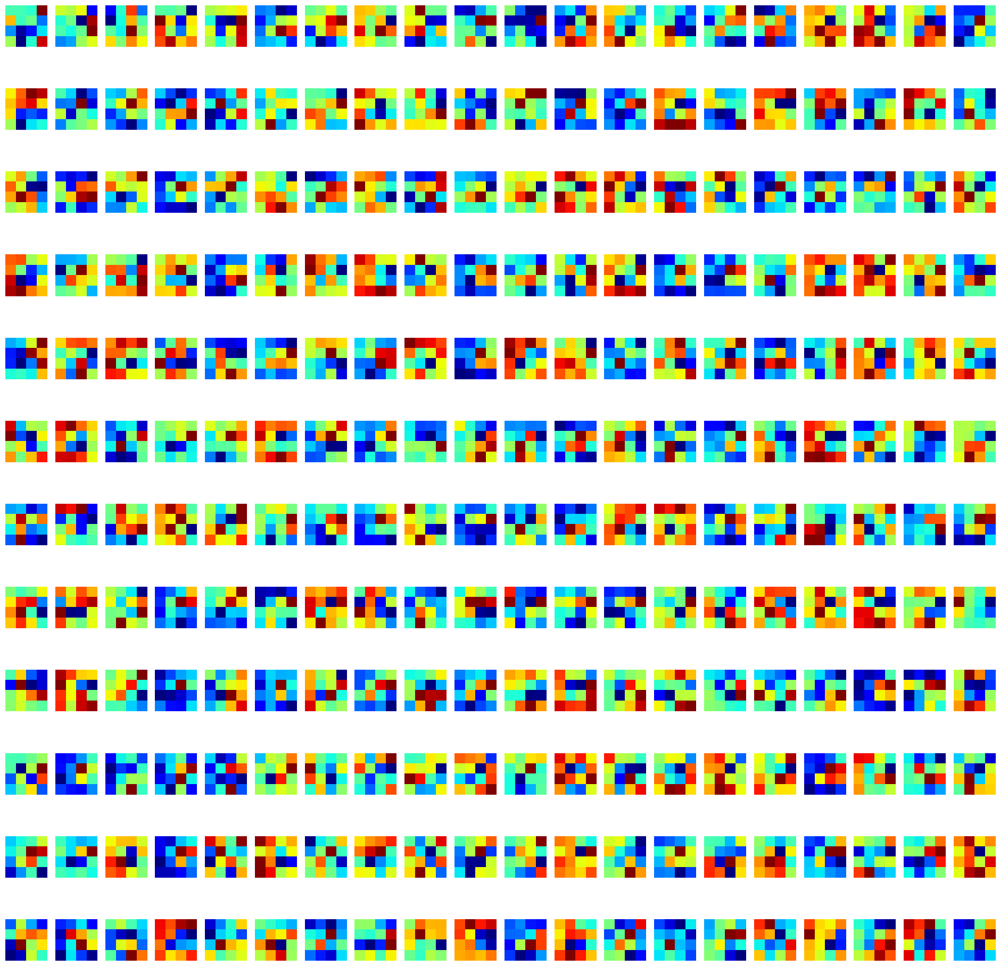

(1, 4, 4, 256)
conv2d_16


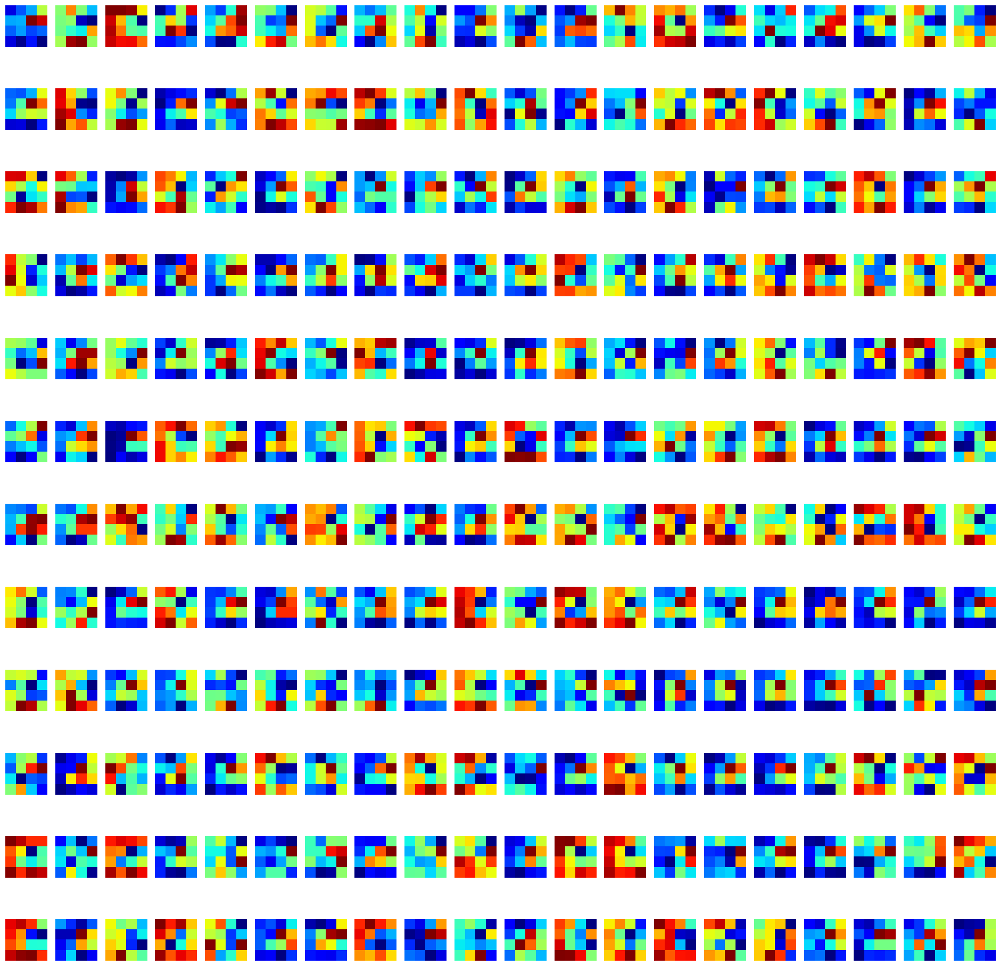

(1, 4, 4, 204)
voting_convolution


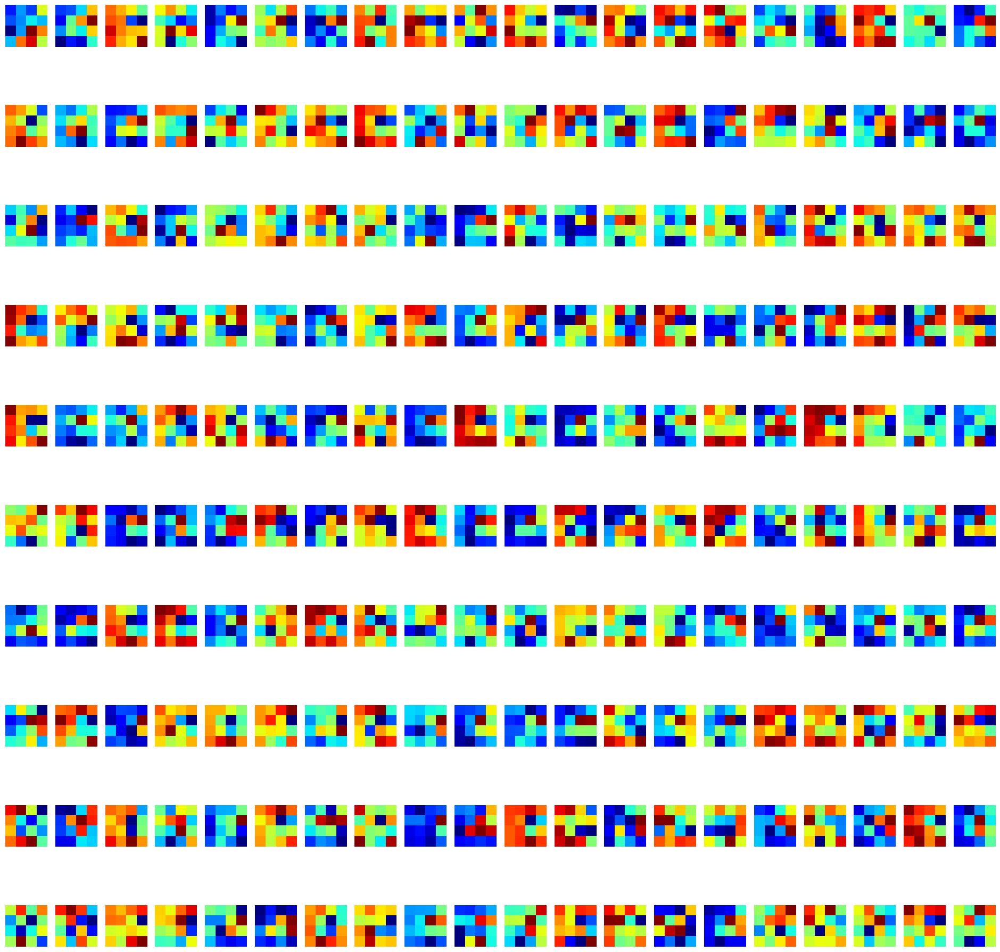

(1, 4, 4, 204)
voting_softmax_target
(1, 4, 4, 256)
feature_convolution


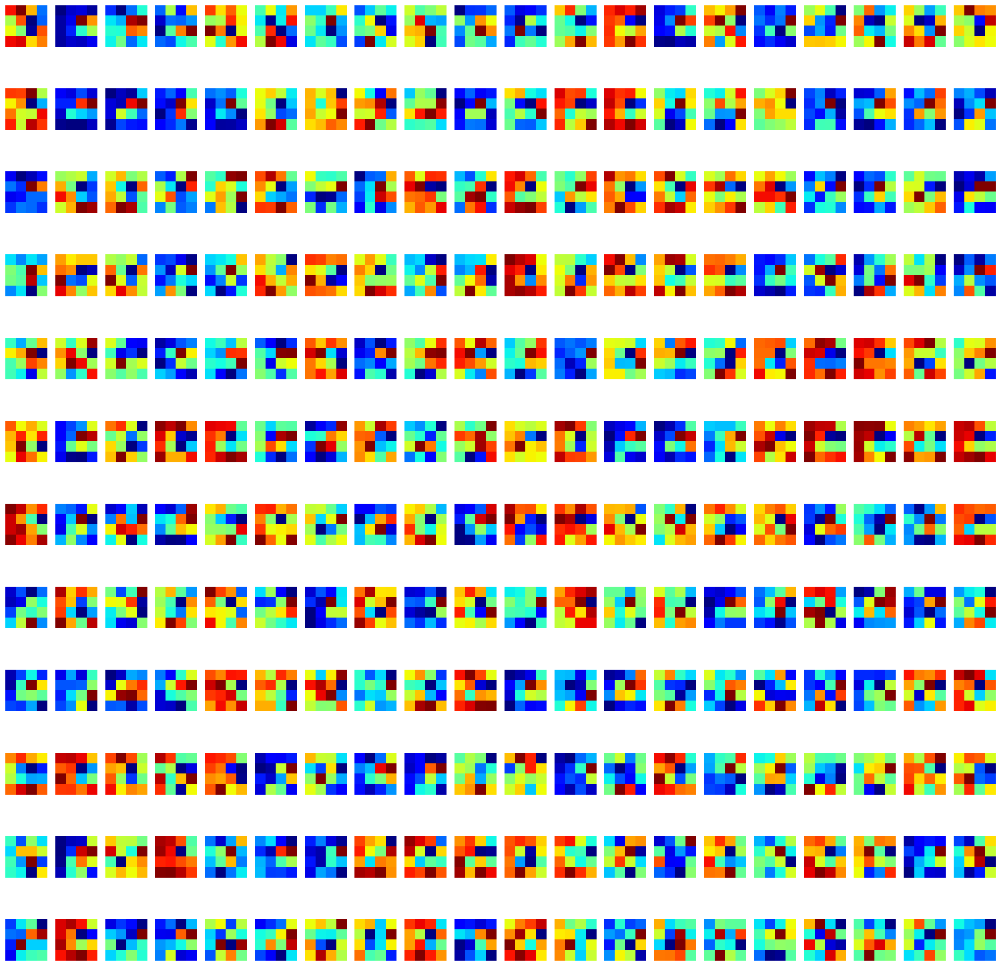

(1, 204, 256)
visual_feat
(1, 204, 256)
visual_feat
(1, 204, 256)
graph_convolution
(1, 204, 256)
evolved_feat
(1, 16, 204, 1)
Ws
(1, 16, 204, 1)
mapping_softmax
(1, 204, 256)
Wsp
(1, 16, 256)
applied_mapping
(1, 32, 32, 256)
conv2d_19


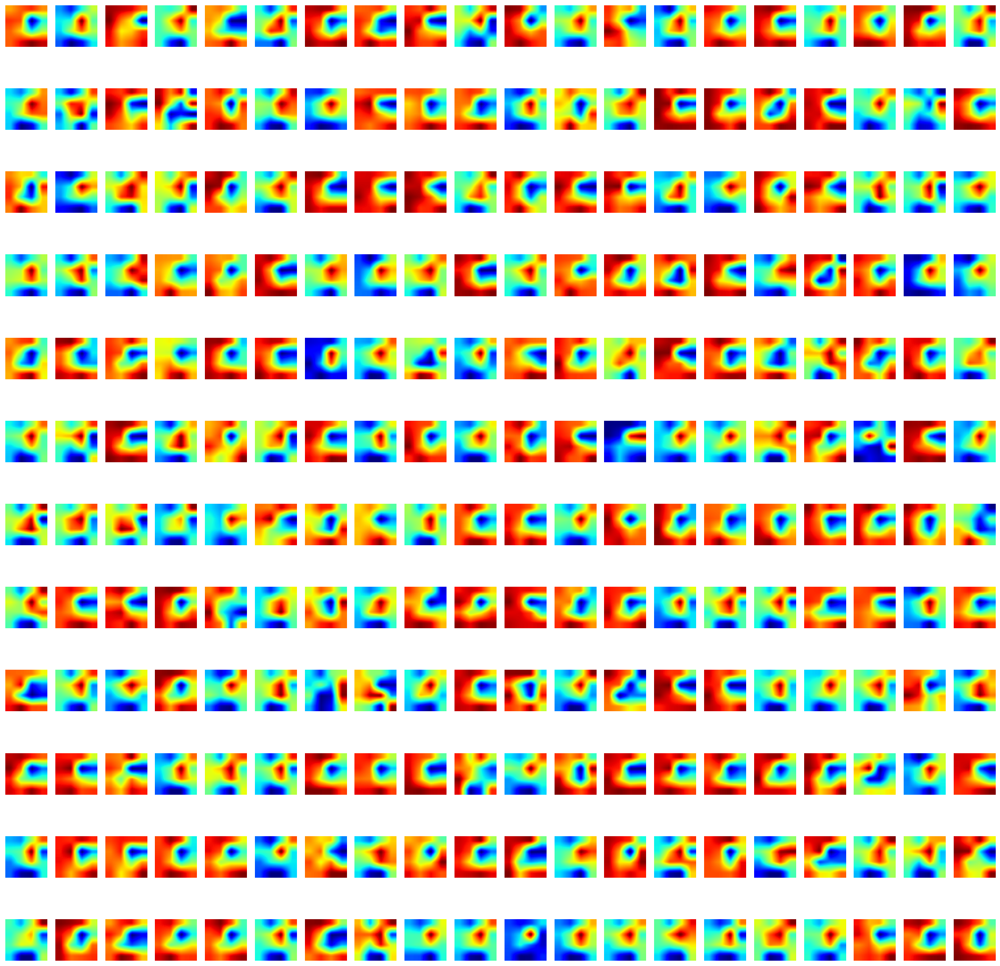

(1, 128, 128, 256)
conv2d_20


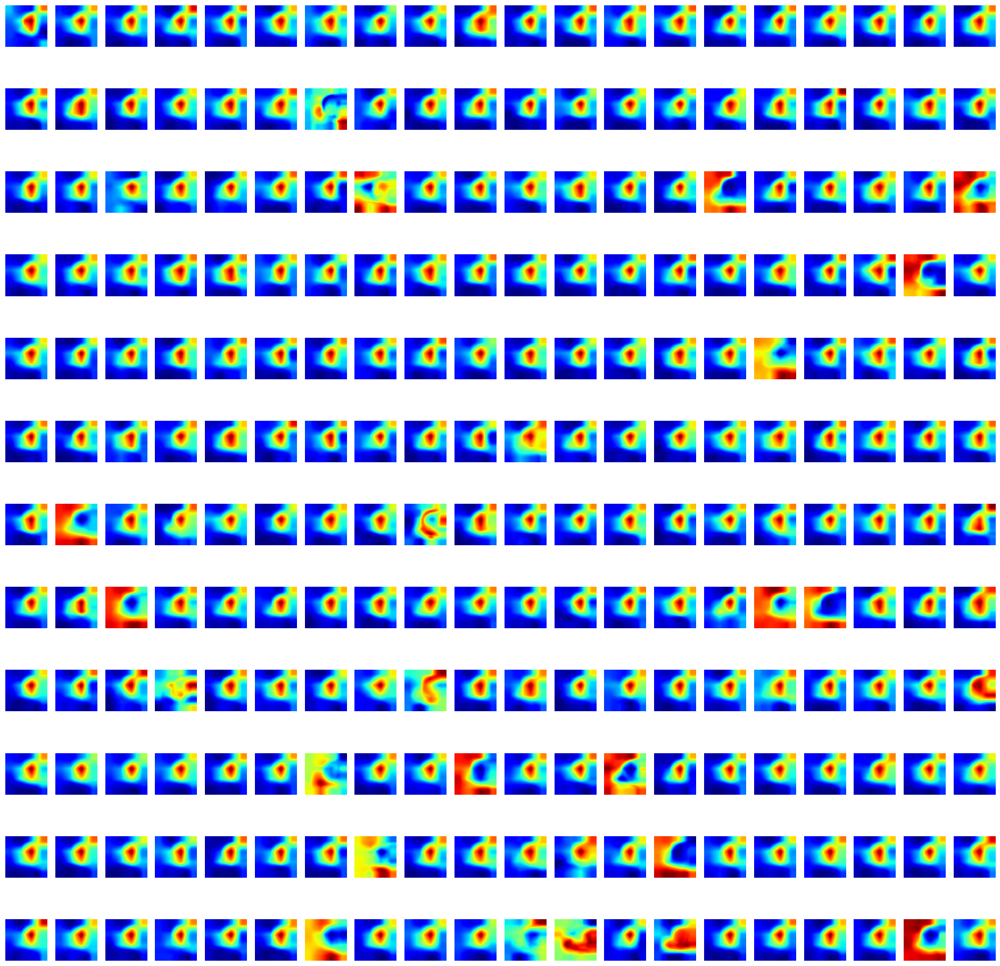

(1, 128, 128, 21)
conv2d_21


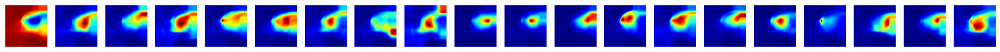

1/1 [==============================] - 0s 309ms/step
20
(1, 1, 1, 256)
conv2d_11


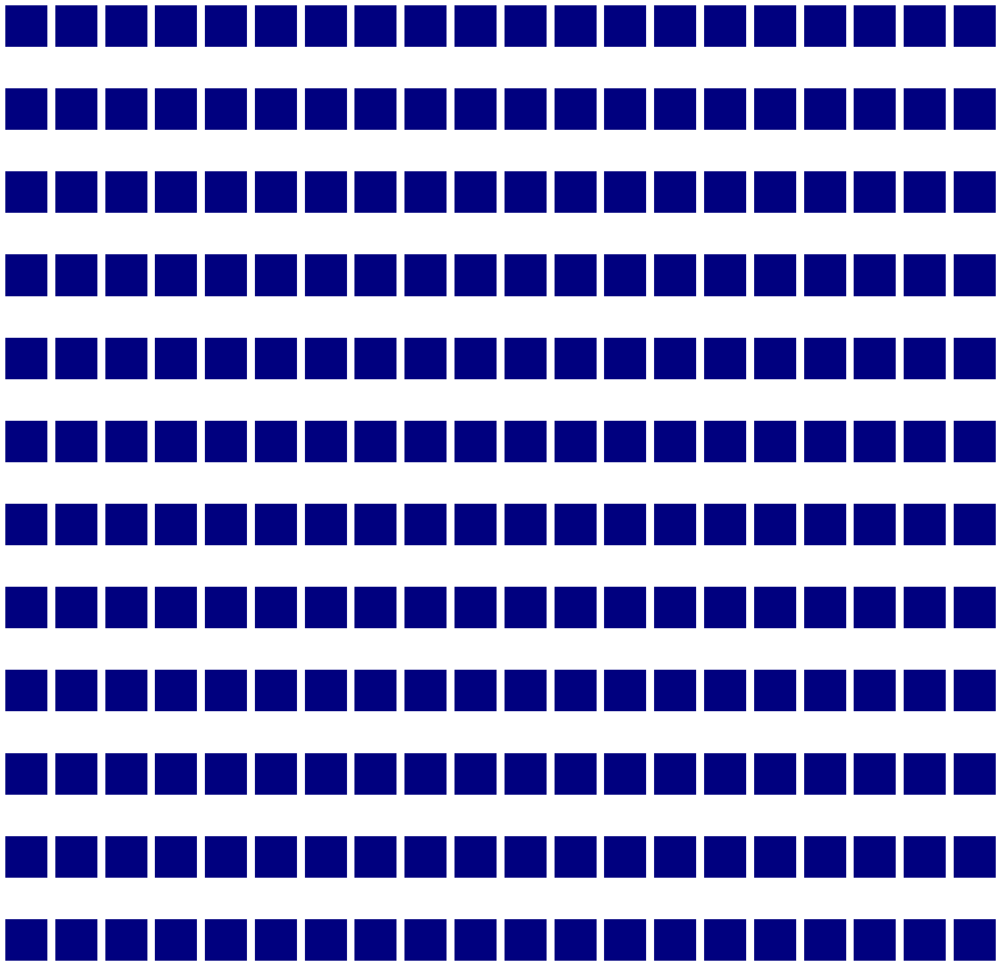

(1, 4, 4, 256)
conv2d_12


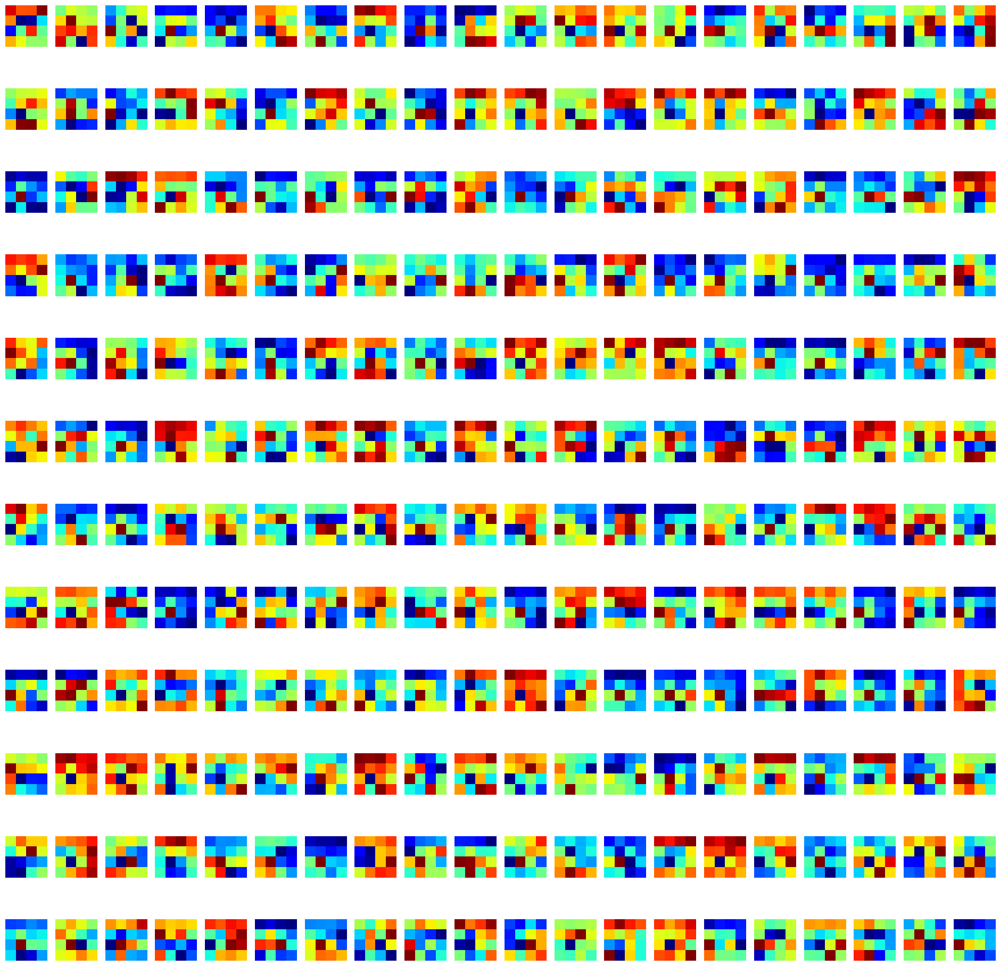

(1, 4, 4, 256)
conv2d_13


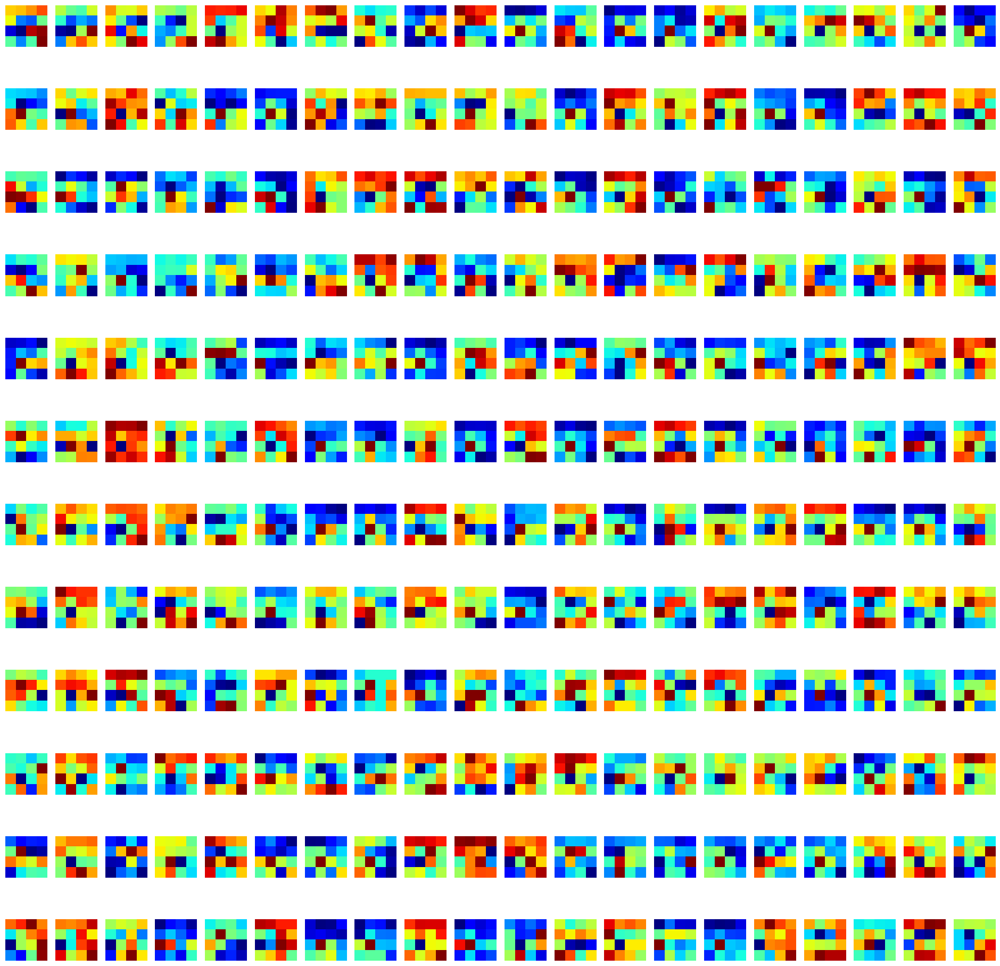

(1, 4, 4, 256)
conv2d_14


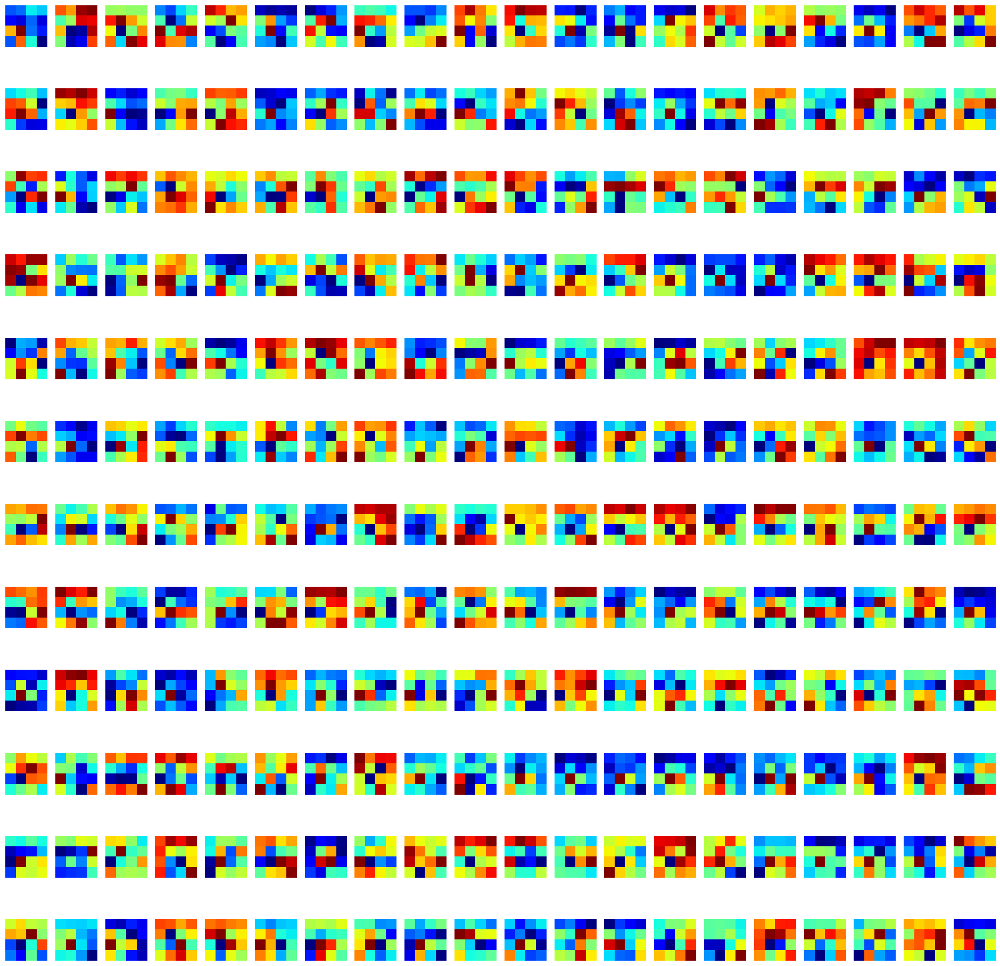

(1, 4, 4, 256)
conv2d_15


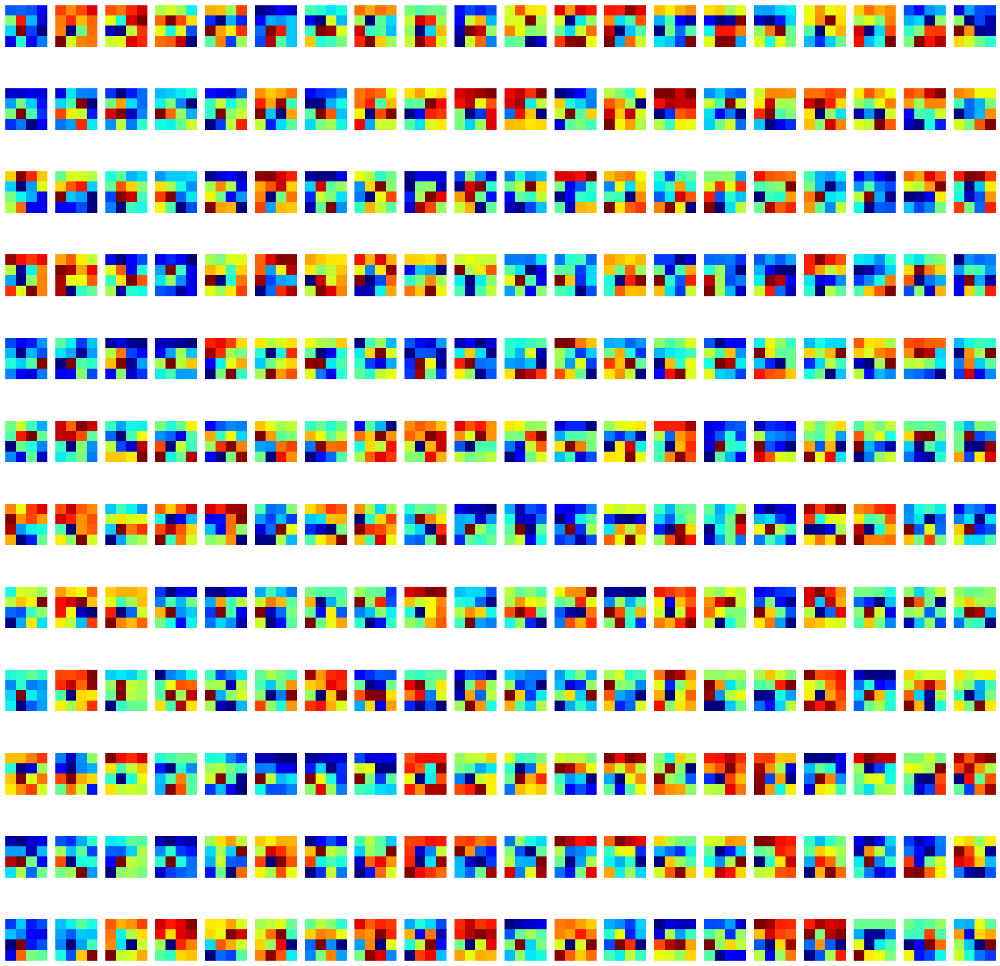

(1, 4, 4, 256)
conv2d_16


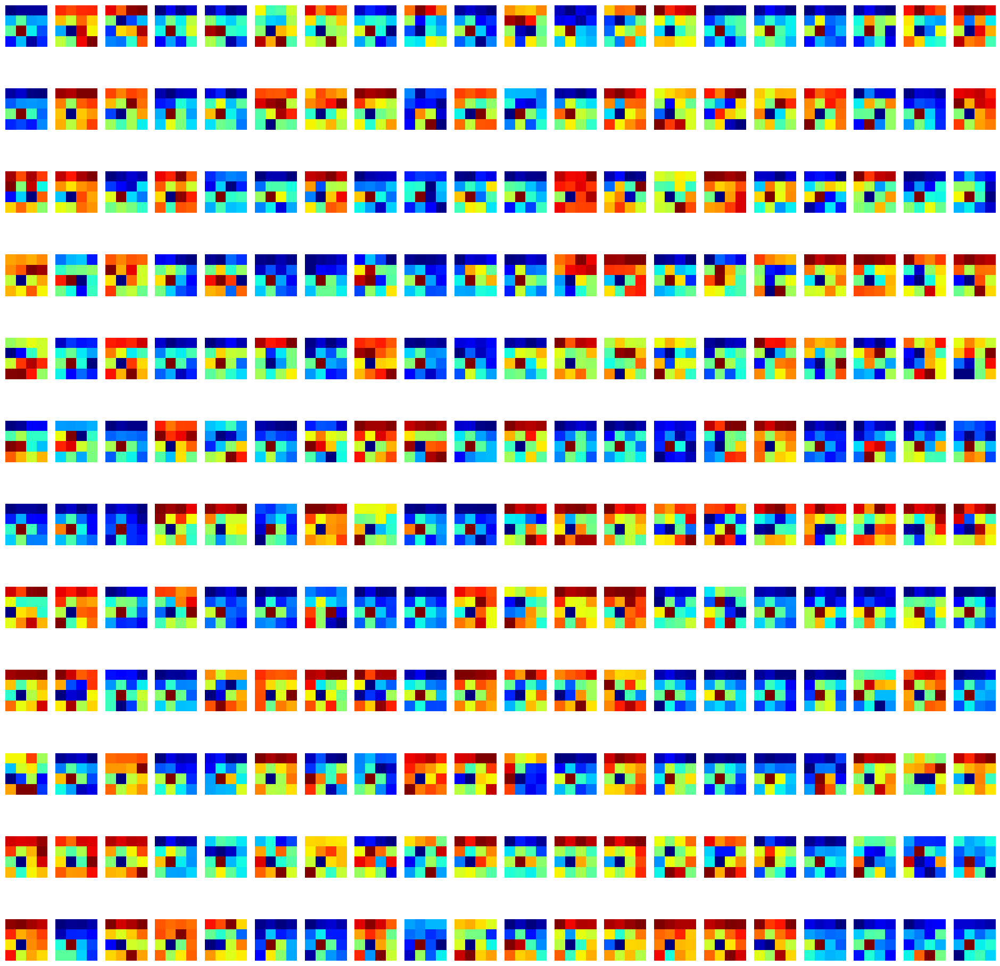

(1, 4, 4, 204)
voting_convolution


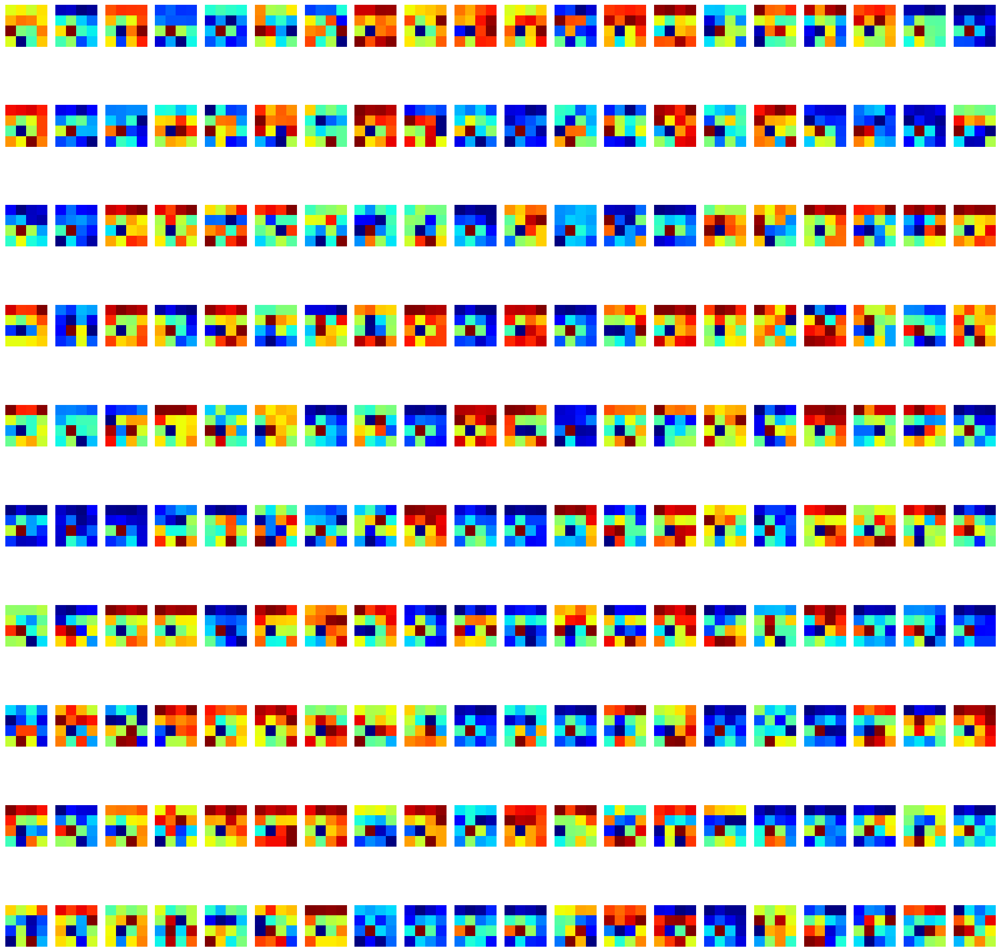

(1, 4, 4, 204)
voting_softmax_target
(1, 4, 4, 256)
feature_convolution


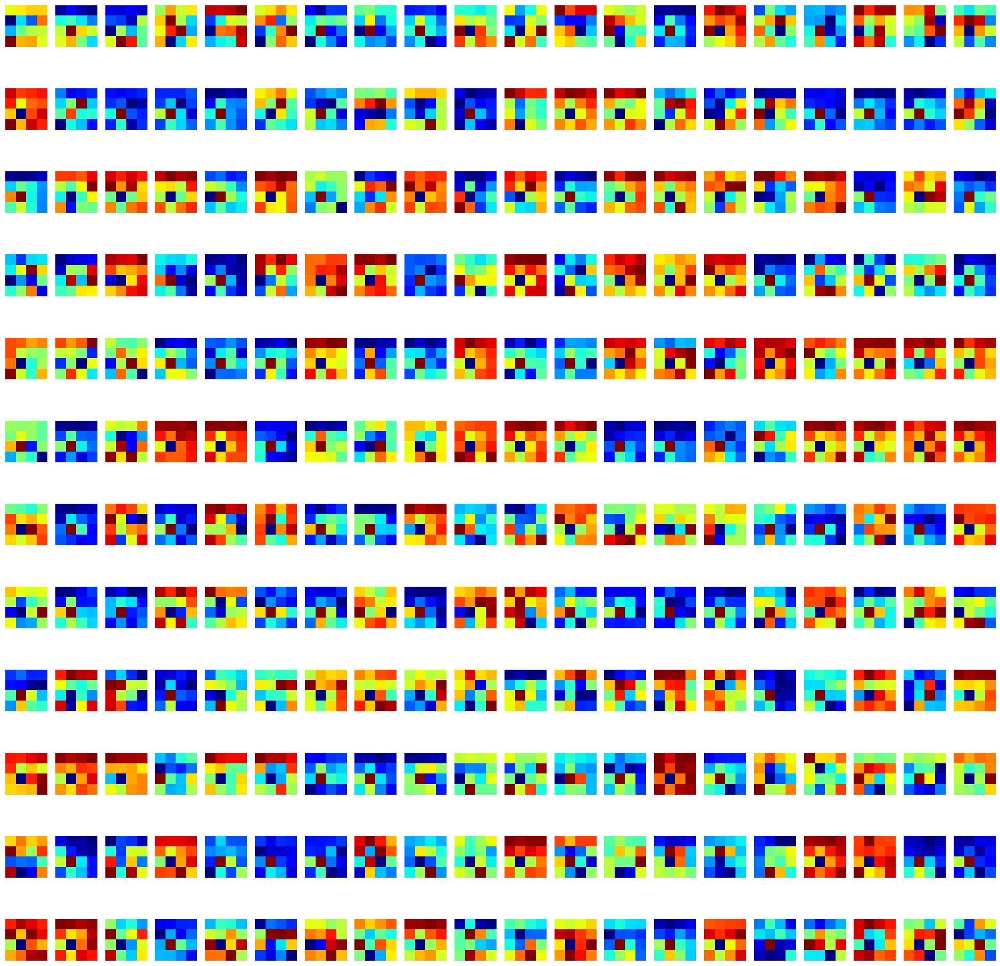

(1, 204, 256)
visual_feat
(1, 204, 256)
visual_feat
(1, 204, 256)
graph_convolution
(1, 204, 256)
evolved_feat
(1, 16, 204, 1)
Ws
(1, 16, 204, 1)
mapping_softmax
(1, 204, 256)
Wsp
(1, 16, 256)
applied_mapping
(1, 32, 32, 256)
conv2d_19


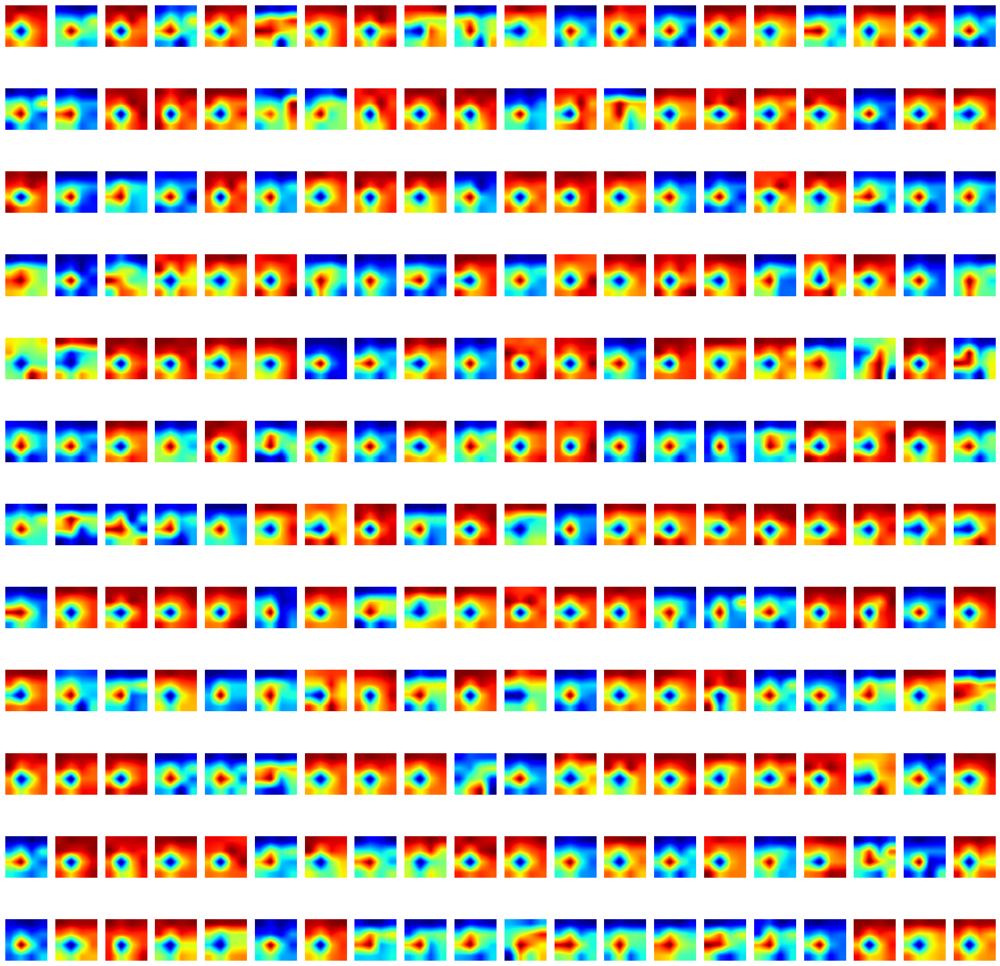

(1, 128, 128, 256)
conv2d_20


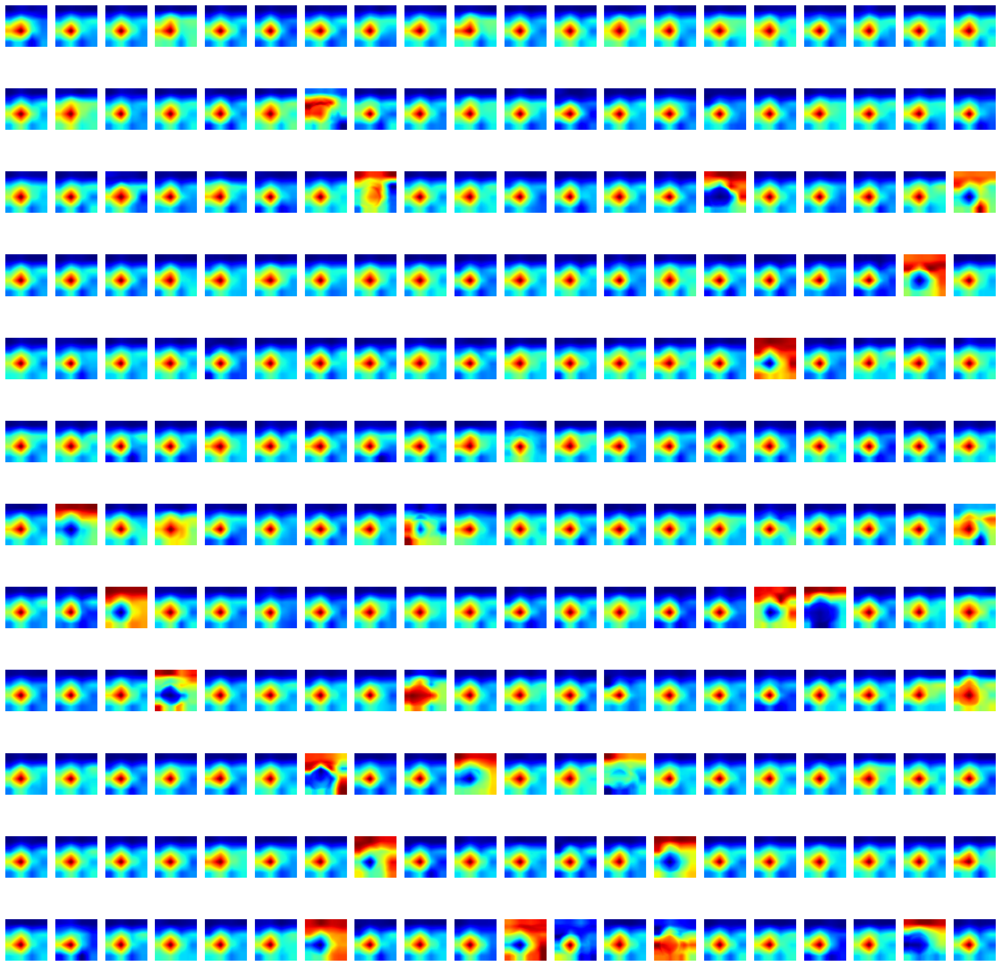

(1, 128, 128, 21)
conv2d_21


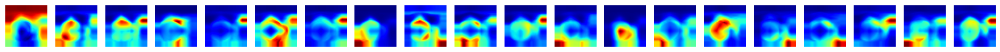

1/1 [==============================] - 0s 308ms/step
20
(1, 1, 1, 256)
conv2d_11


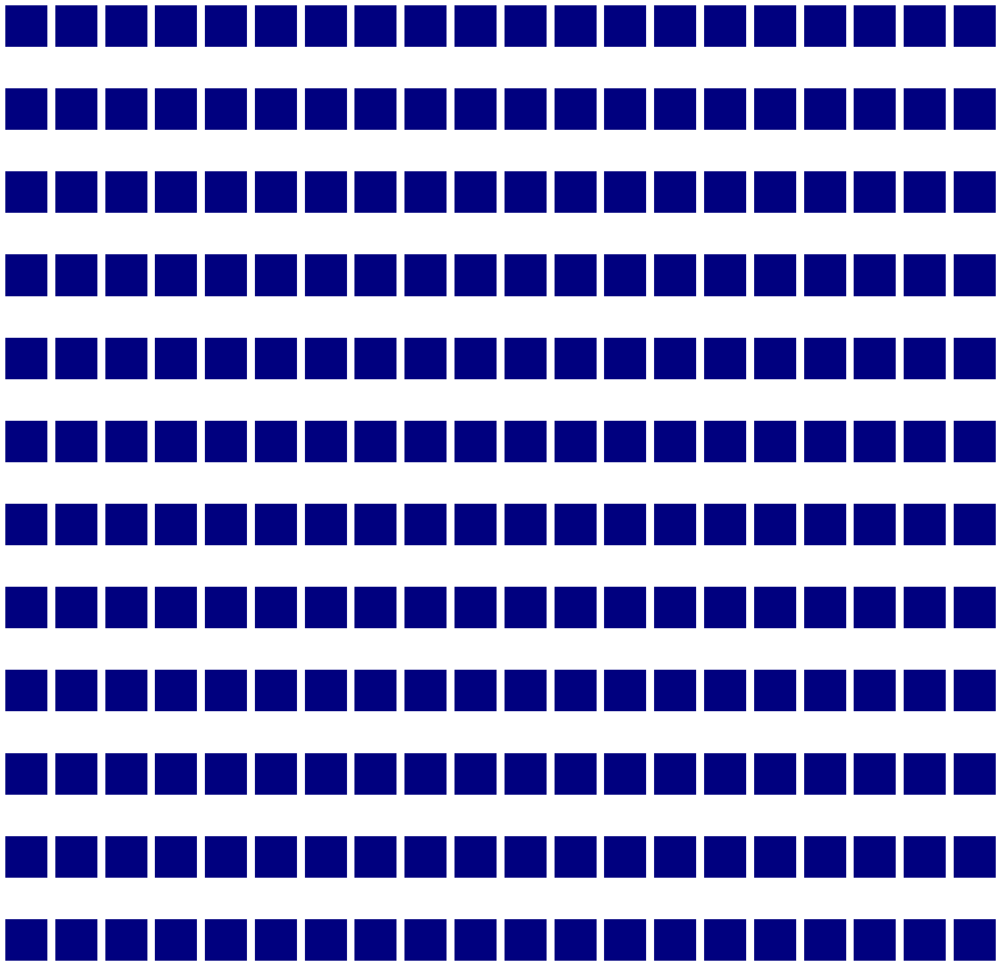

(1, 4, 4, 256)
conv2d_12


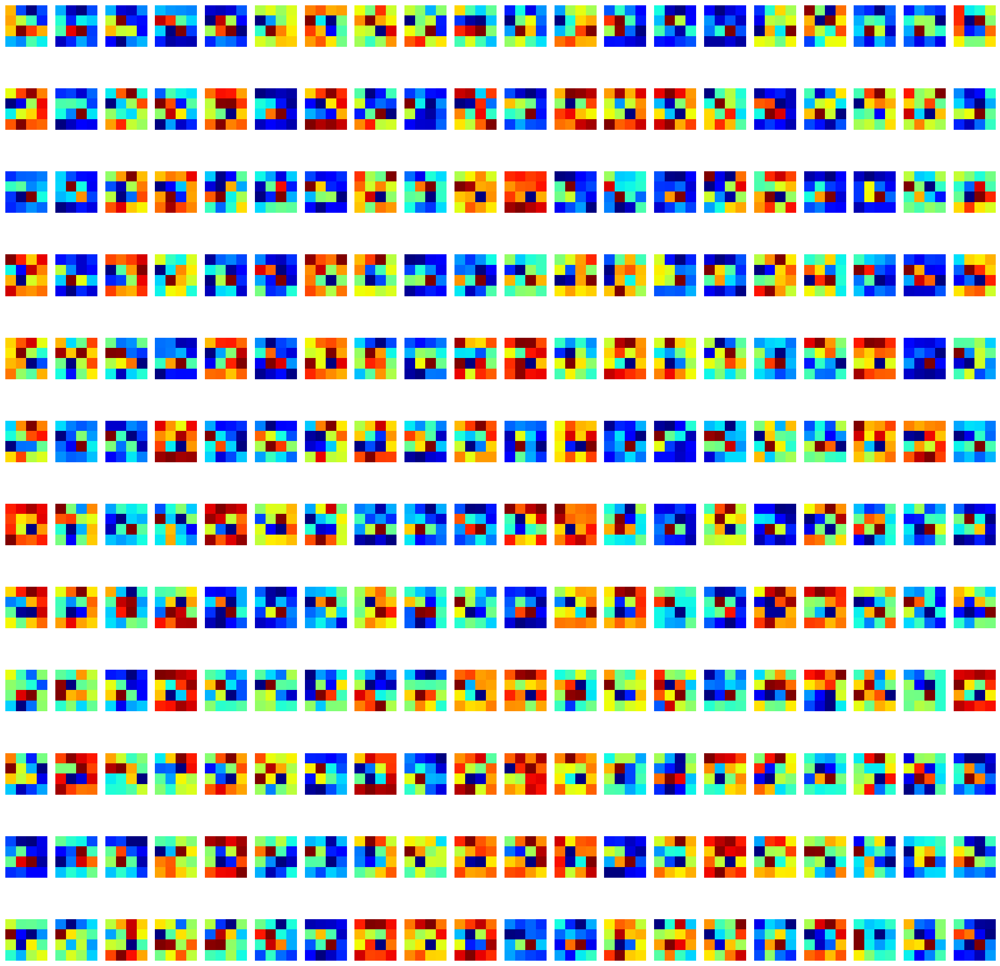

(1, 4, 4, 256)
conv2d_13


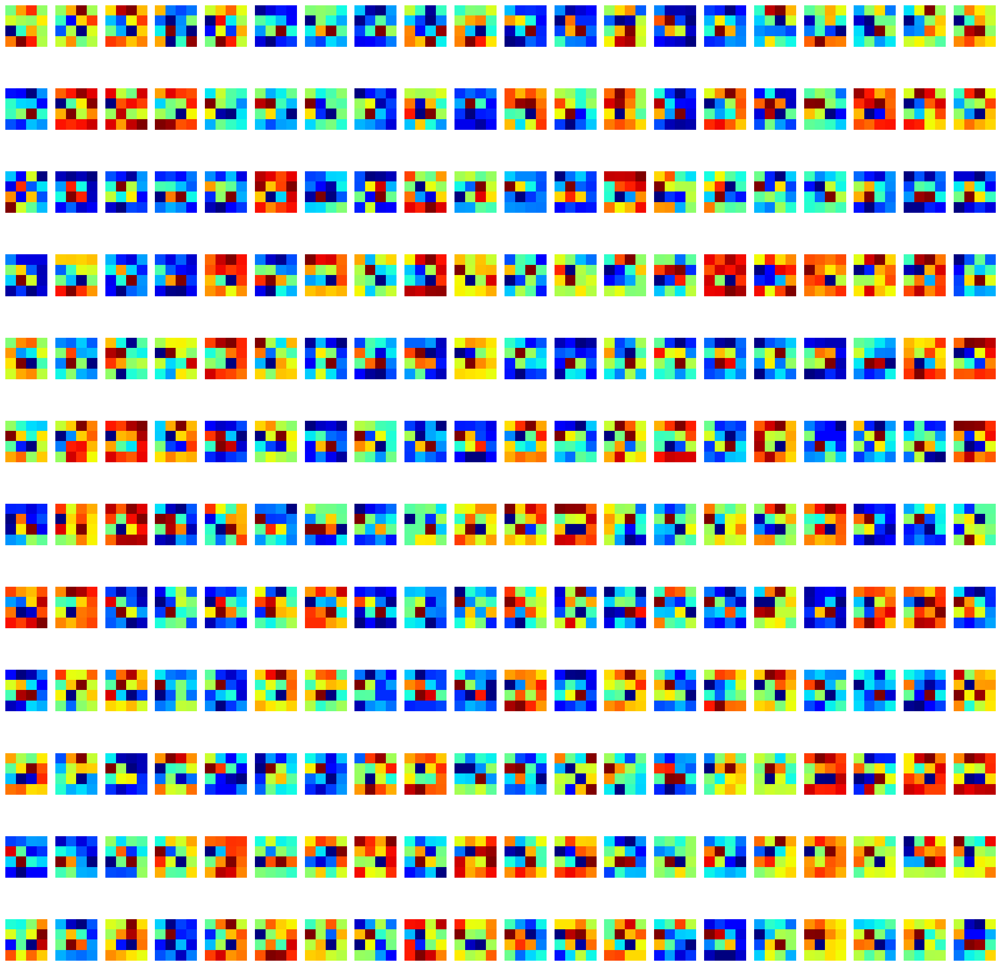

(1, 4, 4, 256)
conv2d_14


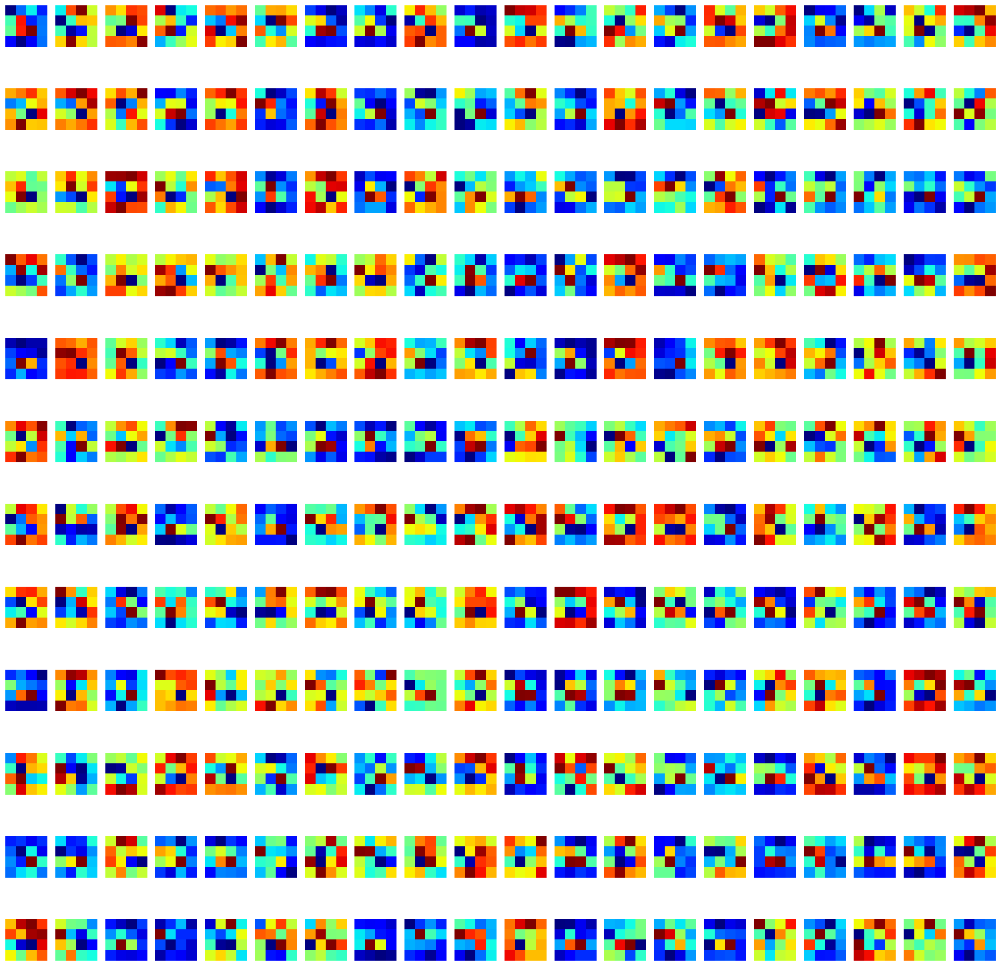

(1, 4, 4, 256)
conv2d_15


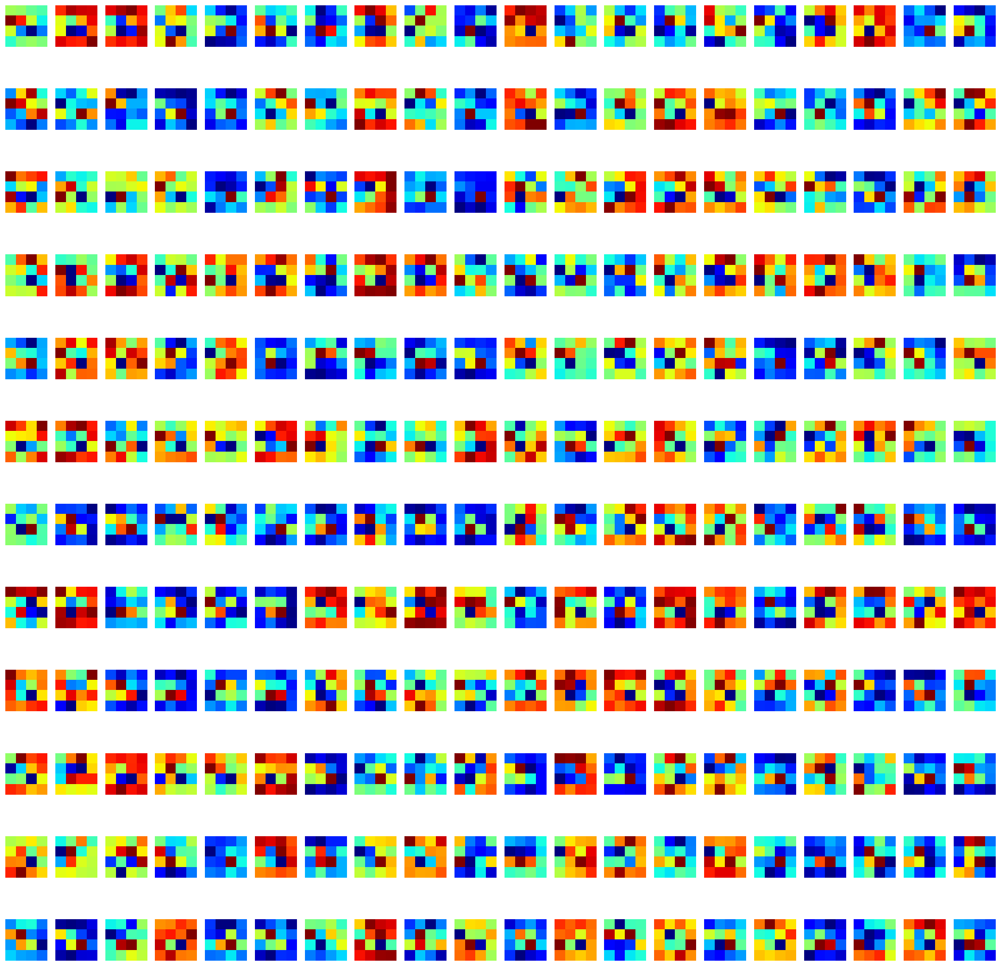

(1, 4, 4, 256)
conv2d_16


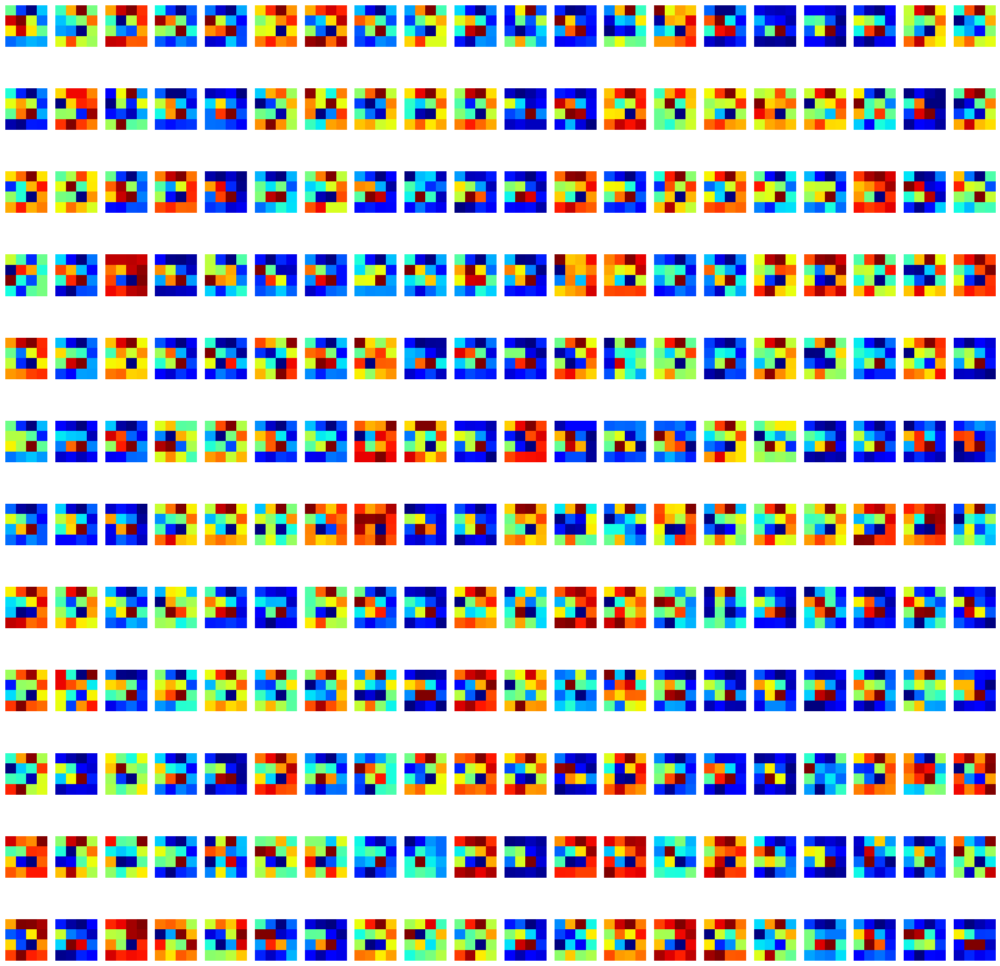

(1, 4, 4, 204)
voting_convolution


In [ ]:
for idx, x in enumerate(val_images):
    name = x.split("/")[-1].split(".")[0]
    image = cv2.imread(x, cv2.IMREAD_COLOR)
    image = cv2.resize(image, (IMAGE_SIZE, IMAGE_SIZE))
    image_x = image
    image = image/255.0
    image = np.expand_dims(image, axis=0)

    feature_maps = visualize_model.predict(image)
    print(len(feature_maps))
    for layer_name, feature_map in zip(final_names, feature_maps):
        print(feature_map.shape)
        print(layer_name)
        if len(feature_map.shape) == 3 or 'softmax' in layer_name or "mapping" in layer_name or 'Ws' in layer_name:
            histogram(layer_name, feature_map, idx)

        elif len(feature_map.shape) == 4:
            n_columns = 20
            n_rows = feature_map.shape[-1] // n_columns
            fig = plt.figure(figsize=(24, 24))
            fig = plt.title(layer_name)
            for i in range(1, n_columns * n_rows + 1):
                fig = plt.subplot(n_rows, n_columns, i)
                fig = plt.axis('off')
                plt.imshow(feature_map[0,:,:,i-1], cmap='jet')
            plt.show()

In [75]:
resnet_model = keras.models.load_model(r'C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\ResNet\model00000035.h5')

In [26]:
def grayscale_to_rgb(x_pred, classes, colormap):
    h,w, _ = x_pred.shape
    x_pred = x_pred.astype(np.int32)

    output=[]
    for i, pixel in enumerate(x_pred.flatten()):
        output.append(colormap[pixel])

    output = np.reshape(output, (h,w,3))
    return output

In [28]:
def save_image_pred(x_image, x_mask, prediction, path_save_image):
    h,w,_ = x_image.shape

    prediction = np.expand_dims(prediction, axis=-1)
    prediction = grayscale_to_rgb(prediction, classes, color_map)

    cat_images = np.concatenate([x_image, x_mask, prediction])
    cv2.imwrite(path_save_image, cat_images)

In [16]:
def jaccard(y_true, y_pred):
    """
    Arguments:
        y_true : Matrix containing one-hot encoded class labels
                 with the last axis being the number of classes.
        y_pred : Matrix with same dimensions as y_true.
        smooth : smoothing factor for loss function.
    """

    intersection = tf.reduce_sum( y_true * y_pred, axis=-1)
    union = tf.reduce_sum(y_true + y_pred, axis=-1) - intersection
    jac = intersection/ union

    return jac

In [17]:
def f1(y_true, y_pred):

    intersection = tf.reduce_sum(y_true * y_pred, axis=-1)
    denominator = tf.reduce_sum(y_true + y_pred, axis=-1)
    f1 = (2 * intersection) / denominator

    return f1

In [55]:
SCORE = []
for x, y in tqdm(zip(val_images, val_masks), total=500):
    name = x.split("/")[-1].split(".")[0]
    image = cv2.imread(x, cv2.IMREAD_COLOR)
    image = cv2.resize(image, (IMAGE_SIZE, IMAGE_SIZE))
    image_x = image
    image = image/255.0
    image = np.expand_dims(image, axis=0)

    mask = cv2.imread(y, cv2.IMREAD_COLOR)
    mask = cv2.resize(mask, (IMAGE_SIZE, IMAGE_SIZE))
    mask_x = mask
    onehot_mask = []
    for color in color_map:
        cmap = np.all(np.equal(mask, color), axis=-1)
        onehot_mask.append(cmap)
    onehot_mask = np.stack(onehot_mask, axis=-1)
    onehot_mask_x = onehot_mask
    onehot_mask = np.argmax(onehot_mask, axis=-1)
    onehot_mask = onehot_mask.astype(np.int32)

    pred = sgr_model.predict(image, verbose=0)[0]
    pred_x = pred
    pred = np.argmax(pred, axis=-1)
    pred = pred.astype(np.float32)

    results_dir = r'C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\result\sgr'
    save_path = os.path.join(results_dir,"{}.png".format(name))
    save_image_pred(image_x, mask_x, pred, save_path)

    jac_value = jaccard(onehot_mask_x, pred_x)
    f1_value = f1(onehot_mask_x,pred_x)
    SCORE.append([f1_value, jac_value])


  0%|          | 0/500 [00:00<?, ?it/s]

In [73]:
score = np.array(SCORE)
f = open("result/sgr/scores/score.csv", 'w')
f.write("Class, Jaccard\n")

l = ["Class", "F1", "Jaccard"]
print("{} {} {} ".format(l[0], l[1], l[2]))
print("-" * 40)
print(score.shape[0])
for i in range(len(classes)):
    class_name = classes[i]
    f1_value = score[i, 0].mean()
    jac_value = score[i, 1].mean()
    dstr = "{}: {}, {}".format(class_name, f1_value, jac_value)
    print(dstr)
    f.write("{}: {}, {}\n".format(class_name, f1_value, jac_value))

f.close()

Class F1 Jaccard 
----------------------------------------
584
background: 0.7442142367362976, 0.6607502698898315
boat: 0.6640830039978027, 0.6213724613189697
bicycle: 0.6340563893318176, 0.5364733934402466
bus: 0.4299755394458771, 0.3470621705055237
aeroplane: 0.7894182801246643, 0.7169793248176575
bottle: 0.6592724919319153, 0.6095951199531555
bird: 0.6037468910217285, 0.5507286787033081
car: 0.7725839614868164, 0.707030713558197
cat: 0.7695032358169556, 0.721674382686615
cow: 0.04684104397892952, 0.02840547449886799
horse: 0.7869227528572083, 0.757964015007019
motorbike: 0.330009400844574, 0.2391643226146698
person: 0.873081386089325, 0.8286139369010925
pottedplant: 0.5191124677658081, 0.44011613726615906
tv\monitor: 0.4714392423629761, 0.38336843252182007
sofa: 0.7392277717590332, 0.6855453848838806
sheep: 0.7454165816307068, 0.6782978773117065
train: 0.7911208868026733, 0.7339177131652832
chair: 0.7329403162002563, 0.6329114437103271
dog: 0.678375244140625, 0.5989385843276978
dini

In [79]:
f1 = []
jac = []
for i in range(len(classes)):
    f1.append(score[i, 0].mean())
    jac.append(score[i, 1].mean())

f1 = np.array(f1)
jac = np.array(jac)
print(f1.mean())
print(jac.mean())

0.6463108
0.57996976


In [78]:
SCORE = []
for x, y in tqdm(zip(val_images, val_masks), total=500):
    name = x.split("/")[-1].split(".")[0]
    image = cv2.imread(x, cv2.IMREAD_COLOR)
    image = cv2.resize(image, (IMAGE_SIZE, IMAGE_SIZE))
    image_x = image
    image = image/255.0
    image = np.expand_dims(image, axis=0)

    mask = cv2.imread(y, cv2.IMREAD_COLOR)
    mask = cv2.resize(mask, (IMAGE_SIZE, IMAGE_SIZE))
    mask_x = mask
    onehot_mask = []
    for color in color_map:
        cmap = np.all(np.equal(mask, color), axis=-1)
        onehot_mask.append(cmap)
    onehot_mask = np.stack(onehot_mask, axis=-1)
    onehot_mask_x = onehot_mask
    onehot_mask = np.argmax(onehot_mask, axis=-1)
    onehot_mask = onehot_mask.astype(np.int32)

    pred = resnet_model.predict(image, verbose=0)[0]
    pred_x = pred
    pred = np.argmax(pred, axis=-1)
    pred = pred.astype(np.float32)

    results_dir = r'C:\Users\SamuelMcmurray\Documents\SchoolStuff\JU\DeepLearning\Project\deeplearning_project\result\resnet'
    save_path = os.path.join(results_dir,"{}.png".format(name))
    save_image_pred(image_x, mask_x, pred, save_path)

    jac_value = jaccard(onehot_mask_x, pred_x)
    f1_value = f1(onehot_mask_x,pred_x)
    SCORE.append([f1_value, jac_value])

  0%|          | 0/500 [00:00<?, ?it/s]

In [82]:
score = np.array(SCORE)
f = open("result/resnet/scores/score.csv", 'w')
f.write("Class, Jaccard\n")

l = ["Class", "F1", "Jaccard"]
print("{} {} {} ".format(l[0], l[1], l[2]))
print("-" * 40)
print(score.shape[0])
for i in range(len(classes)):
    class_name = classes[i]
    f1_value = score[i, 0].mean()
    jac_value = score[i, 1].mean()
    dstr = "{}: {}, {}".format(class_name, f1_value, jac_value)
    print(dstr)
    f.write("{}: {}, {}\n".format(class_name, f1_value, jac_value))

f.close()

Class F1 Jaccard 
----------------------------------------
584
background: 0.6506061553955078, 0.5895506143569946
boat: 0.6233554482460022, 0.5714910626411438
bicycle: 0.5723190307617188, 0.5160994529724121
bus: 0.5757289528846741, 0.49076104164123535
aeroplane: 0.33643823862075806, 0.23794719576835632
bottle: 0.6118804216384888, 0.5645250082015991
bird: 0.5463456511497498, 0.51067715883255
car: 0.7883621454238892, 0.7514636516571045
cat: 0.6741129755973816, 0.5877344012260437
cow: 0.03866653889417648, 0.02372657135128975
horse: 0.7495485544204712, 0.6990070939064026
motorbike: 0.4145221412181854, 0.3314605951309204
person: 0.7447021007537842, 0.6903433799743652
pottedplant: 0.5445883274078369, 0.450971782207489
tv\monitor: 0.41314244270324707, 0.32808756828308105
sofa: 0.470017671585083, 0.3862755298614502
sheep: 0.7173957228660583, 0.6595889329910278
train: 0.634546160697937, 0.5707223415374756
chair: 0.6043599843978882, 0.5632966756820679
dog: 0.6325302124023438, 0.5813473463058472


In [83]:
f1 = []
jac = []
for i in range(len(classes)):
    f1.append(score[i, 0].mean())
    jac.append(score[i, 1].mean())

f1 = np.array(f1)
jac = np.array(jac)
print(f1.mean())
print(jac.mean())

0.5752618
0.512225
